# CMPINF - 2100 - Final Project - Main Report

## A. Introduction

### State whether you solved your project as a regression or classification problem.

This is a classification problem. I created another variable by splitting the `track_popularity` into 2 values, those being high and low. Anything lower than the median value of 45 was given the low tag which is `0`. Anything higher than the median value of 45 was given the high tag which is `1`.

### Describe the major findings you have identified based on your analysis.

In this project, we explored the tidy tuesday spotify dataset, which is a dataset that has songs from spotify from the year 2020, with different variables such as danceability and energy of the song. The goal was to determine if the output variables `track_poularity`, which we created as a binary classfication mentioned above, was related to any of the input variables through exploratory data analysis, multiple forms of clustering, and data modelling. 

From exploring dataset, it was found that the EDM playlist genre was wildy unpopular compared to the other genres. Additionlly, there were some variables that had more influence on the model than others such as `playlist_genre` as a standalone and interacting with others. `Acousticness` of a song appeared to be the most influential gaussian like variable (after transforming it) compared to the other continous variables.

### Which inputs/features seem to influence the response/outcome the most?

`playlist_genre`, and `acousticness` appear to influence the outcome the most as those 2 values were consitently near the top of there respective models.

### What supported your conclusion? Was it only through predictive models?

The predictive models supported the conclustion mostly as clustering results were very spread out compared to the data. However, the EDA portion also showed `playlist_genre` having a large impact on a songs popularity.

### Could EDA help identify similar trends/relationships?

The EDA helped identify some trends and relationships between the model such as some playlist_genres being less popular than others. 

### Was clustering consistent with any conclusions from the predictive models?

No it was not.

### What skills did you learn from going through this project?

Many skills were learned from the project such as modelling using a real life dataset, predicting on that dataset and cross validating those models. Additionally, I learned through this project that Real life data is very messy and sometimes the desired outcome will not be achieved however we can still find inferences from our results. 

### This is not related to application or project inputs/outputs directly. What general skills can you take away from the project to apply to applications more specific to your area of interest?

I can take the modelling and predicting aspect away to determine what a player is likely to average for the next basketball season or the playoffs as this is what I am most interested in.

### Import Modules

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from scipy.cluster import hierarchy 
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

import statsmodels.formula.api as smf

from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

from sklearn.model_selection import StratifiedKFold

### Read data

Load data into notebook

In [2]:
songs_url = 'https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2020/2020-01-21/spotify_songs.csv'

In [3]:
df = pd.read_csv( songs_url )

## B. Exploratory Data Analysis

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  32833 non-null  object 
 1   track_name                32828 non-null  object 
 2   track_artist              32828 non-null  object 
 3   track_popularity          32833 non-null  int64  
 4   track_album_id            32833 non-null  object 
 5   track_album_name          32828 non-null  object 
 6   track_album_release_date  32833 non-null  object 
 7   playlist_name             32833 non-null  object 
 8   playlist_id               32833 non-null  object 
 9   playlist_genre            32833 non-null  object 
 10  playlist_subgenre         32833 non-null  object 
 11  danceability              32833 non-null  float64
 12  energy                    32833 non-null  float64
 13  key                       32833 non-null  int64  
 14  loudne

In [5]:
df.head()

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,2oCs0DGTsRO98Gh5ZSl2Cx,I Don't Care (with Justin Bieber) [Loud Luxury...,2019-06-14,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,63rPSO264uRjW1X5E6cWv6,Memories (Dillon Francis Remix),2019-12-13,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,1HoSmj2eLcsrR0vE9gThr4,All the Time (Don Diablo Remix),2019-07-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616
3,75FpbthrwQmzHlBJLuGdC7,Call You Mine - Keanu Silva Remix,The Chainsmokers,60,1nqYsOef1yKKuGOVchbsk6,Call You Mine - The Remixes,2019-07-19,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,7,-3.778,1,0.1020,0.0287,0.000009,0.2040,0.277,121.956,169093
4,1e8PAfcKUYoKkxPhrHqw4x,Someone You Loved - Future Humans Remix,Lewis Capaldi,69,7m7vv9wlQ4i0LFuJiE2zsQ,Someone You Loved (Future Humans Remix),2019-03-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-4.672,1,0.0359,0.0803,0.000000,0.0833,0.725,123.976,189052


In [6]:
df.shape

(32833, 23)

In [7]:
df.dtypes

track_id                     object
track_name                   object
track_artist                 object
track_popularity              int64
track_album_id               object
track_album_name             object
track_album_release_date     object
playlist_name                object
playlist_id                  object
playlist_genre               object
playlist_subgenre            object
danceability                float64
energy                      float64
key                           int64
loudness                    float64
mode                          int64
speechiness                 float64
acousticness                float64
instrumentalness            float64
liveness                    float64
valence                     float64
tempo                       float64
duration_ms                   int64
dtype: object

In [8]:
df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

In [9]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

There appears to be 5 missing values in `track_name`, `track_artist`, and `track_album_name`. Let's check some of these rows.

In [10]:
df[df.isnull().any(axis=1)]

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
8151,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,HIP&HOP,5DyJsJZOpMJh34WvUrQzMV,rap,...,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707
9282,5cjecvX0CmC9gK0Laf5EMQ,NaN,NaN,0,3luHJEPw434tvNbme3SP8M,NaN,2017-12-01,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,...,11,-5.364,0,0.3190,0.0534,0.00000,0.5530,0.191,146.153,202235
9283,5TTzhRSWQS4Yu8xTgAuq6D,NaN,NaN,0,3luHJEPw434tvNbme3SP8M,NaN,2017-12-01,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,...,10,-5.907,0,0.3070,0.0963,0.00000,0.0888,0.505,86.839,206465
19568,3VKFip3OdAvv4OfNTgFWeQ,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,Reggaeton viejito🔥,0si5tw70PIgPkY1Eva6V8f,latin,...,11,-6.075,0,0.0366,0.0606,0.00653,0.1030,0.726,97.017,252773
19811,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,717UG2du6utFe7CdmpuUe3,NaN,2012-01-05,latin hip hop,3nH8aytdqNeRbcRCg3dw9q,latin,...,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707


In [11]:
df.groupby(['track_id', 'track_album_id', 'playlist_id']).size().reset_index(name='num_rows').\
num_rows.value_counts()

num_rows
1    31719
2      482
3       50
Name: count, dtype: int64

According to this, there are 31719 rows which only appears once or are unique. However, there are 482 rows that are exactly the same and appear twice. Even more, there are 50 rows that are exactly the same and appear 3 times!

### Marginal distributions
 
Let's group these rows together so that there are only unique rows. Additionally, let's create the `df_inputs` dataset for values we will use in our model from the grouped by rows.

NOTE : album release date column was not kept as datetime was not covered in this course and ran into issues of columns not being in yy-mm-dd format.

In [12]:
df_copy =  df.copy()

In [13]:
df_inputs = df_copy.groupby(['track_id'], dropna=False).\
aggregate(playlist_genre = ('playlist_genre', 'first'),
          danceability = ('danceability', 'mean'),
          energy = ('energy', 'mean'),
          key = ('key', 'first'),
          loudness = ('loudness', 'mean'),
          mode = ('mode', 'first'),
          speechiness = ('speechiness', 'mean'),
          acousticness = ('acousticness', 'mean'),
          instrumentalness =('instrumentalness', 'mean'),
          liveness= ('liveness', 'mean'),
          valence = ('valence', 'mean'),
          tempo = ('tempo', 'mean'),
          duration_ms = ('duration_ms', 'mean')).\
reset_index()


All the numeric data types (int64 and float64) were kept in the data along with other columns deemed to potentially affect the model such as `playlist_genre`, `track_album_name` and `track_album_release_date`. Other columns were not included in the new pandas dataframe as they are deemed to be identifiers rather than features that could affect the track popularity. Additionally `track_popularity` was taken out as this is going to be the expected output of the model.

In [14]:
df_num = df_inputs.select_dtypes(include=['number'])
df_categorical = df_inputs.select_dtypes(include=['object', 'category'])
df_num.head()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,0.682,0.401,2,-10.068,1,0.0236,0.279000,0.011700,0.0887,0.566,97.091,235440.0
1,0.582,0.704,5,-6.242,1,0.0347,0.065100,0.000000,0.2120,0.698,150.863,197286.0
2,0.303,0.880,9,-4.739,1,0.0442,0.011700,0.009940,0.3470,0.404,135.225,373512.0
3,0.659,0.794,10,-5.644,0,0.0540,0.000761,0.132000,0.3220,0.852,128.041,228565.0
4,0.662,0.838,1,-6.300,1,0.0499,0.114000,0.000697,0.0881,0.496,129.884,236308.0


Let's take a look at the marginal distributions for all the numerical data types. First lets transform the data from wide format to long format.

In [15]:
id_cols = ['rowid'] + df_categorical.columns.to_list()
id_cols

['rowid', 'track_id', 'playlist_genre']

In [16]:
songs_lf = df_inputs.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_num.columns) 

songs_lf

,rowid,track_id,playlist_genre,variable,value
0,0,0017A6SJgTbfQVU2EtsPNo,rock,danceability,0.682
1,1,002xjHwzEx66OWFV2IP9dk,r&b,danceability,0.582
2,2,004s3t0ONYlzxII9PLgU6z,rock,danceability,0.303
3,3,008MceT31RotUANsKuzy3L,pop,danceability,0.659
4,4,008rk8F6ZxspZT4bUlkIQG,pop,danceability,0.662
...,...,...,...,...,...
340267,28351,7zxRMhXxJMQCeDDg0rKAVo,r&b,duration_ms,179773.000
340268,28352,7zyLObYw4QUKQDyZOb4J0Y,r&b,duration_ms,223890.000
340269,28353,7zycSpvjDcqh6YT1FEl2kY,pop,duration_ms,260240.000
340270,28354,7zye9v6B785eFWEFYs13C2,r&b,duration_ms,191205.000


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


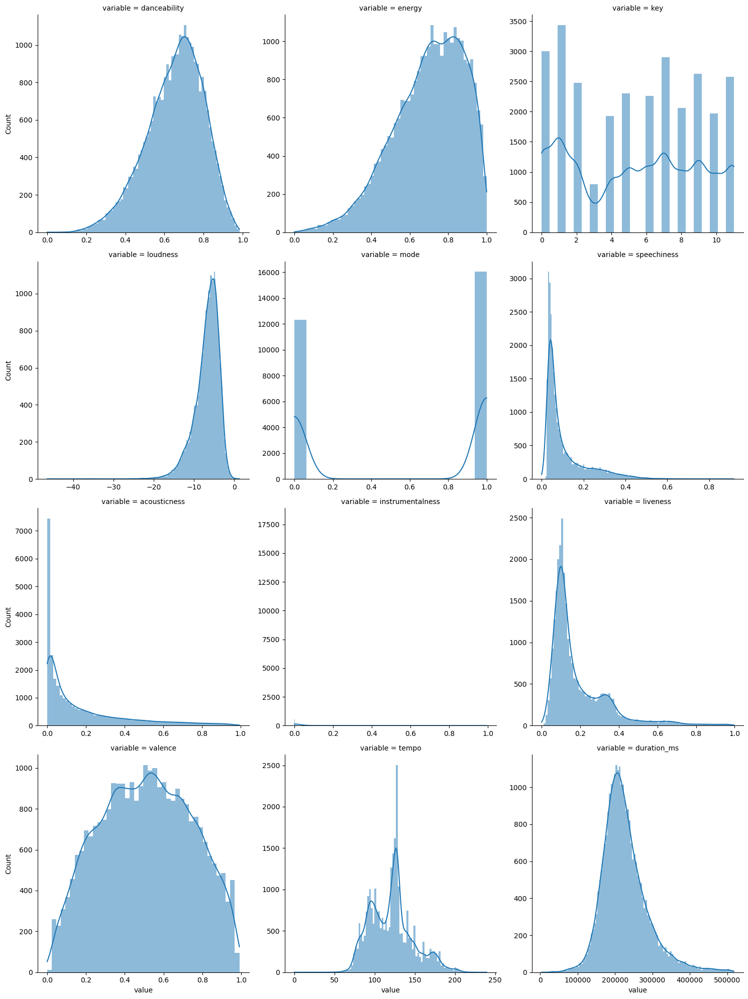

In [17]:
sns.displot(data = songs_lf, kind='hist', x='value', col='variable', kde = True,
            facet_kws= {'sharex': False, 'sharey': False}, col_wrap=3,
            common_bins= False)

plt.show()

From the distribution plots, we can see that `mode` and `key` are categorical variables. Additionally, we can see some inputs with a normal distribution, some skewed to the left and some skewed to the right. Lets change these to categoricals and change the data to long format to account for the variable category change.


In [18]:
df_copy['mode'] = df_copy['mode'].astype('category')
df_copy['key'] = df_copy['key'].astype('category')

df_inputs['mode'] = df_inputs['mode'].astype('category')
df_inputs['key'] = df_inputs['key'].astype('category')

In [19]:
df_num = df_inputs.select_dtypes(include=['number'])
df_categorical = df_inputs.select_dtypes(include=['object', 'category'])

In [20]:
id_cols = ['rowid'] + df_categorical.columns.to_list()
id_cols

['rowid', 'track_id', 'playlist_genre', 'key', 'mode']

In [21]:
songs_lf = df_inputs.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_num.columns) 

songs_lf

,rowid,track_id,playlist_genre,key,mode,variable,value
0,0,0017A6SJgTbfQVU2EtsPNo,rock,2,1,danceability,0.682
1,1,002xjHwzEx66OWFV2IP9dk,r&b,5,1,danceability,0.582
2,2,004s3t0ONYlzxII9PLgU6z,rock,9,1,danceability,0.303
3,3,008MceT31RotUANsKuzy3L,pop,10,0,danceability,0.659
4,4,008rk8F6ZxspZT4bUlkIQG,pop,1,1,danceability,0.662
...,...,...,...,...,...,...,...
283555,28351,7zxRMhXxJMQCeDDg0rKAVo,r&b,0,1,duration_ms,179773.000
283556,28352,7zyLObYw4QUKQDyZOb4J0Y,r&b,1,0,duration_ms,223890.000
283557,28353,7zycSpvjDcqh6YT1FEl2kY,pop,2,1,duration_ms,260240.000
283558,28354,7zye9v6B785eFWEFYs13C2,r&b,5,0,duration_ms,191205.000


Now lets check the marginal distribution of the output variable before the conversion to a binary classification.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


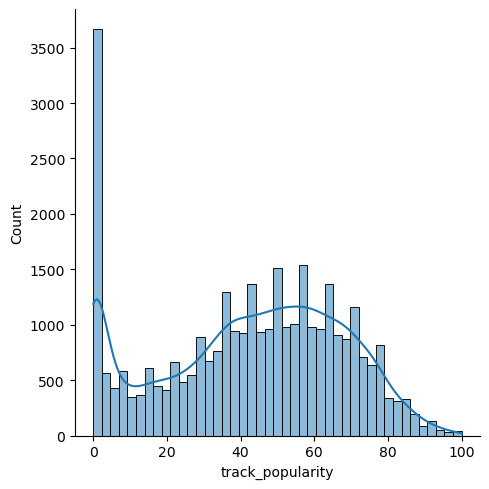

In [22]:
sns.displot(data = df_copy, x='track_popularity', kind='hist', kde=True)

plt.show()

The `track_popularity` output variable is skewed to the left a little bit due to a large number of songs being rated 0.

In this project, a clasiffication model will be performed where if a song popularity is above the median, that will be considered highly popular (or `1` for simplicity) and if a song popularity is below the threshold it will be considered not so popular (or `0` for simplicity). 

Let's create this threshold.

In [23]:
df.track_popularity.median()

45.0

Median song value is 45 so we will split here.

In [24]:
popularity_threshold = df.track_popularity.median()
df_copy['popularity_label'] = np.where(df_copy['track_popularity'] >= popularity_threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


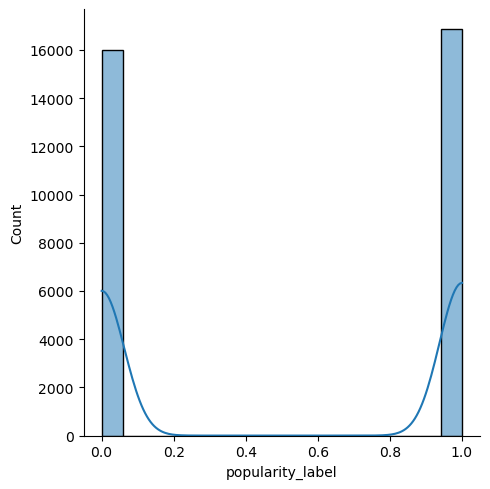

In [25]:
sns.displot(data = df_copy, x='popularity_label', kind='hist', kde=True)

plt.show()

In [26]:
df_copy.info()
df_copy.nunique()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 24 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   track_id                  32833 non-null  object  
 1   track_name                32828 non-null  object  
 2   track_artist              32828 non-null  object  
 3   track_popularity          32833 non-null  int64   
 4   track_album_id            32833 non-null  object  
 5   track_album_name          32828 non-null  object  
 6   track_album_release_date  32833 non-null  object  
 7   playlist_name             32833 non-null  object  
 8   playlist_id               32833 non-null  object  
 9   playlist_genre            32833 non-null  object  
 10  playlist_subgenre         32833 non-null  object  
 11  danceability              32833 non-null  float64 
 12  energy                    32833 non-null  float64 
 13  key                       32833 non-null  cate

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
popularity_label                2
dtype: int64

### Categorical-Categorical Relationships

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


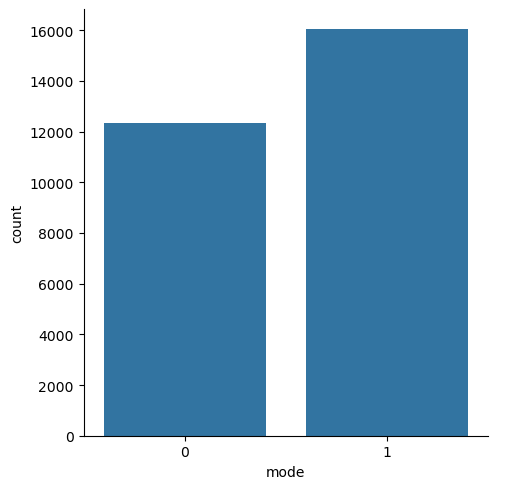

In [27]:
sns.catplot(data= df_inputs, x='mode', kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


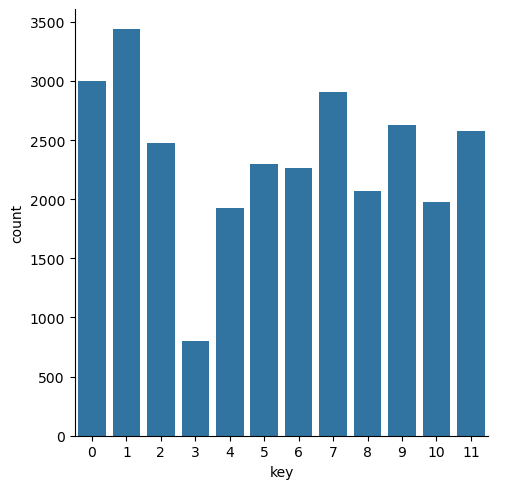

In [28]:
sns.catplot(data= df_inputs, x='key', kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


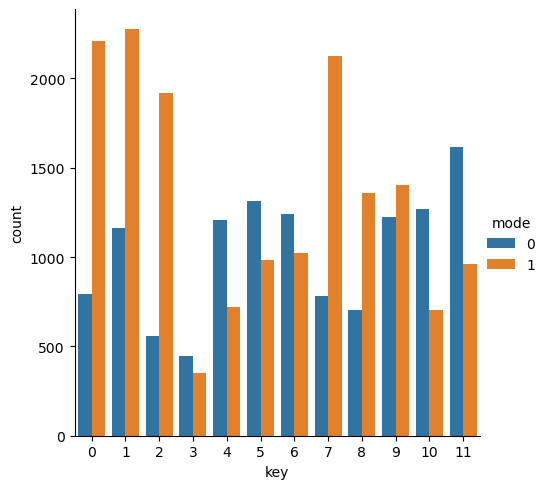

In [29]:
sns.catplot(data= df_inputs, x='key', kind='count', hue='mode')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


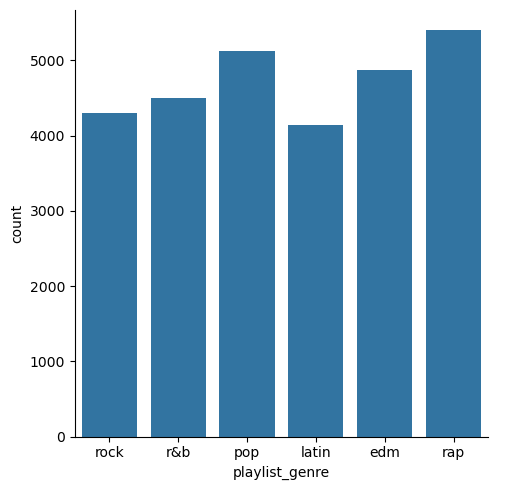

In [30]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


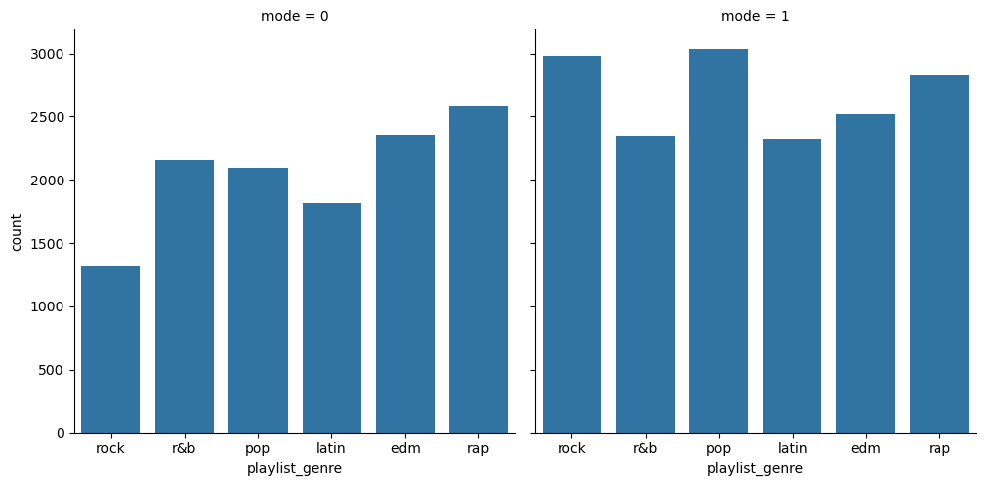

In [31]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', col='mode')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


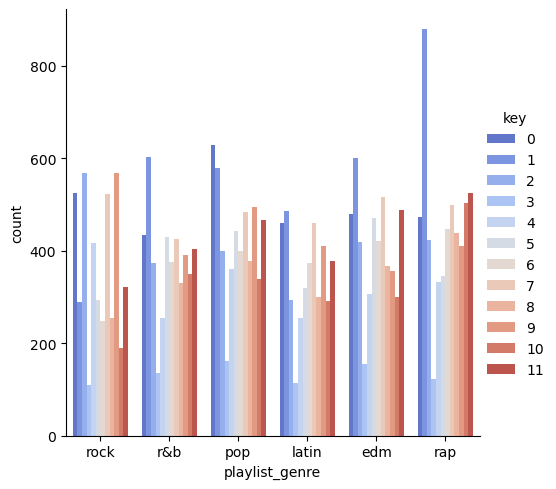

In [32]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', hue='key',palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


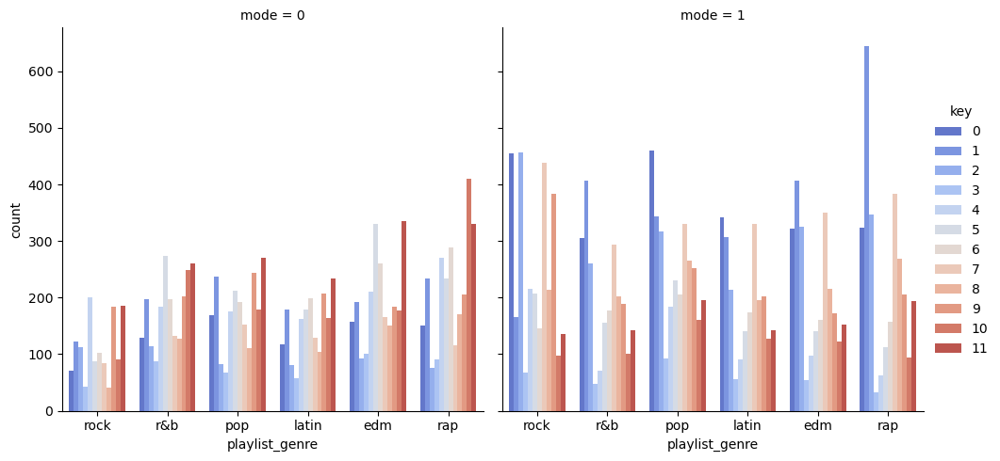

In [33]:
sns.catplot(data= df_inputs, x='playlist_genre', kind='count', hue='key', col='mode',palette='coolwarm')

plt.show()

There appears to be more tracks in higher key's when the mode is 0 and vice-versa. Now lets group them with the outcome.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


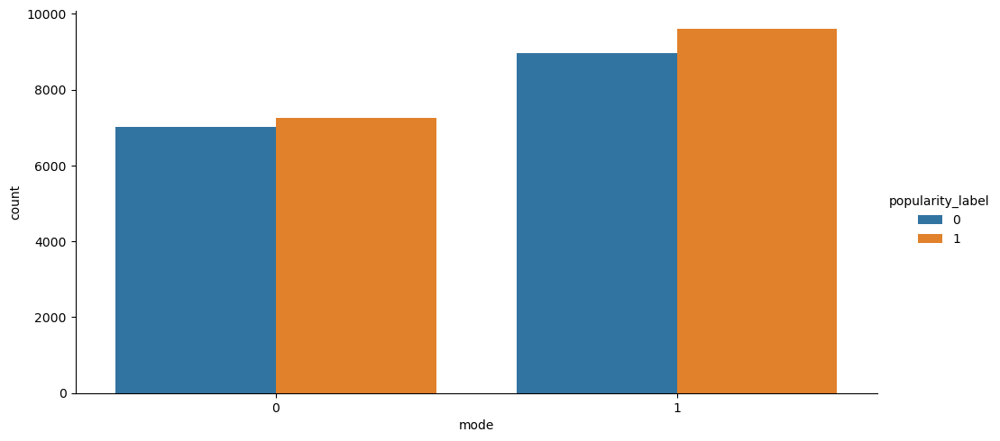

In [34]:
sns.catplot(data = df_copy, x='mode', hue='popularity_label', kind='count', aspect = 2)

plt.show()

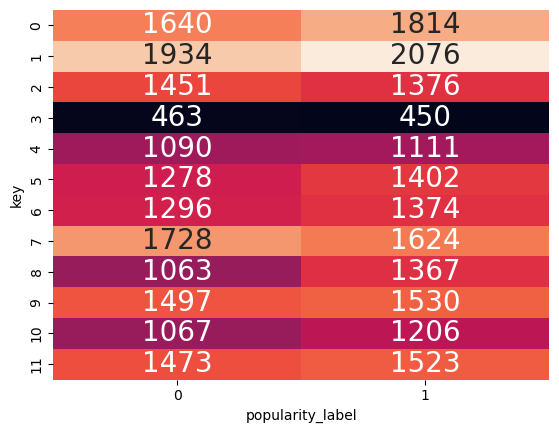

In [35]:
fig, ax = plt.subplots()

sns.heatmap( pd.crosstab( df_copy.key, df_copy.popularity_label), ax = ax,
             annot=True, annot_kws={'size': 20}, fmt='d',
             cbar=False)

plt.show()

The split appears pretty even across the mode for popularity value. There are less values in general for `key = 3` and `mode = 0`. Additionally `mode = 0` has more values related to a higher key and vice-versa.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


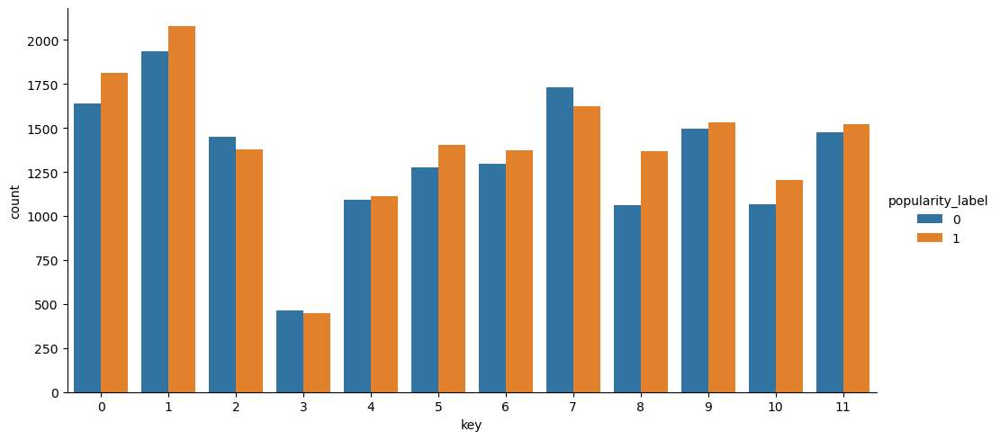

In [36]:
sns.catplot(data = df_copy, x='key', hue='popularity_label', kind='count', aspect = 2)

plt.show()

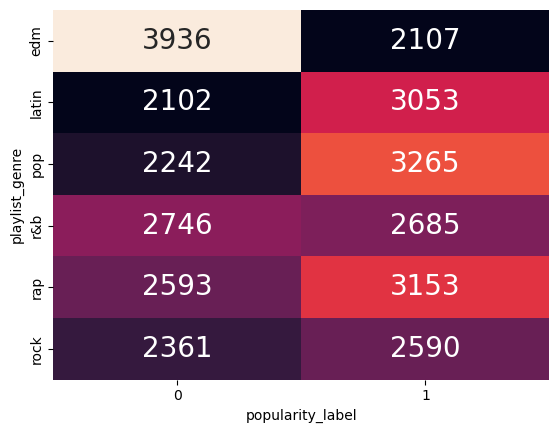

In [37]:
fig, ax = plt.subplots()

sns.heatmap( pd.crosstab( df_copy.playlist_genre, df_copy.popularity_label), ax = ax,
             annot=True, annot_kws={'size': 20}, fmt='d',
             cbar=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


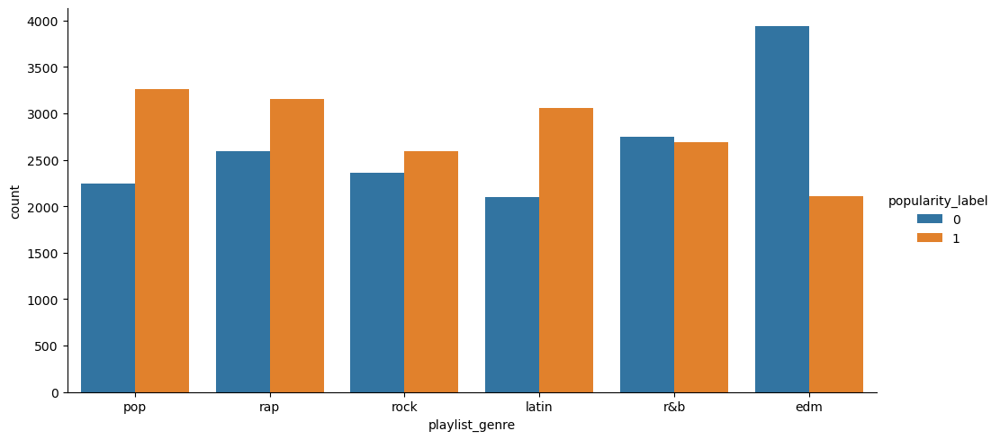

In [38]:
sns.catplot(data = df_copy, x='playlist_genre', hue='popularity_label', kind='count', aspect = 2)

plt.show()

EDM appears to be very unpopular while latin songs seem to have more favourble popularity within its category.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


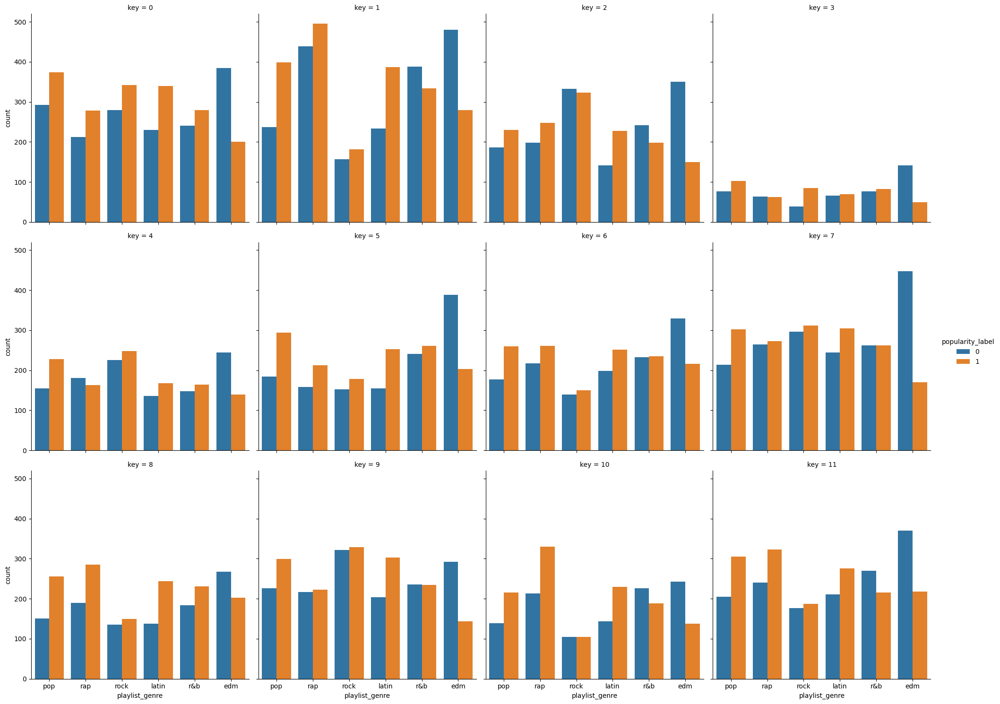

In [39]:
sns.catplot(data = df_copy, x='playlist_genre', hue='popularity_label', col='key', kind='count', col_wrap = 4)

plt.show()

There are some key's within the playlist genre that have a low popularity rating than others. For example, rock in key 9 has more lower popular songs than highers vs rock in key 3. Overall, there is a similar trens across the keys for each playlist genre.

Now let's group the numerical inputs and the categorical inputs together. This is done for conversion from wide format to long format and for KMeans clustering that will be performed later 

### Categorical-to-continous relationships

Let's see some of the relationships between categorical and continous values. First lets see the `energy` and the other categoricals.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


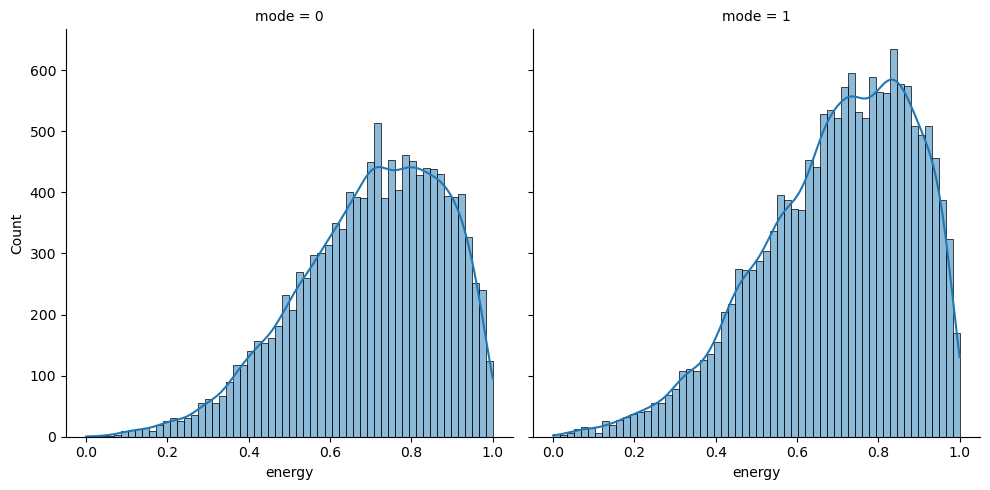

In [40]:
sns.displot(data = df_inputs, x='energy', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


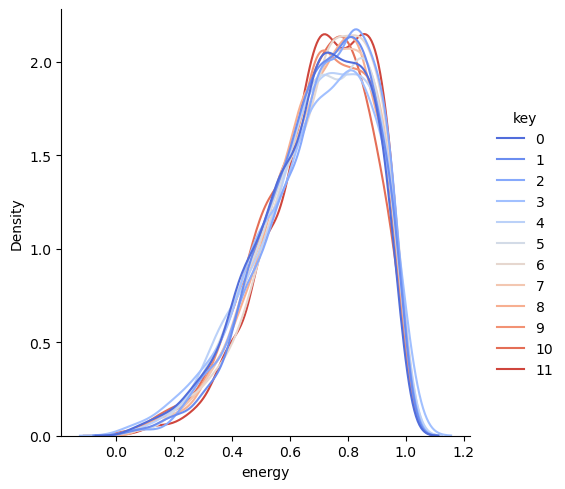

In [41]:
sns.displot(data = df_inputs, x='energy', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/3077715761.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.displot(data = df_inputs, x='energy', col='key', col_wrap=4,
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


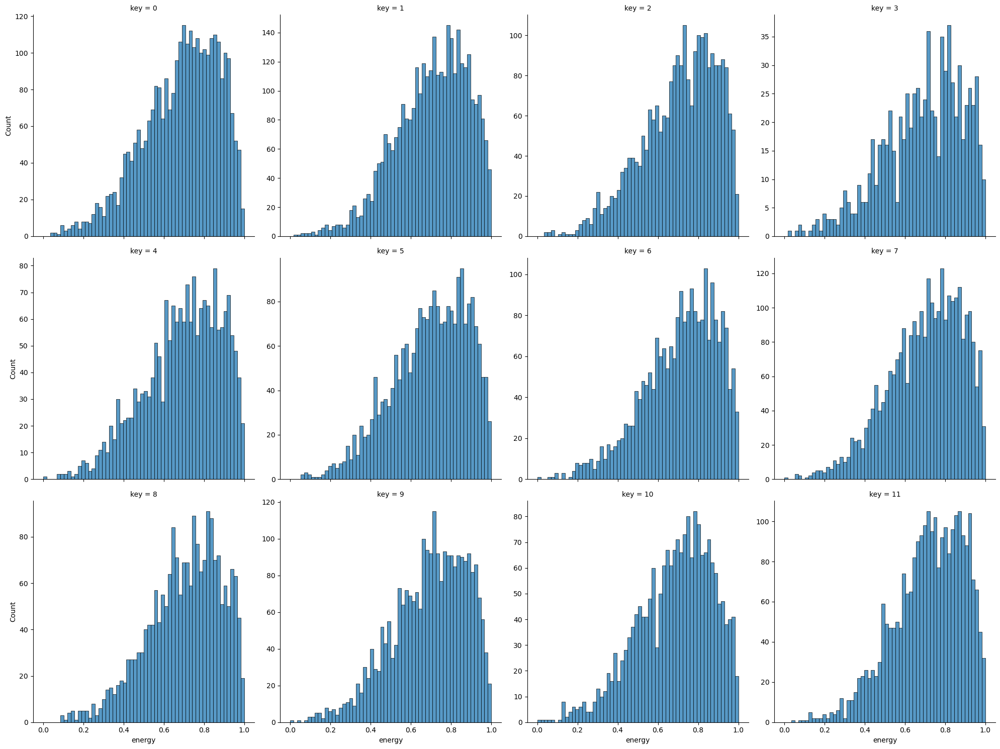

In [42]:
sns.displot(data = df_inputs, x='energy', col='key', col_wrap=4,
            kind='hist',
            facet_kws={'sharex': True, 'sharey': False},
            common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


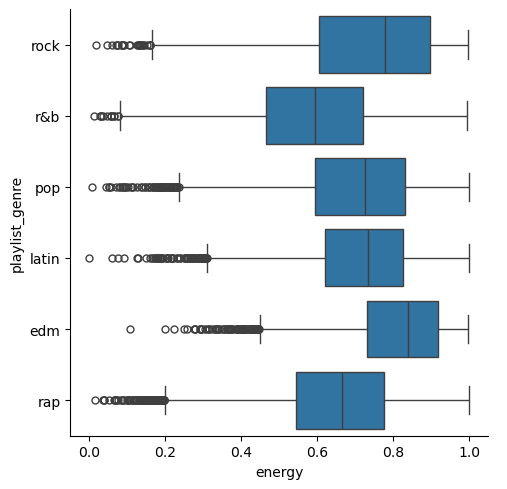

In [43]:
sns.catplot(data = df_inputs, x='energy', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

Based on the boxplotm EDM has the highest average energy. Lets explore `danceability` next.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


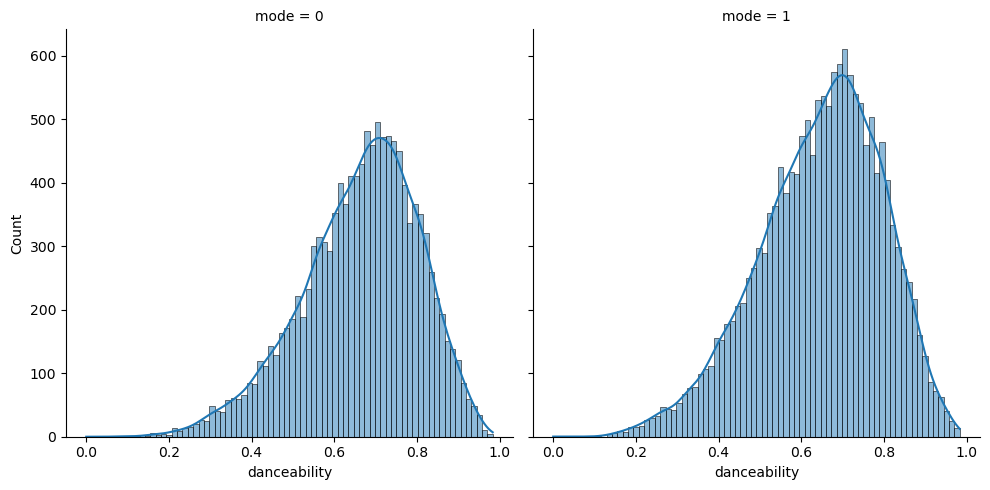

In [44]:
sns.displot(data = df_inputs, x='danceability', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


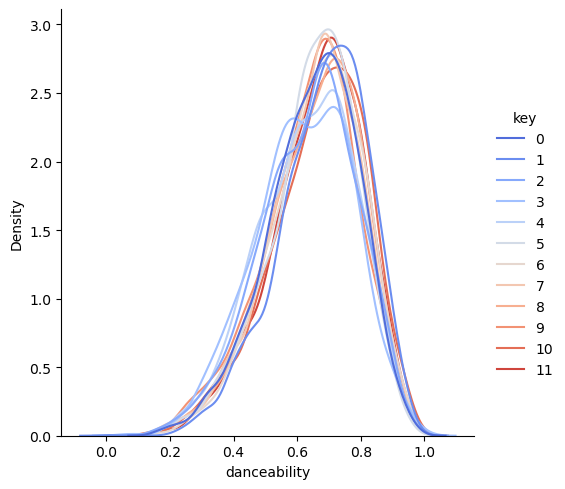

In [45]:
sns.displot(data = df_inputs, x='danceability', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


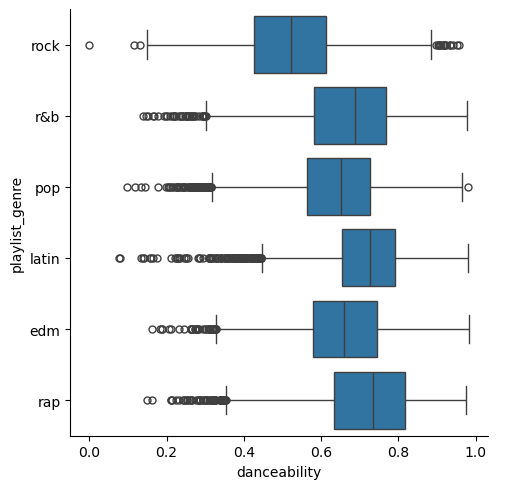

In [46]:
sns.catplot(data = df_inputs, x='danceability', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

Based on the boxplot, rap has the highest average danceability followed by latin. This was suprising as rap is not known to be the most danceable genre. Lets explore the `liveness`.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


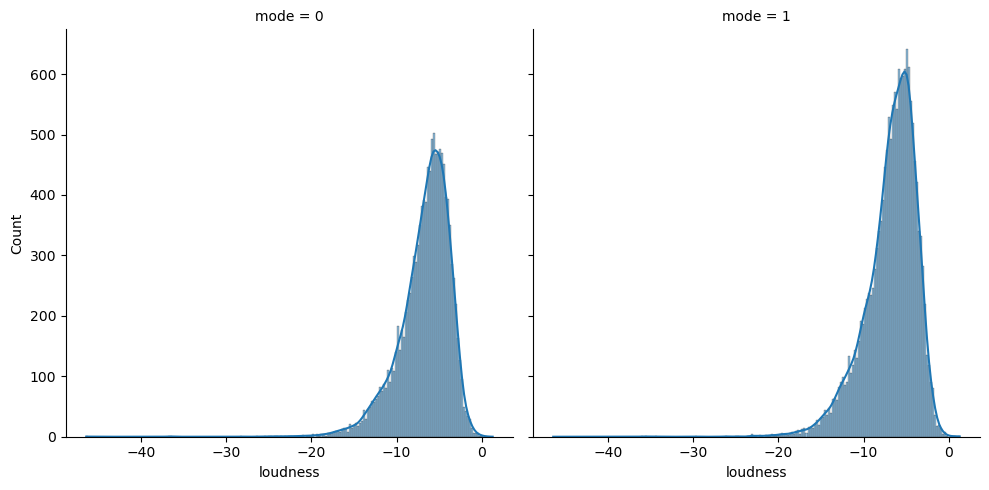

In [47]:
sns.displot(data = df_inputs, x='loudness', col='mode', kind='hist', kde=True)

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/258573688.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.displot(data = df_inputs, x='loudness', col='key', col_wrap=4,
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


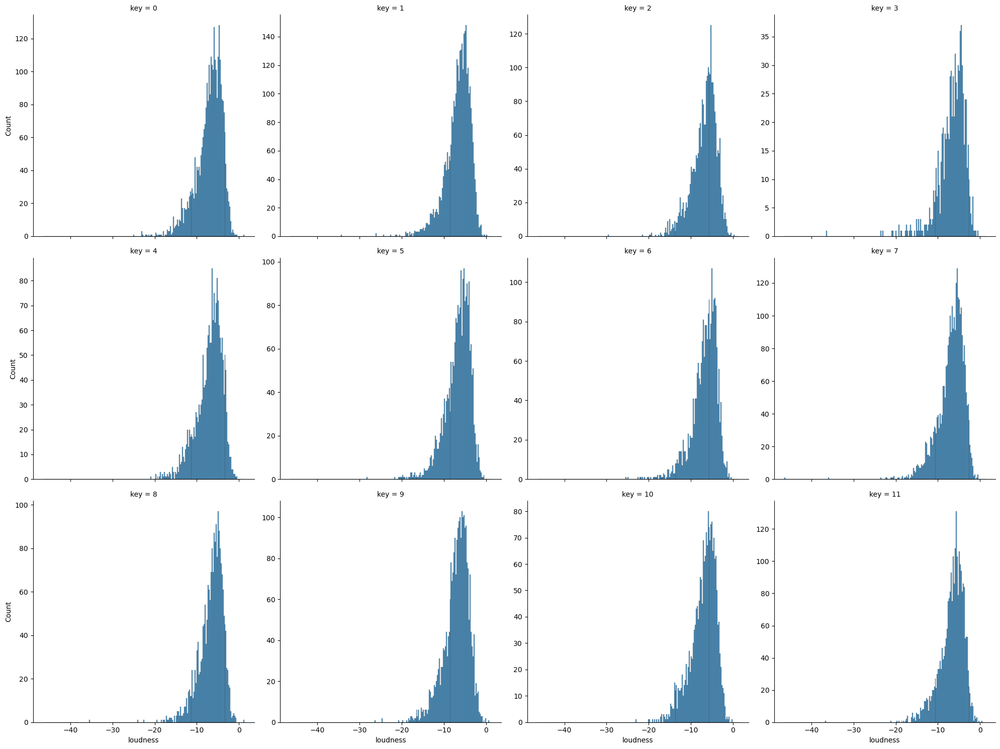

In [48]:
sns.displot(data = df_inputs, x='loudness', col='key', col_wrap=4,
            kind='hist',
            facet_kws={'sharex': True, 'sharey': False},
            common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


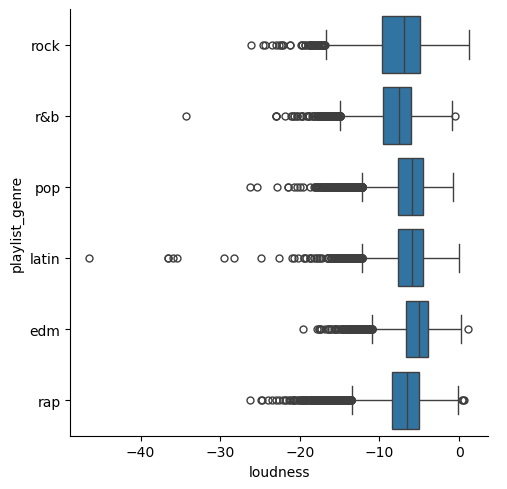

In [49]:
sns.catplot(data = df_inputs, x='loudness', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

`loudness` has a similar distribution across the categoricals.

Now let's see if theres any relationship when we use a combination of categoricals and continuous variables.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


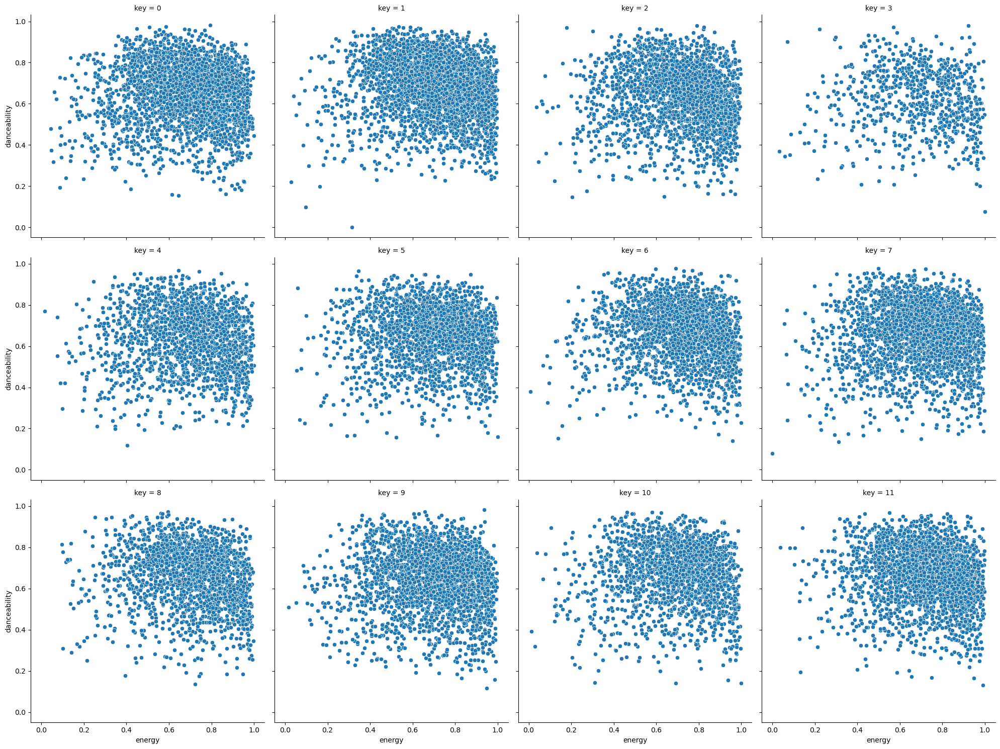

In [50]:
sns.relplot(data = df_inputs, x='energy', y='danceability', col = 'key', col_wrap = 4)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


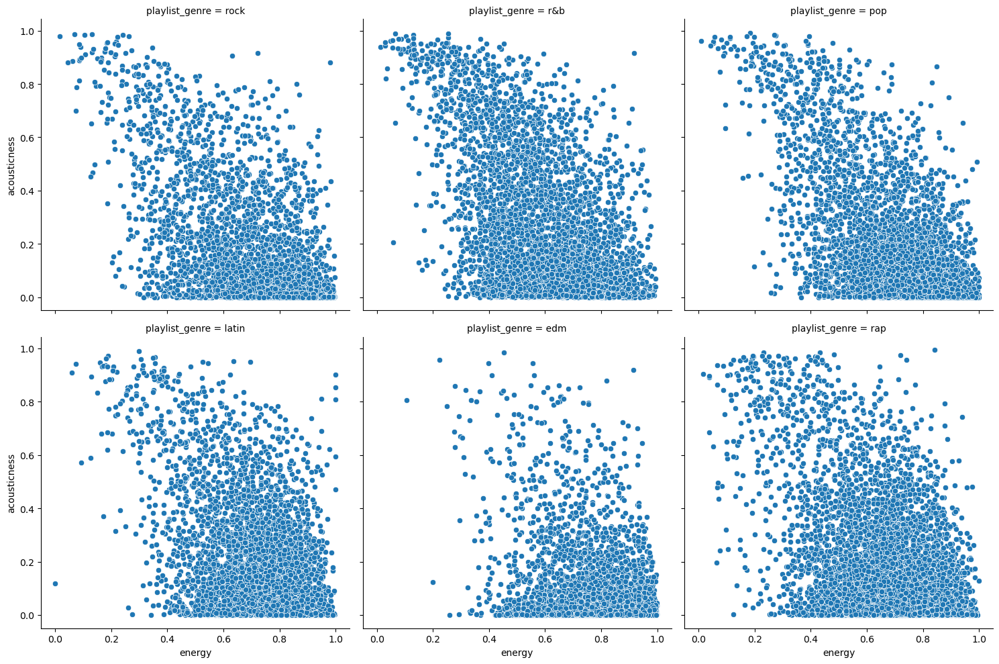

In [51]:
sns.relplot(data = df_inputs, x='energy', y='acousticness', col = 'playlist_genre', col_wrap = 3)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


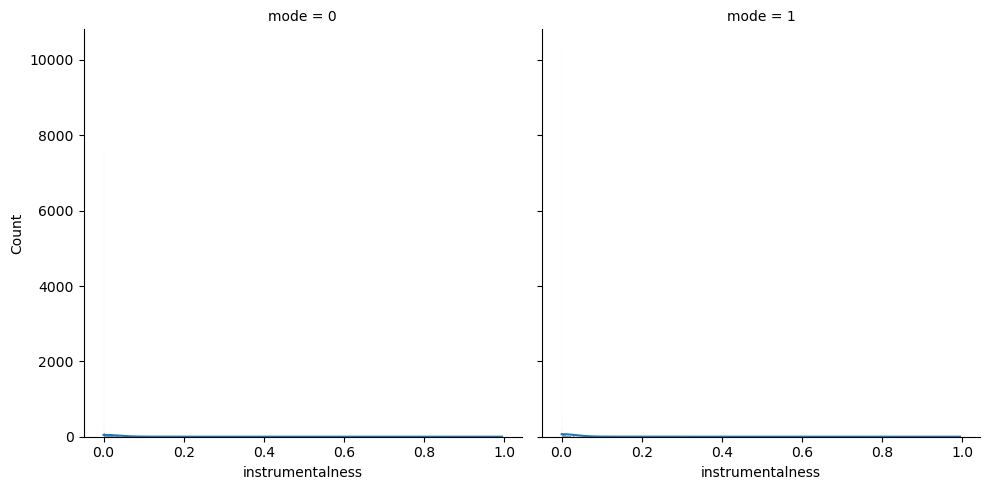

In [52]:
sns.displot(data = df_inputs, x='instrumentalness', col='mode', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


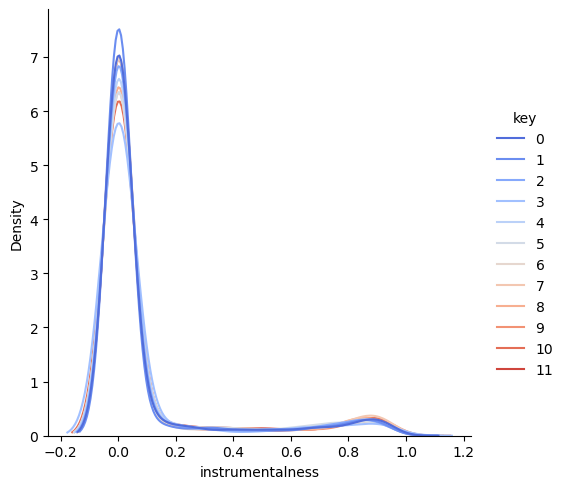

In [53]:
sns.displot(data = df_inputs, x='instrumentalness', hue='key', kind='kde', common_norm=False, palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


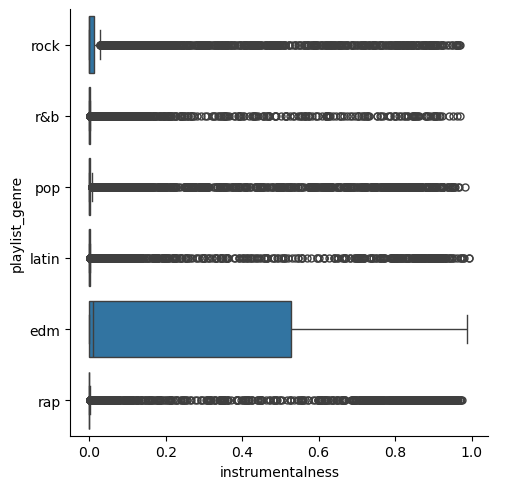

In [54]:
sns.catplot(data = df_inputs, x='instrumentalness', y='playlist_genre', 
            kind='box',
            meanprops={'marker': 'o', 'markerfacecolor': 'white', 'markeredgecolor': 'black'})

plt.show()

EDM has the widest range for instrumentalness. Most of the data seems to be scattered around although there may be a small upward trend with `energy` and `loudness`.

Let's visualize the continous-continous relationships using the `pairplot`.

### Continous-Continous relationships.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


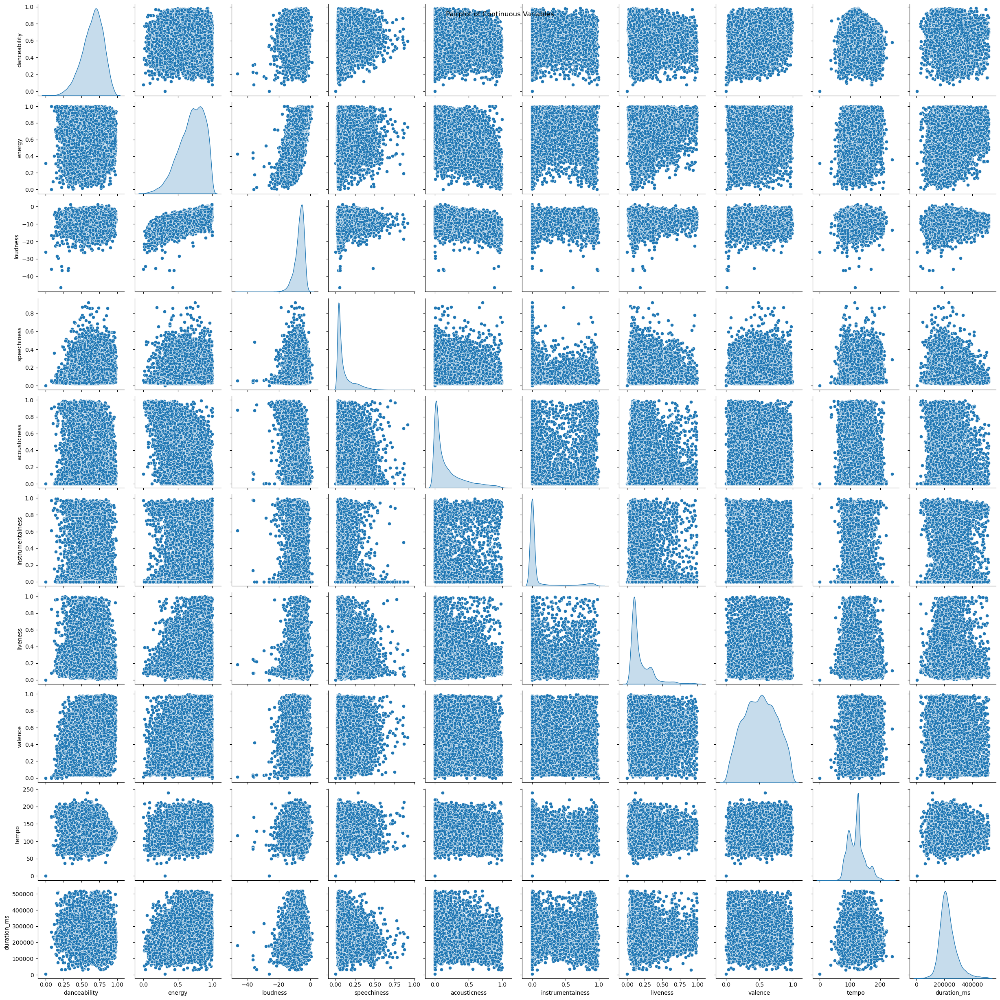

In [55]:
sns.pairplot(df_num, diag_kind='kde')
plt.suptitle('Pairplot of Continuous Variables')
plt.show()

There are many numerical values from the plots above. Let's check to see if there are relaitonships by creating correlation plots from a heatmap.

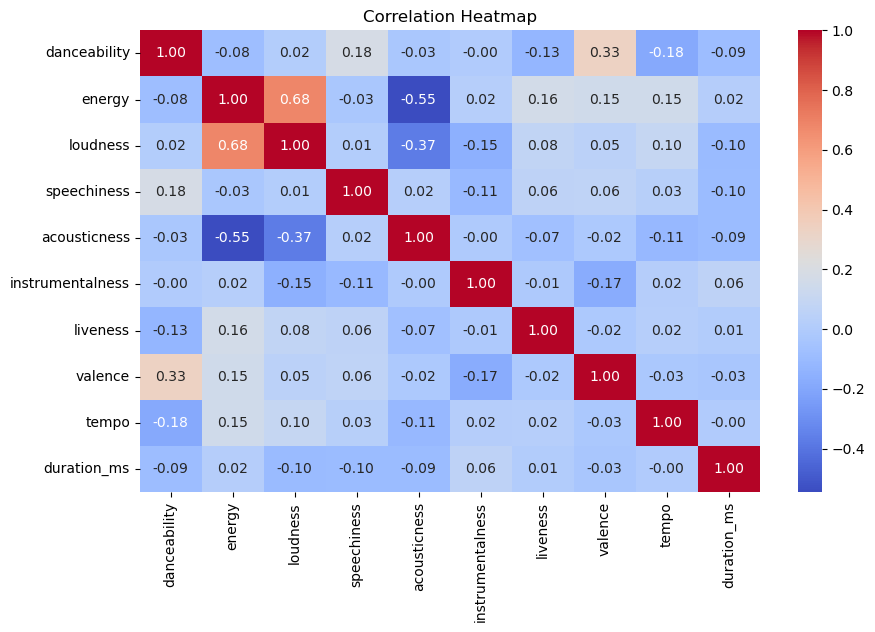

In [56]:
plt.figure(figsize=(10, 6))
sns.heatmap(df_num.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

From the heatmap we can see there are not many values with strong correlation. `Loudness` and `energy` have a moderate positive correlation values. `Acousticness` and `energy` have a moderate negative correlation value. There may be more trends if we group by the outcome variable.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


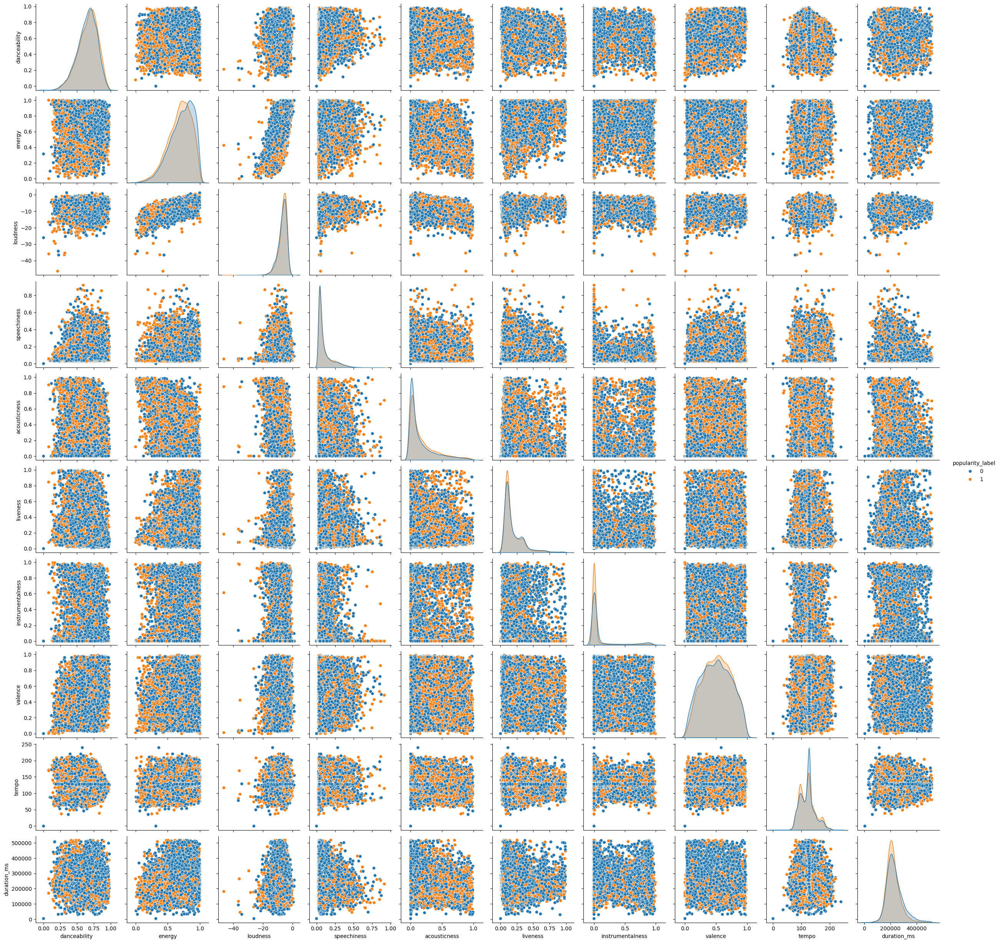

In [57]:
sns.pairplot(df_copy, x_vars = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 
                           'liveness', 'instrumentalness', 'valence','tempo', 'duration_ms'],
            y_vars = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 
                           'liveness', 'instrumentalness', 'valence','tempo', 'duration_ms'],
            hue='popularity_label',
            diag_kws={'common_norm':False})
plt.show()

There does not appear to be any distinct groups when classifying based on the outcome. Let's see if we can make each variable more gaussian like. So far only `danceability`, `valence`, and `duration_ms` are gaussian like. Let's try normalizing the other variables. For left-skewed variables, we will square or cube the value. For right-skew we will use the log tranformation or a root transformation.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


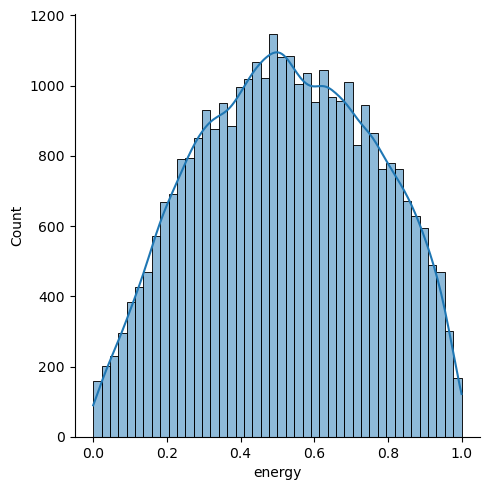

In [58]:
df_copy['energy'] = np.power(df_copy.energy, 2)

sns.displot(data = df_copy, x='energy', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


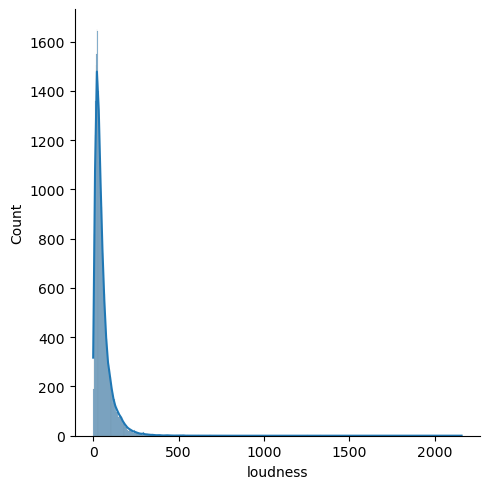

In [59]:
df_copy['loudness'] = np.power(df_copy.loudness, 2) 

sns.displot(data = df_copy, x='loudness', kind='hist', kde=True)

plt.show()

`loudness` did not become gaussian like

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


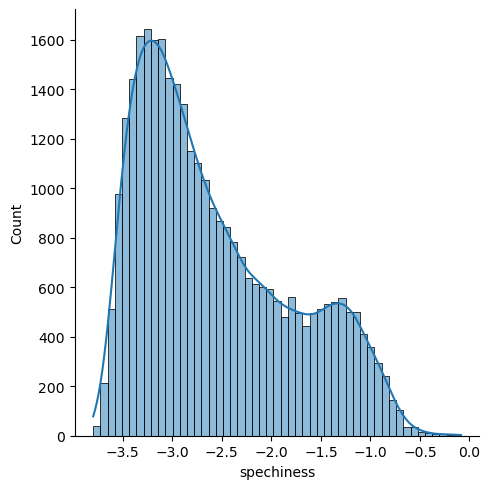

In [60]:
df_copy['spechiness'] = np.log(df.speechiness) 

sns.displot(data = df_copy, x='spechiness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


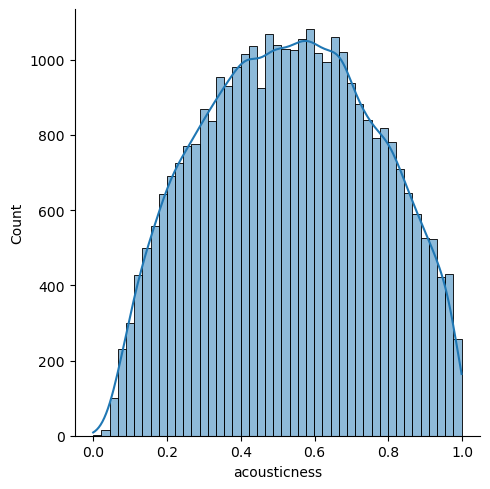

In [61]:
df_copy['acousticness'] = np.power(df_copy.acousticness, 1/4) 

sns.displot(data = df_copy, x='acousticness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


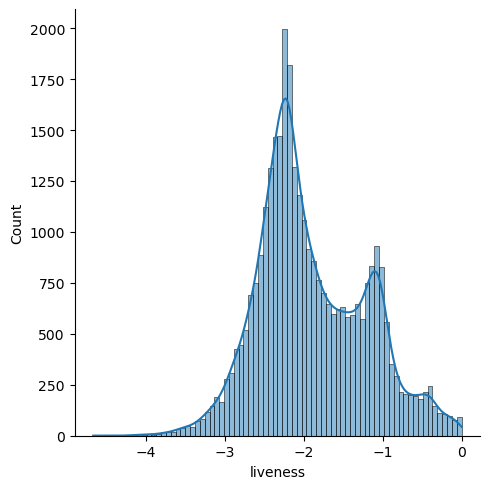

In [62]:
df_copy['liveness'] = np.log(df_copy.liveness) 

sns.displot(data = df_copy, x='liveness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


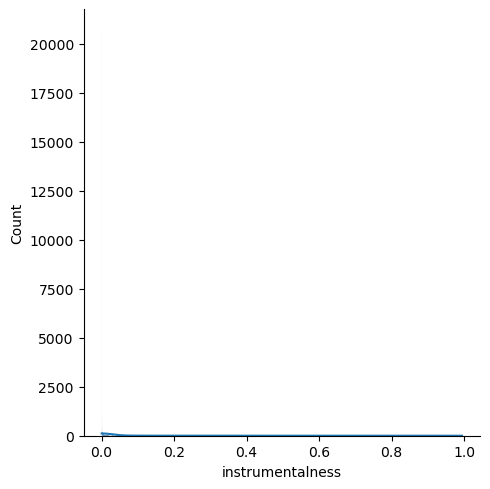

In [63]:
df_copy['instrumenalness'] = np.log(df_copy.instrumentalness) 

sns.displot(data = df_copy, x='instrumentalness', kind='hist', kde=True)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


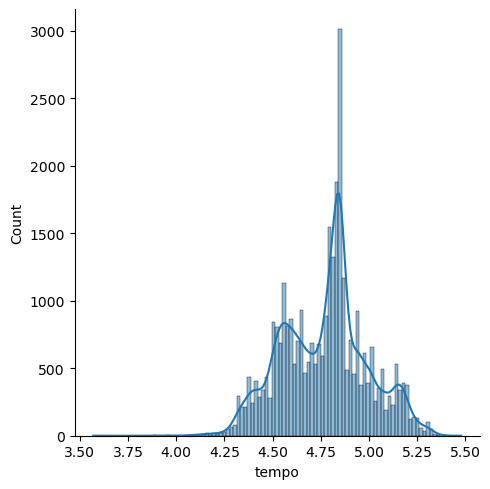

In [64]:
df_copy['tempo'] = np.log(df.tempo) 

sns.displot(data = df_copy, x='tempo', kind='hist', kde=True)

plt.show()

`Tempo` does not appear to look more gaussian like after transformations, so this will also be omitted from the model.

Therefore `energy`,`liveness` and `acousticness` look more gaussian like after there respective transformations, joining `danceability`, `valence`, and `durations_ms` as the gaussian like variables.. `Loudness`, `speechinees`, `tempo` and `Instrumentalness` do not look more gaussian even after transforming them and thus will not be included in the modelling portion or the k-means clustering portion. 

## C. Clustering 

### Pre-Process

Let's do some pre-processing for clustering and for future sections of this report.

In [65]:
df_copy = df.copy()

In [66]:
df[df['speechiness'] == 0]

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
11363,51w6nRCU68klqNfYaaVP2j,"Hi, How're You Doin'?",DREAMS COME TRUE,0,4wdK52JVu5GzhxW3RCZ3AV,Dreams Come True,1989-03-21,City Pop 1985 シティーポップ,3j2osvmecEao5nmo9jZ5df,rock,...,1,-26.087,1,0.0,0.0,0.0,0.0,0.0,0.0,4000


There appears to be a row where most of the numerical values is equal to 0. This row will be dropped as the song is real however the data is wrong. Additionally, leaving this row would cause the log tranformation to be equal to infinity which will cause errors later on.

In [67]:
df_copy.drop(df_copy[df_copy['speechiness'] == 0].index, inplace=True)
df_copy

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,2oCs0DGTsRO98Gh5ZSl2Cx,I Don't Care (with Justin Bieber) [Loud Luxury...,2019-06-14,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,6,-2.634,1,0.0583,0.102000,0.000000,0.0653,0.5180,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,63rPSO264uRjW1X5E6cWv6,Memories (Dillon Francis Remix),2019-12-13,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,11,-4.969,1,0.0373,0.072400,0.004210,0.3570,0.6930,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,1HoSmj2eLcsrR0vE9gThr4,All the Time (Don Diablo Remix),2019-07-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-3.432,0,0.0742,0.079400,0.000023,0.1100,0.6130,124.008,176616
3,75FpbthrwQmzHlBJLuGdC7,Call You Mine - Keanu Silva Remix,The Chainsmokers,60,1nqYsOef1yKKuGOVchbsk6,Call You Mine - The Remixes,2019-07-19,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,7,-3.778,1,0.1020,0.028700,0.000009,0.2040,0.2770,121.956,169093
4,1e8PAfcKUYoKkxPhrHqw4x,Someone You Loved - Future Humans Remix,Lewis Capaldi,69,7m7vv9wlQ4i0LFuJiE2zsQ,Someone You Loved (Future Humans Remix),2019-03-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-4.672,1,0.0359,0.080300,0.000000,0.0833,0.7250,123.976,189052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32828,7bxnKAamR3snQ1VGLuVfC1,City Of Lights - Official Radio Edit,Lush & Simon,42,2azRoBBWEEEYhqV6sb7JrT,City Of Lights (Vocal Mix),2014-04-28,♥ EDM LOVE 2020,6jI1gFr6ANFtT8MmTvA2Ux,edm,...,2,-1.814,1,0.0936,0.076600,0.000000,0.0668,0.2100,128.170,204375
32829,5Aevni09Em4575077nkWHz,Closer - Sultan & Ned Shepard Remix,Tegan and Sara,20,6kD6KLxj7s8eCE3ABvAyf5,Closer Remixed,2013-03-08,♥ EDM LOVE 2020,6jI1gFr6ANFtT8MmTvA2Ux,edm,...,0,-4.462,1,0.0420,0.001710,0.004270,0.3750,0.4000,128.041,353120
32830,7ImMqPP3Q1yfUHvsdn7wEo,Sweet Surrender - Radio Edit,Starkillers,14,0ltWNSY9JgxoIZO4VzuCa6,Sweet Surrender (Radio Edit),2014-04-21,♥ EDM LOVE 2020,6jI1gFr6ANFtT8MmTvA2Ux,edm,...,6,-4.899,0,0.0481,0.108000,0.000001,0.1500,0.4360,127.989,210112
32831,2m69mhnfQ1Oq6lGtXuYhgX,Only For You - Maor Levi Remix,Mat Zo,15,1fGrOkHnHJcStl14zNx8Jy,Only For You (Remixes),2014-01-01,♥ EDM LOVE 2020,6jI1gFr6ANFtT8MmTvA2Ux,edm,...,2,-3.361,1,0.1090,0.007920,0.127000,0.3430,0.3080,128.008,367432


In [68]:
df_copy['energy'] = np.power(df_copy.energy, 2)
df_copy['acousticness'] = np.power(df_copy.acousticness, 1/4) 
df_copy['liveness'] = np.log(df_copy.liveness) 

In [69]:
df_copy['mode'] = df_copy['mode'].astype('category')
df_copy['key'] = df_copy['key'].astype('category')

In [70]:
df_inputs = df_copy.groupby(['track_id'], dropna=False).\
aggregate(playlist_genre = ('playlist_genre', 'first'),
          danceability = ('danceability', 'mean'),
          energy = ('energy', 'mean'),
          key = ('key', 'first'),
          mode = ('mode', 'first'),
          acousticness = ('acousticness', 'mean'),
          liveness= ('liveness', 'mean'),
          valence = ('valence', 'mean'),
          duration_ms = ('duration_ms', 'mean')).\
reset_index()

df_num = df_inputs.select_dtypes(include=['number'])
df_categorical = df_inputs.select_dtypes(include=['object', 'category'])
df_num.head()

,danceability,energy,acousticness,liveness,valence,duration_ms
0,0.682,0.160801,0.726777,-2.422495,0.566,235440.0
1,0.582,0.495616,0.505121,-1.551169,0.698,197286.0
2,0.303,0.774400,0.328887,-1.058430,0.404,373512.0
3,0.659,0.630436,0.166091,-1.133204,0.852,228565.0
4,0.662,0.702244,0.581067,-2.429283,0.496,236308.0


In [71]:
id_cols = ['rowid'] + df_categorical.columns.to_list()
id_cols

['rowid', 'track_id', 'playlist_genre', 'key', 'mode']

In [72]:
songs_lf = df_inputs.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_num.columns) 

songs_lf

,rowid,track_id,playlist_genre,key,mode,variable,value
0,0,0017A6SJgTbfQVU2EtsPNo,rock,2,1,danceability,0.682
1,1,002xjHwzEx66OWFV2IP9dk,r&b,5,1,danceability,0.582
2,2,004s3t0ONYlzxII9PLgU6z,rock,9,1,danceability,0.303
3,3,008MceT31RotUANsKuzy3L,pop,10,0,danceability,0.659
4,4,008rk8F6ZxspZT4bUlkIQG,pop,1,1,danceability,0.662
...,...,...,...,...,...,...,...
170125,28350,7zxRMhXxJMQCeDDg0rKAVo,r&b,0,1,duration_ms,179773.000
170126,28351,7zyLObYw4QUKQDyZOb4J0Y,r&b,1,0,duration_ms,223890.000
170127,28352,7zycSpvjDcqh6YT1FEl2kY,pop,2,1,duration_ms,260240.000
170128,28353,7zye9v6B785eFWEFYs13C2,r&b,5,0,duration_ms,191205.000


In [73]:
popularity_threshold = df_copy.track_popularity.median()
df_copy['popularity_label'] = np.where(df_copy['track_popularity'] >= popularity_threshold, 1, 0)

Let's now see if the variables need to be standardized using `StandardScalar()`.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


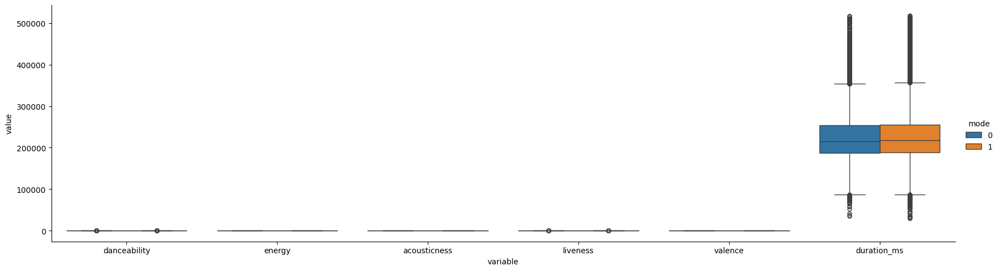

In [74]:
sns.catplot(data = songs_lf, x='variable', y='value', hue = 'mode', kind='box', aspect=3.5)

plt.show()

There is one variable that is much larger in magnitude and scale thus we shall standardize the data using the `StandardScaler()` feature.


In [75]:
X_songs = StandardScaler().fit_transform( df_num)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


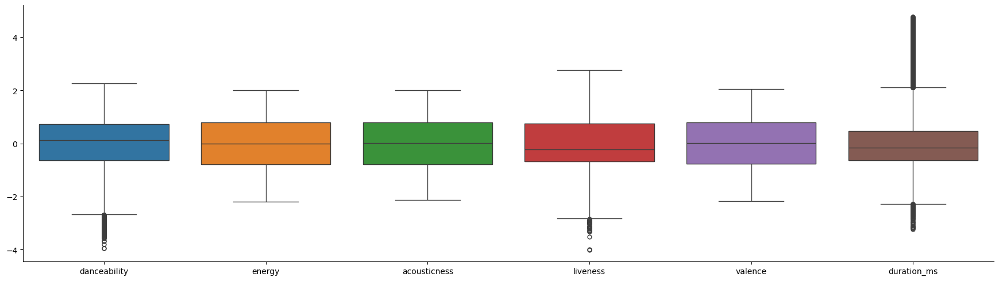

In [76]:
sns.catplot(data = pd.DataFrame(X_songs, columns=df_num.columns), kind='box', aspect=3.5)

plt.show()

The data appears to be standardized and ready for K-means clustering.

### K-means Cluster

First let's do k-means cluster with 2 clusters

In [77]:
clusters_2 = KMeans(n_clusters=2, random_state= 121, n_init=25, max_iter=500).fit_predict(X_songs)

In [78]:
df_num_copy = df_num.copy()
df_inputs_copy = df_inputs.copy()

In [79]:
df_num_copy['k2'] = pd.Series( clusters_2, index=df_inputs_copy.index).astype('category')

In [80]:
df_num_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   danceability  28355 non-null  float64 
 1   energy        28355 non-null  float64 
 2   acousticness  28355 non-null  float64 
 3   liveness      28355 non-null  float64 
 4   valence       28355 non-null  float64 
 5   duration_ms   28355 non-null  float64 
 6   k2            28355 non-null  category
dtypes: category(1), float64(6)
memory usage: 1.3 MB


In [81]:
df_num_copy.k2.value_counts()

k2
0    16302
1    12053
Name: count, dtype: int64

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


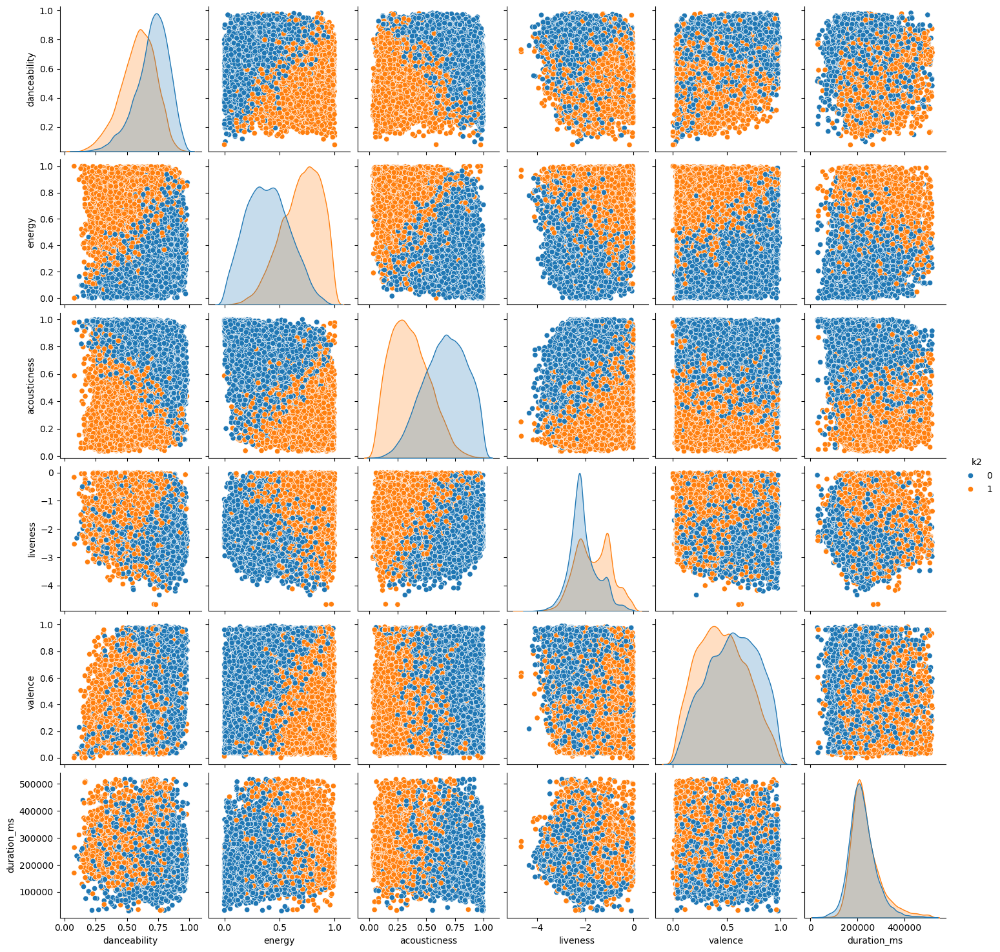

In [82]:
sns.pairplot(data = df_num_copy, hue='k2', diag_kws={'common_norm': False})

plt.show()

Pairsplot shows to many variables so we will execute a PCA. Additionally clusters seem to be balanced in some of the variables such as `energy`, `loudness` and `acousticness`.

### PCA with 2 components

In [83]:
pca_songs = PCA(n_components=2).fit_transform(X_songs)

In [84]:
pca_songs_df = pd.DataFrame( pca_songs, columns=['pc01', 'pc02']) 

In [85]:
pca_songs_df['k2'] = pd.Series( clusters_2, index=df_num_copy.index).astype('category')

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


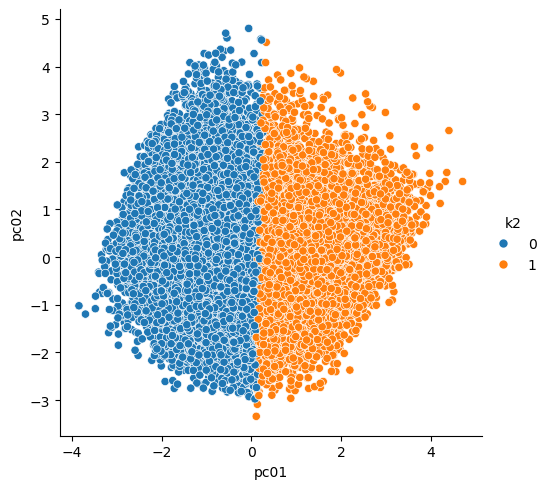

In [86]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k2')

plt.show()

Now let's compare this with the binary classification variable created at the beginning for `popularity_label`.

In [88]:
pca_songs_df['popularity_label'] = df_copy.popularity_label

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


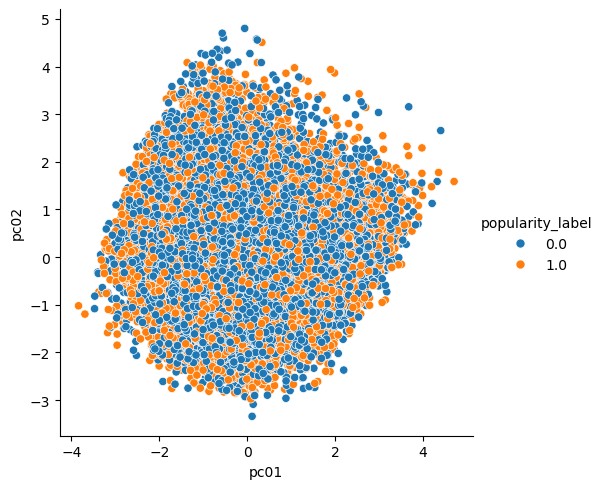

In [89]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='popularity_label')

plt.show()

From the plot, we can see that the values are still all over the place, however this is better than when first explored in the EDA. 


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


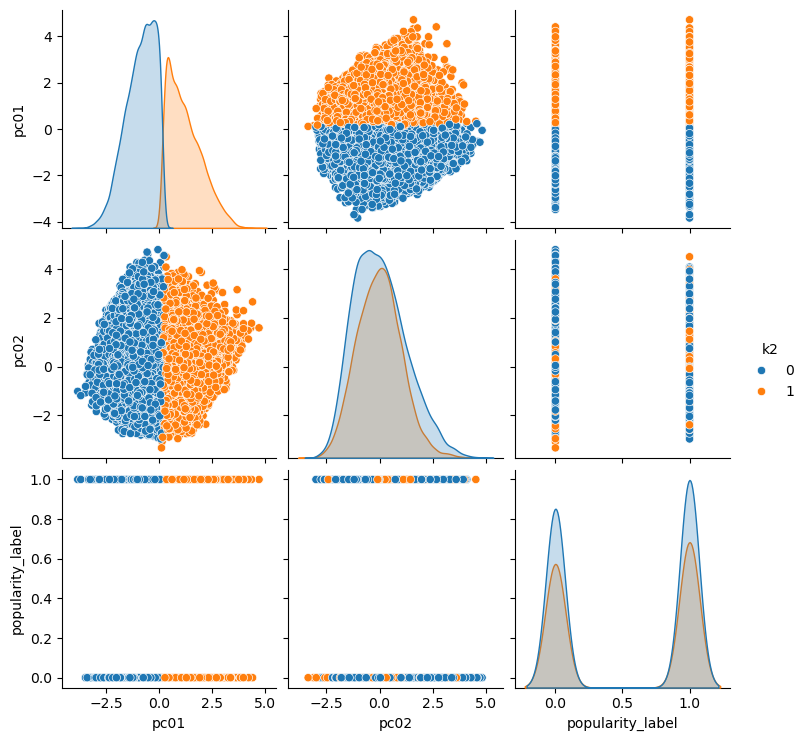

In [90]:
sns.pairplot(data= pca_songs_df, hue='k2')

plt.show()

The pairplot shows the PCA as balanced the values for k2 components. However, when comparing to the popularity label we can see the values are all over the place.

Let's look for the optimal clusters using the Knee bend plot

In [91]:
tots_within = []

K = range(1, 20)

for k in K:
    km = KMeans(n_clusters=k, random_state=121, n_init=25, max_iter=500)
    km = km.fit(X_songs)
    tots_within.append(km.inertia_)

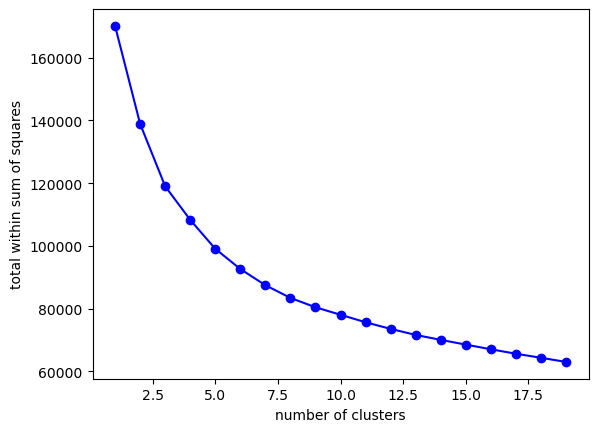

In [92]:
fig, ax = plt.subplots()

ax.plot( K, tots_within, 'bo-')
ax.set_xlabel('number of clusters')
ax.set_ylabel('total within sum of squares')

plt.show() 

From the plot above we can see 4-7 clusters is a decent value to run KMeans clustering. Let's use KMeans with 5 clusters.

In [93]:
clusters_5 = KMeans(n_clusters=5, random_state= 121, n_init=25, max_iter=500).fit_predict(X_songs)

In [94]:
pca_songs_df['k5'] = pd.Series( clusters_5, index=df_num_copy.index).astype('category')

In [95]:
pca_songs_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   pc01              28355 non-null  float64 
 1   pc02              28355 non-null  float64 
 2   k2                28355 non-null  category
 3   popularity_label  28354 non-null  float64 
 4   k5                28355 non-null  category
dtypes: category(2), float64(3)
memory usage: 720.3 KB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


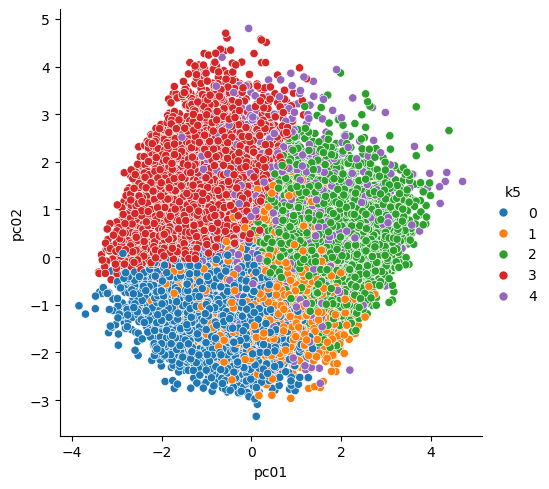

In [96]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k5')

plt.show()

In [97]:
df_num_copy['popularity_label'] = df_copy.popularity_label
df_num_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   danceability      28355 non-null  float64 
 1   energy            28355 non-null  float64 
 2   acousticness      28355 non-null  float64 
 3   liveness          28355 non-null  float64 
 4   valence           28355 non-null  float64 
 5   duration_ms       28355 non-null  float64 
 6   k2                28355 non-null  category
 7   popularity_label  28354 non-null  float64 
dtypes: category(1), float64(7)
memory usage: 1.5 MB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


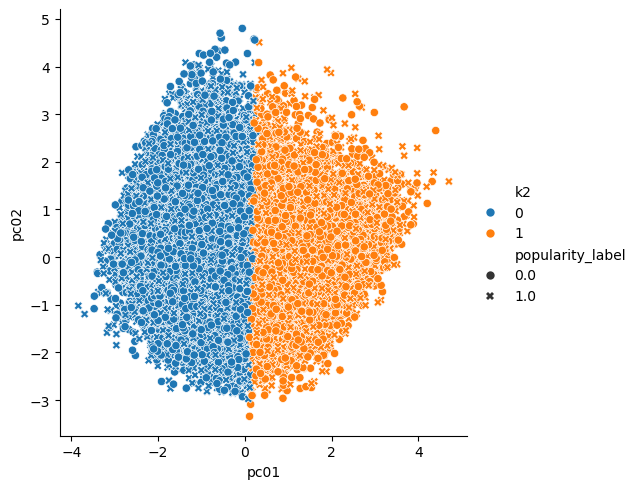

In [98]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k2', style='popularity_label')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


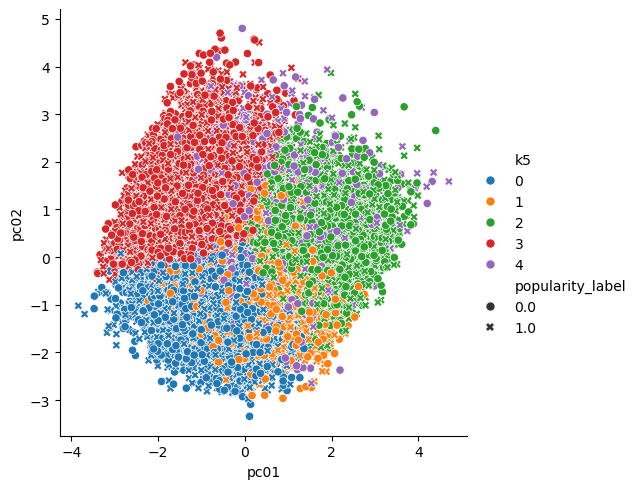

In [99]:
sns.relplot(data = pca_songs_df, x='pc01', y='pc02', hue='k5', style='popularity_label')

plt.show()

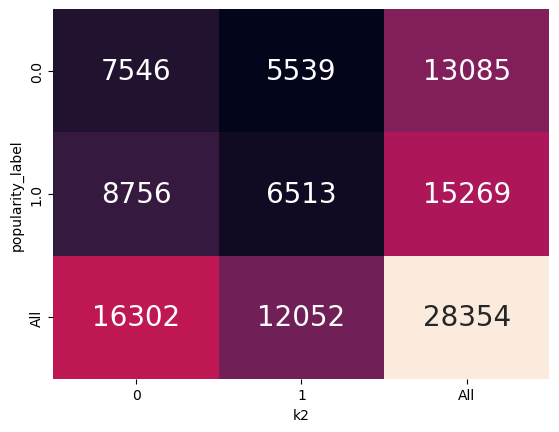

In [100]:
fig, ax = plt.subplots()

sns.heatmap(data = pd.crosstab( df_num_copy.popularity_label, df_num_copy.k2, margins=True ), 
            annot=True, annot_kws={"fontsize": 20}, fmt='g',
            cbar=False,
            ax=ax)

plt.show()

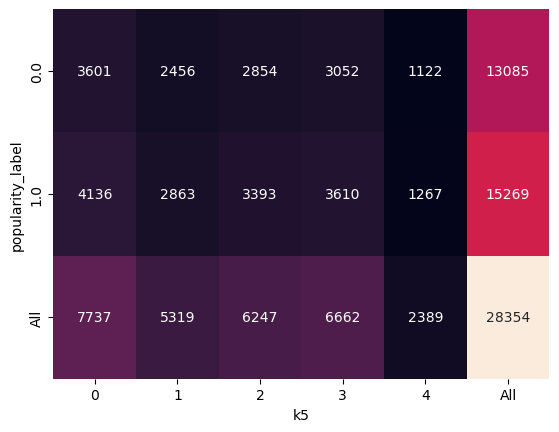

In [101]:
fig, ax = plt.subplots()

sns.heatmap(data = pd.crosstab( pca_songs_df.popularity_label, pca_songs_df.k5, margins=True ), 
            annot=True, annot_kws={"fontsize": 10}, fmt='g',
            cbar=False,
            ax=ax)

plt.show()

Comparing the popularity label with the k2 kmeans clustering, we can see there were a couple hundred more songs put into the 0 label, or the less popular label, and a couple hundred less songs put into the 1 label, or the more popular label. This means we could classify the songs into smaller groups, such as 5 groups. Now let's try Hierarchal clustering.

In [102]:
hclust_complete = hierarchy.complete(X_songs)

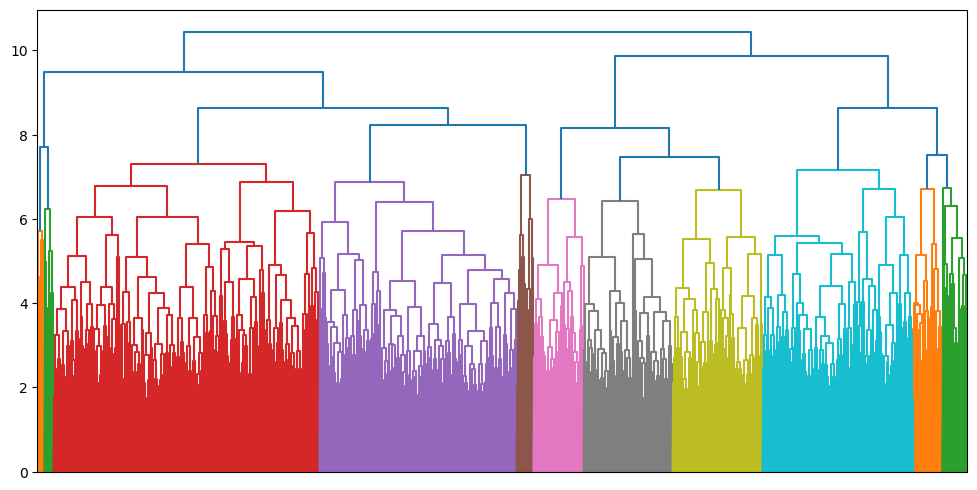

In [103]:
fig = plt.figure(figsize=(12, 6))

dn = hierarchy.dendrogram(hclust_complete, no_labels=True )

plt.show()

In [104]:
hclust_average = hierarchy.average( X_songs)

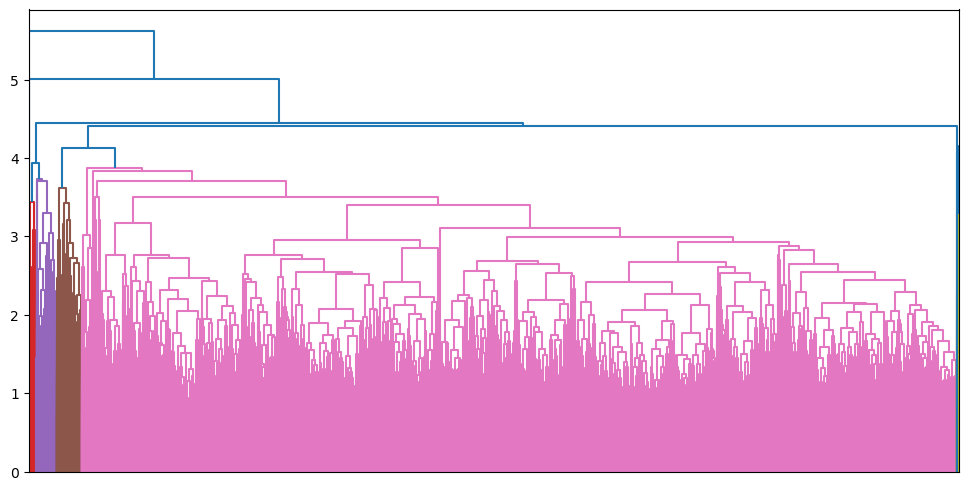

In [105]:
fig = plt.figure(figsize=(12,6))

dn = hierarchy.dendrogram( hclust_average, no_labels=True )

plt.show()

In [106]:
hclust_centroid = hierarchy.centroid( X_songs )

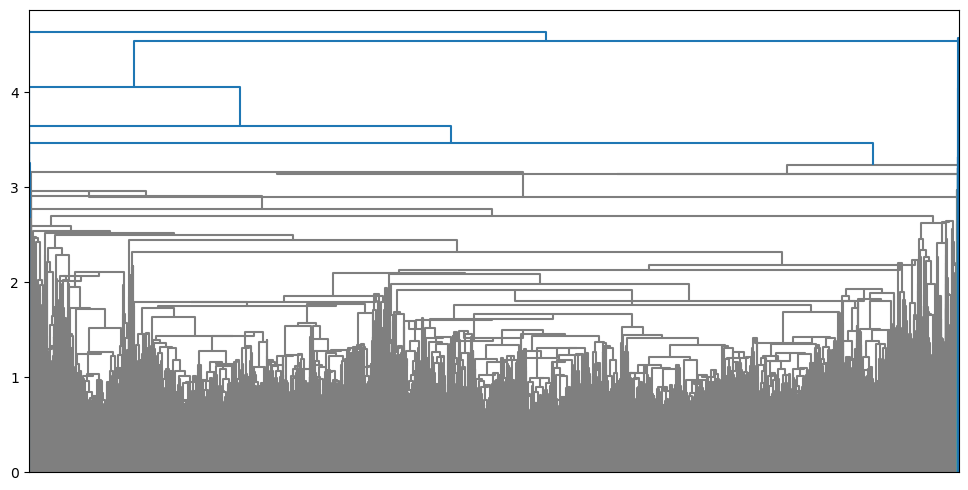

In [107]:
fig = plt.figure(figsize=(12,6))

dn = hierarchy.dendrogram( hclust_centroid, no_labels=True )

plt.show()

In [108]:
hclust_ward = hierarchy.ward( X_songs )

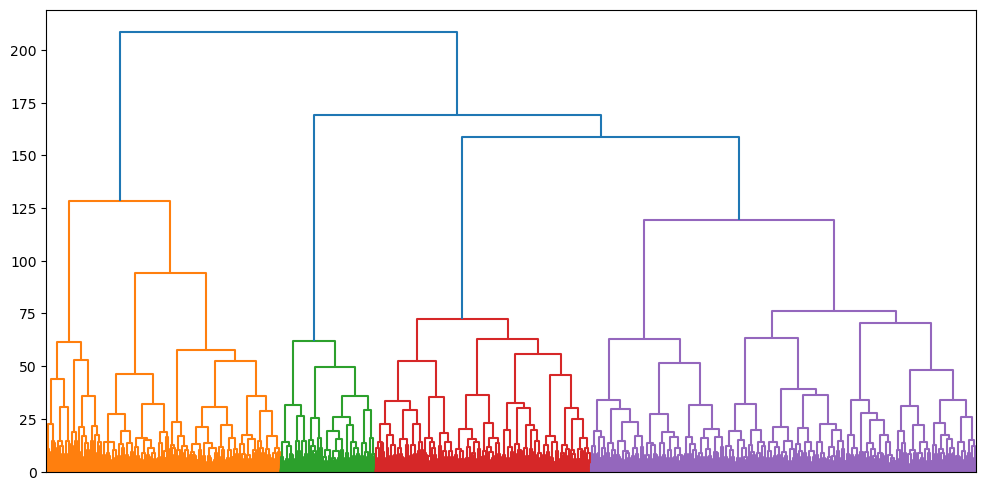

In [109]:
fig = plt.figure(figsize=(12,6))

dn = hierarchy.dendrogram( hclust_ward, no_labels=True )

plt.show()

It seems ward clustering produced the best results so we will cut that tree. Let's explore clusters at 2 (known categories) and 6.

In [110]:
hierarchy.cut_tree( hclust_ward, n_clusters=6).ravel()

array([0, 1, 2, ..., 1, 5, 5])

In [111]:
pca_songs_df['hclust_6'] = pd.Series(hierarchy.cut_tree( hclust_ward, n_clusters=6).ravel(),
                                    index=pca_songs_df.index).astype('category')

In [112]:
pca_songs_df['hclust_2'] = pd.Series(hierarchy.cut_tree( hclust_ward, n_clusters=2).ravel(),
                                    index=pca_songs_df.index).astype('category')

In [113]:
pca_songs_df.info()
pca_songs_df.hclust_2.value_counts()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   pc01              28355 non-null  float64 
 1   pc02              28355 non-null  float64 
 2   k2                28355 non-null  category
 3   popularity_label  28354 non-null  float64 
 4   k5                28355 non-null  category
 5   hclust_6          28355 non-null  category
 6   hclust_2          28355 non-null  category
dtypes: category(4), float64(3)
memory usage: 776.0 KB


hclust_2
0    21213
1     7142
Name: count, dtype: int64

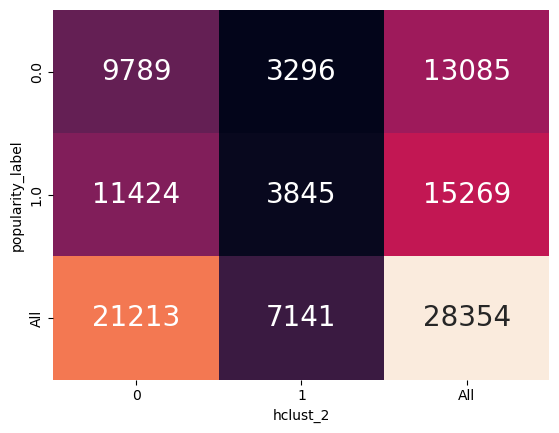

In [114]:
fig, ax = plt.subplots()

sns.heatmap( data = pd.crosstab( pca_songs_df.popularity_label, pca_songs_df.hclust_2, margins=True),
            annot=True, annot_kws={'fontsize':20}, fmt='g',
            cbar=False, ax=ax)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


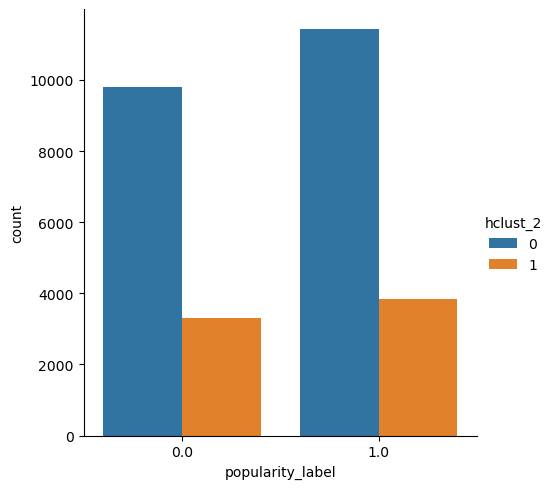

In [115]:
sns.catplot(data = pca_songs_df, x='popularity_label', hue='hclust_2', kind='count')

plt.show()

From the bar chart and heat map, we can see that the values are not correspondent to the orignial categories. A lot more of the 0 cluster values ended up in the high popularity value (1) than the low popularity values (0). The bar chart shows the same.

Let's explore the original transformed features. 

In [116]:
df_num_copy['hclust_2'] =  pca_songs_df.hclust_2

In [117]:
df_num_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   danceability      28355 non-null  float64 
 1   energy            28355 non-null  float64 
 2   acousticness      28355 non-null  float64 
 3   liveness          28355 non-null  float64 
 4   valence           28355 non-null  float64 
 5   duration_ms       28355 non-null  float64 
 6   k2                28355 non-null  category
 7   popularity_label  28354 non-null  float64 
 8   hclust_2          28355 non-null  category
dtypes: category(2), float64(7)
memory usage: 1.6 MB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


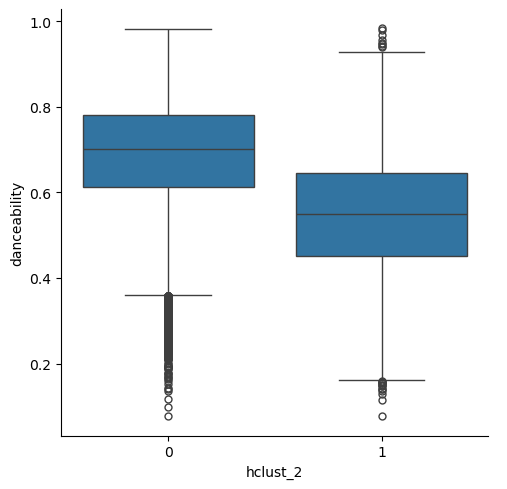

In [118]:
sns.catplot( data = df_num_copy, x='hclust_2', y='danceability', kind='box')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


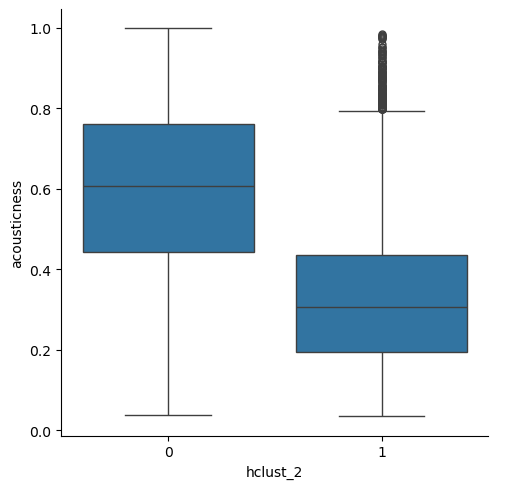

In [119]:
sns.catplot( data = df_num_copy, x='hclust_2', y='acousticness', kind='box')

plt.show()

In [120]:
df_inputs_copy['hclust_2'] =  pca_songs_df.hclust_2
df_inputs_copy['hclust_6'] =  pca_songs_df.hclust_6

In [121]:
lf_2 = df_inputs_copy.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=['rowid', 'key', 'mode', 'playlist_genre', 'hclust_2'],
         value_vars=df_inputs_copy.columns)

In [122]:
lf_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 226840 entries, 0 to 226839
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   rowid           226840 non-null  int64   
 1   key             226840 non-null  category
 2   mode            226840 non-null  category
 3   playlist_genre  226840 non-null  object  
 4   hclust_2        226840 non-null  category
 5   variable        226840 non-null  object  
 6   value           226840 non-null  object  
dtypes: category(3), int64(1), object(3)
memory usage: 7.6+ MB


Now lets visualize the numerical features against all the featuers

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


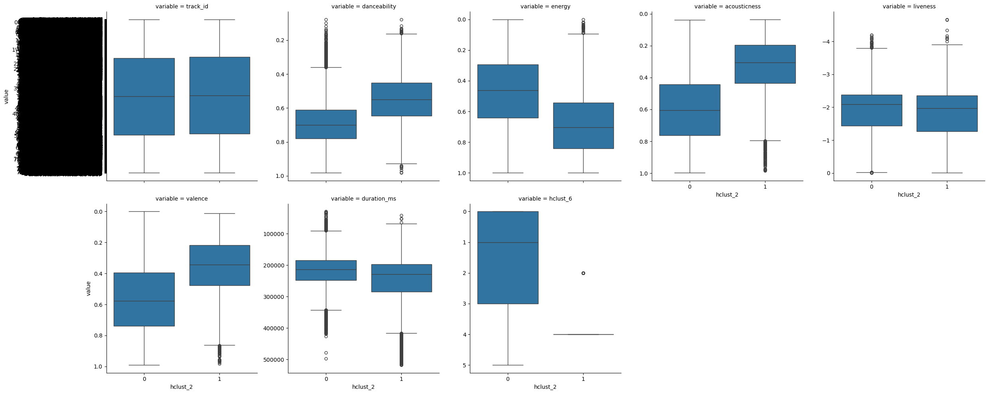

In [123]:
sns.catplot( data = lf_2, x='hclust_2', y='value', col='variable', col_wrap=5, 
            kind='box',
            sharey=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


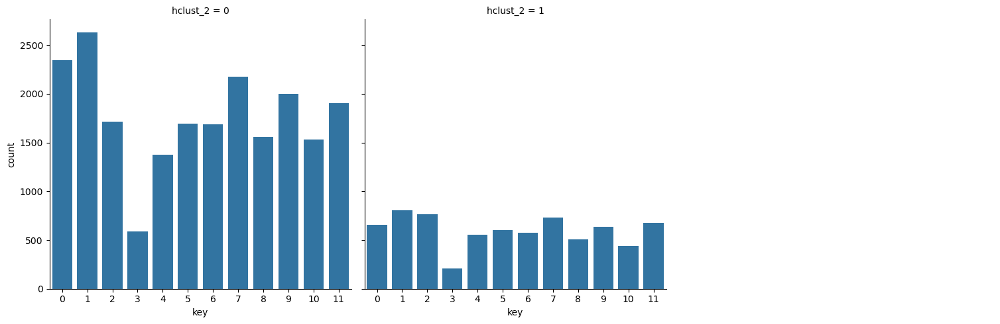

In [124]:
sns.catplot( data = df_inputs_copy, x='key', col='hclust_2',
             col_wrap=3, kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


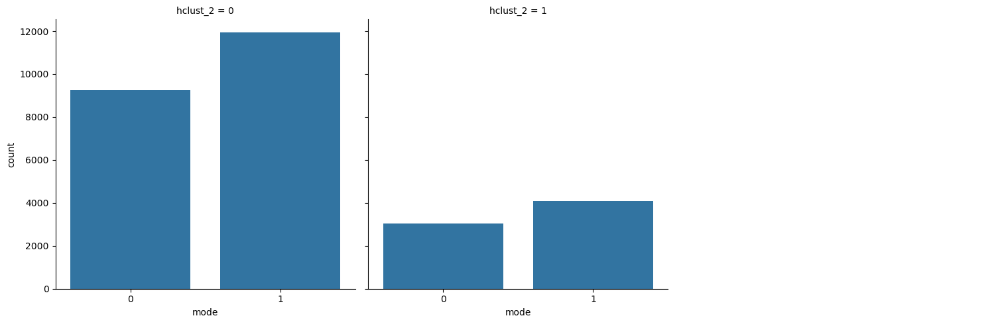

In [125]:
sns.catplot( data = df_inputs_copy, x='mode', col='hclust_2',
             col_wrap=3, kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


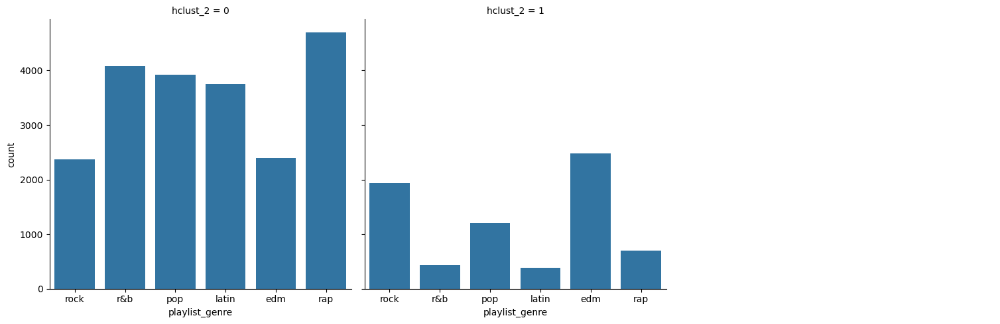

In [126]:
sns.catplot( data = df_inputs_copy, x='playlist_genre', col='hclust_2',
             col_wrap=3, kind='count')

plt.show()

Comparing the clustering groups with the categorical values, we can see there are many more values clusterd into the 0 group than the 1 group. However, they seem to share a similar bin distribution among the categorical values in the `key`, `mode` and `playlist_genre`.

Let's take a look at the hclust_6 values.

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


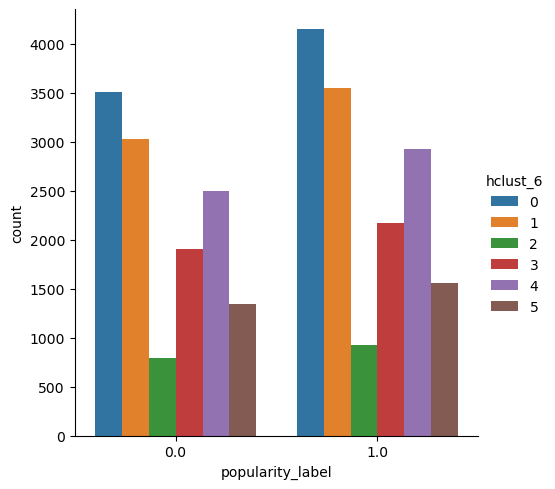

In [127]:
sns.catplot(data = pca_songs_df, x='popularity_label', hue='hclust_6', kind='count')

plt.show()

Both 0 and 1 popularity labels show similar distribution trends, with the 0 cluster being much larger than the rest of the groups in both values.

In [128]:
pca_songs_df.hclust_6.value_counts()

hclust_6
0    7663
1    6579
4    5427
3    4073
5    2898
2    1715
Name: count, dtype: int64

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


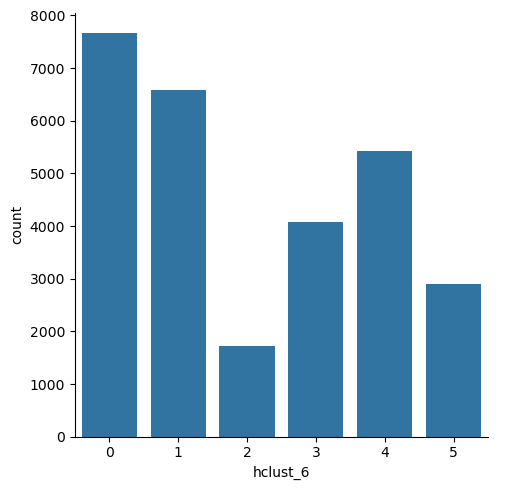

In [129]:
sns.catplot( data = pca_songs_df, x='hclust_6', kind='count')

plt.show()

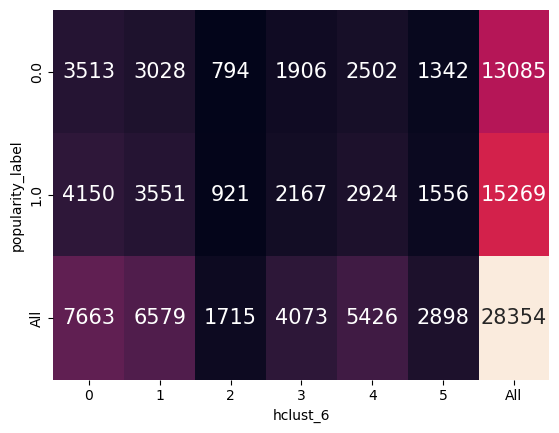

In [130]:
fig, ax = plt.subplots()

sns.heatmap( data = pd.crosstab( pca_songs_df.popularity_label, pca_songs_df.hclust_6, margins=True),
            annot=True, annot_kws={'fontsize':15}, fmt='g',
            cbar=False, ax=ax)

plt.show()

In [131]:
lf_6 = df_inputs_copy.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=['rowid', 'key', 'mode', 'playlist_genre', 'hclust_6'],
         value_vars=df_inputs_copy.columns)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


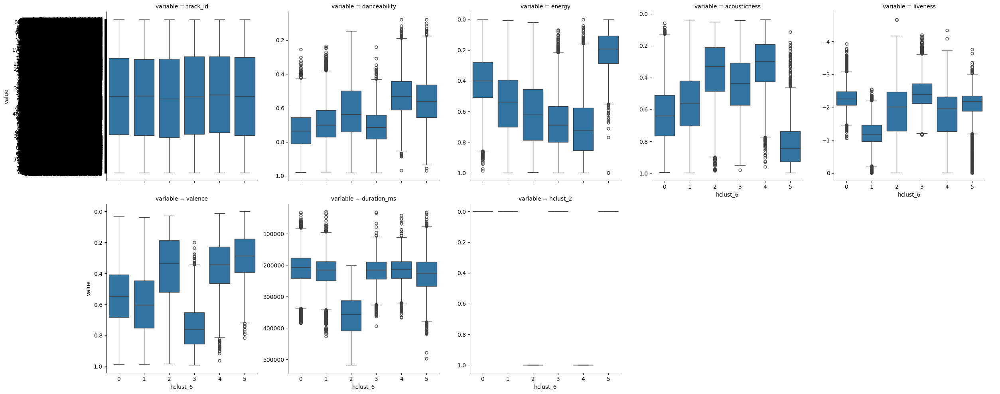

In [132]:
sns.catplot( data = lf_6, x='hclust_6', y='value', col='variable', col_wrap=5, 
            kind='box',
            sharey=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


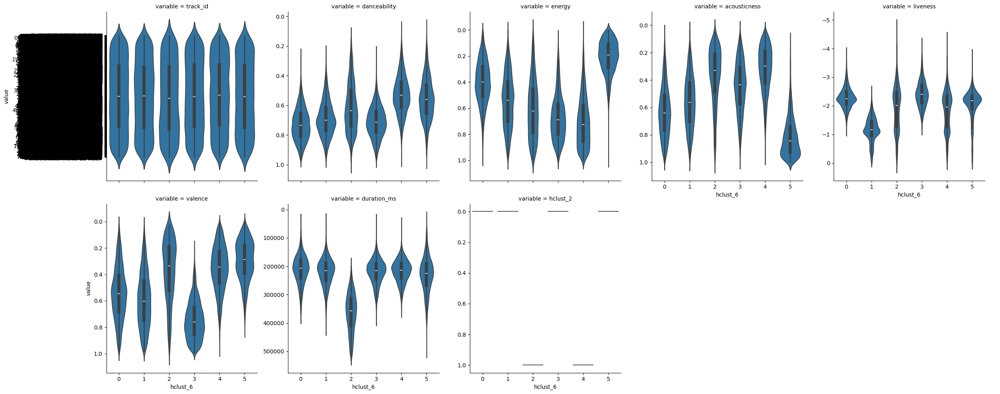

In [133]:
sns.catplot( data = lf_6, x='hclust_6', y='value', col='variable', col_wrap=5, 
            kind='violin',
            sharey=False)

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


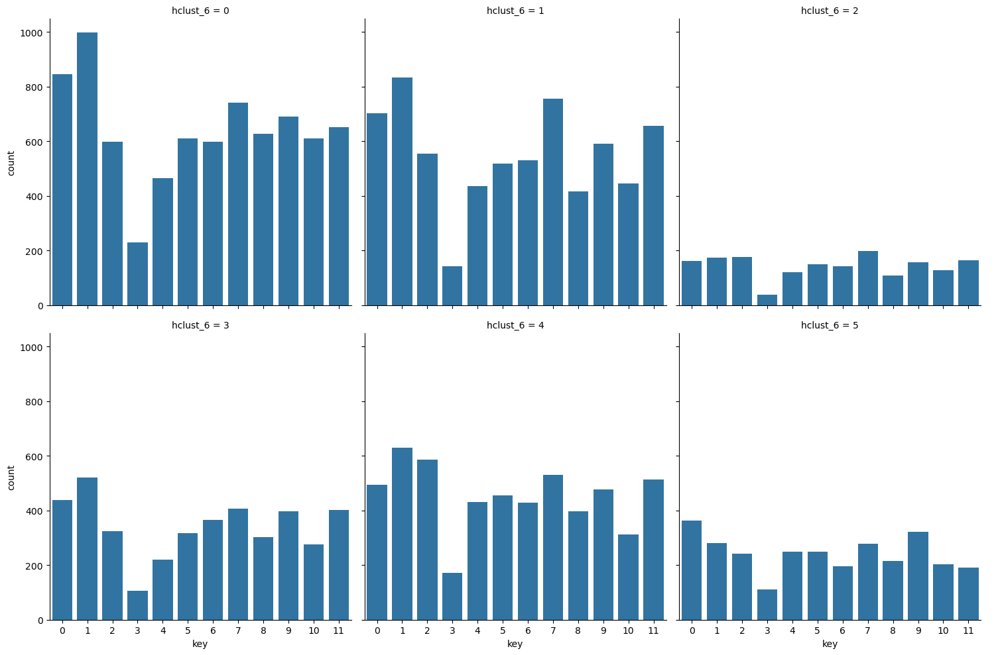

In [134]:
sns.catplot( data = df_inputs_copy, x='key', col='hclust_6',
             col_wrap=3, kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


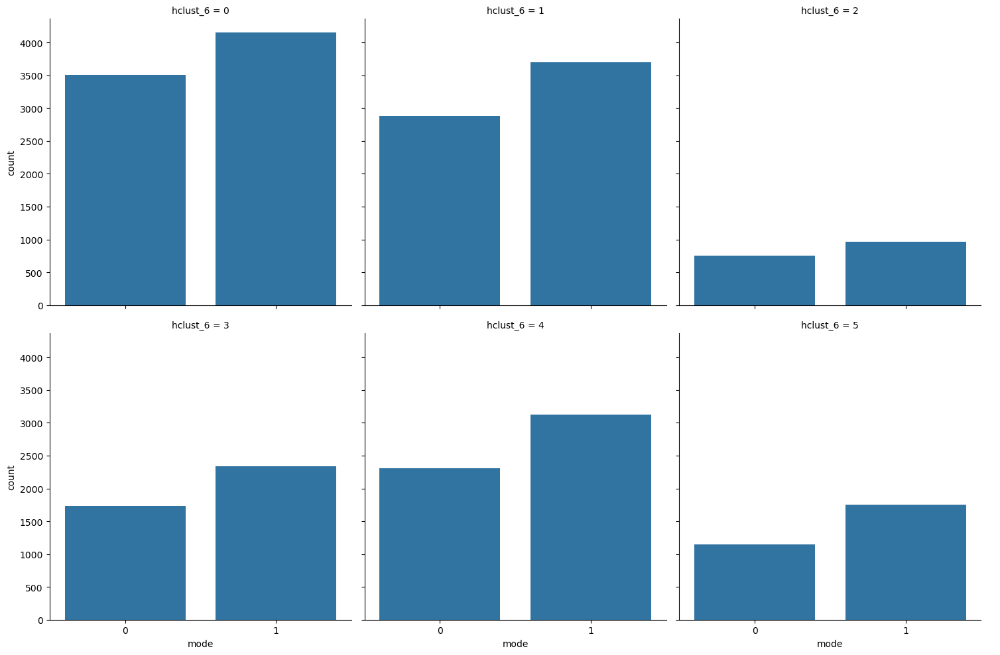

In [135]:
sns.catplot( data = df_inputs_copy, x='mode', col='hclust_6',
             col_wrap=3, kind='count')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


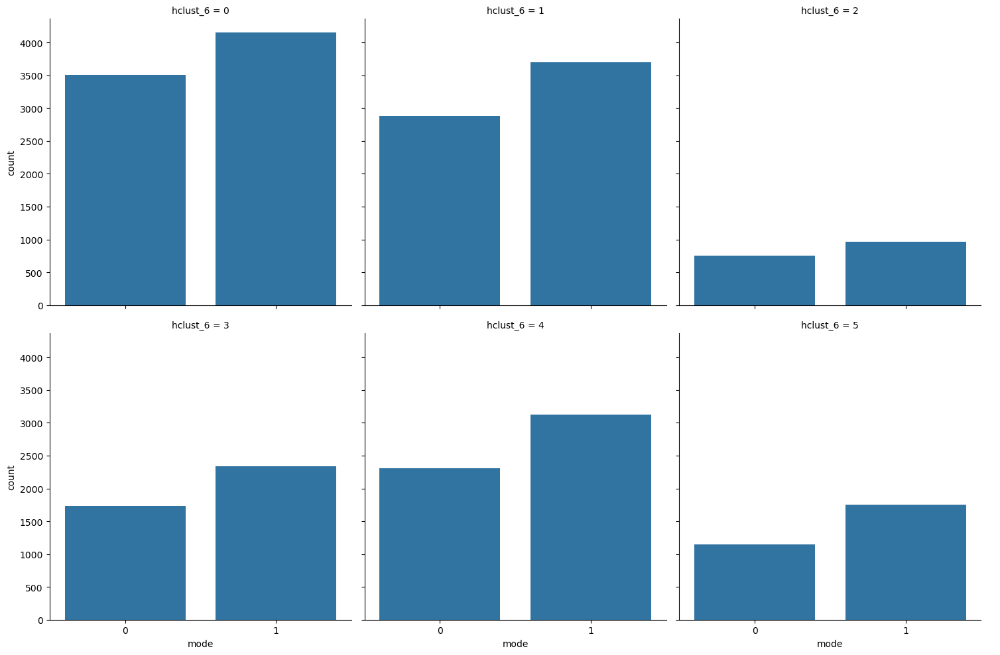

In [136]:
sns.catplot( data = df_inputs_copy, x='mode', col='hclust_6',
             col_wrap=3, kind='count')

plt.show()

Comparing the clustering groups with the categorical values, we can see there are many more values clusterd into the 0 group than the 1 group. However, they seem to share a similar bin distribution among the categorical values in the `key`, `mode` and `playlist_genre`. 

Comparing the hierarchal clustering values to the numerical inputs, we can see some variables e.g `danceability` have a wide distribution across its values while other such as `tempo` have more values centered around the mean.

## D. Modelling

Let's create the dataset.

In [306]:
df_modelling = df_copy.groupby(['track_id'], dropna=False).\
aggregate(playlist_genre = ('playlist_genre', 'first'),
          danceability = ('danceability', 'mean'),
          energy = ('energy', 'mean'),
          key = ('key', 'first'),
          mode = ('mode', 'first'),
          acousticness = ('acousticness', 'mean'),
          liveness= ('liveness', 'mean'),
          valence = ('valence', 'mean'),
          duration_ms = ('duration_ms', 'mean'),
          y = ('popularity_label', 'first')).\
reset_index()

df_modelling['y'] = df_modelling.y.astype('category')
num = df_modelling.select_dtypes(include=['number']).columns
categorical = df_modelling.select_dtypes(include=['object', 'category']).columns

Need to standardize before we attempt to model the variables

In [307]:
df_modelling[num] = StandardScaler().fit_transform(df_modelling[num])

In [308]:
df_modelling['y'] = df_modelling.y.astype('int64')

In [309]:
df_modelling.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28355 entries, 0 to 28354
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   track_id        28355 non-null  object  
 1   playlist_genre  28355 non-null  object  
 2   danceability    28355 non-null  float64 
 3   energy          28355 non-null  float64 
 4   key             28355 non-null  category
 5   mode            28355 non-null  category
 6   acousticness    28355 non-null  float64 
 7   liveness        28355 non-null  float64 
 8   valence         28355 non-null  float64 
 9   duration_ms     28355 non-null  float64 
 10  y               28355 non-null  int64   
dtypes: category(2), float64(6), int64(1), object(2)
memory usage: 2.0+ MB


Before we start modelling, we shall define some functions before hand for the coefficient plot, assesing the accuracy values and for fitting and assesing the for the ROC curve

In [310]:
def my_coefplot(mod, figsize_use=(10,10)):
    fig, ax = plt.subplots(figsize=figsize_use)
    
    ax.errorbar( y=mod.params.index,
                 x=mod.params,
                 xerr = 2*mod.bse,
                 fmt='o', color='k', ecolor='k', elinewidth=2, ms=10)
   
    ax.axvline(x=0, linestyle='--', linewidth=3.5, color='grey')
    
    ax.set_xlabel('coefficient value')
   
    plt.show()
    

In [311]:
def fit_and_assess_logistic(mod_name, a_formula, train_data, threshold):
    a_mod = smf.logit(formula=a_formula, data = train_data).fit()

    train_copy = train_data.copy()

    train_copy['pred_probability'] = a_mod.predict( train_data )

    train_copy['pred_class'] = np.where( train_copy.pred_probability > threshold, 1, 0)

    TN, FP, FN, TP = confusion_matrix( train_copy.y.to_numpy(), train_copy.pred_class.to_numpy() ).ravel()

    Accuracry = (TN + TP)/(TN +  FP + FN + TP)

    Sensitivity = (TP)/(TP+FN) 

    Specificity = (TN)/(TN+FP)

    FPR = 1 - Specificity

    ROC_AUC = roc_auc_score(train_copy.y.to_numpy(), train_copy.pred_probability.to_numpy() )

    res_dict = {'model_name': mod_name, 
                'model_formula': a_formula,
                'num_coefs' : len(a_mod.params),
                'threshold': threshold,
                'Accuracy' : Accuracry,
                'Sensitivity': Sensitivity,
                'Specificity': Specificity,
                'FPR': FPR,
                'ROC_AUC': ROC_AUC}

    return pd.DataFrame( res_dict, index=[0] )

In [312]:
def fit_logistic_make_roc(mod_name, a_formula, train_data):
    a_mod = smf.logit(formula=a_formula, data=train_data).fit()

    train_copy = train_data.copy()

    train_copy['pred_probability'] = a_mod.predict( train_data )

    fpr, tpr, threshold = roc_curve( train_data.y.to_numpy(), train_copy.pred_probability.to_numpy() )

    res_df = pd.DataFrame({'tpr': tpr,
                           'fpr': fpr,
                           'threshold' : threshold})
    res_df['model_name'] = mod_name 
    res_df['model_formula'] = a_formula

    return res_df

### Model 1: Intercept Only Model 

First let's fit the model

In [313]:
fit_model = smf.logit(formula='y ~ 1', data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.690903
         Iterations 3


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28354
Method:                           MLE   Df Model:                            0
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:               7.519e-11
Time:                        11:19:25   Log-Likelihood:                -19591.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                       nan
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.1341      0.012    -11.269      0.000      -0.157      -0.111
==============================================================================
"""

i.	How many coefficients were estimated?

In [314]:
fit_model.params.shape[0]

1

Standard error on mean for each coefficient

In [315]:
fit_model.bse

Intercept    0.011904
dtype: float64

Confidence intervals

In [316]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.157477,-0.110814


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [317]:
fit_model.pvalues 

Intercept    1.867232e-29
dtype: float64

In [318]:
fit_model.pvalues < 0.05

Intercept    True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [319]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept    NEGATIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [320]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

Intercept   -0.134145
dtype: float64

In [321]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

Intercept   -0.134145
dtype: float64

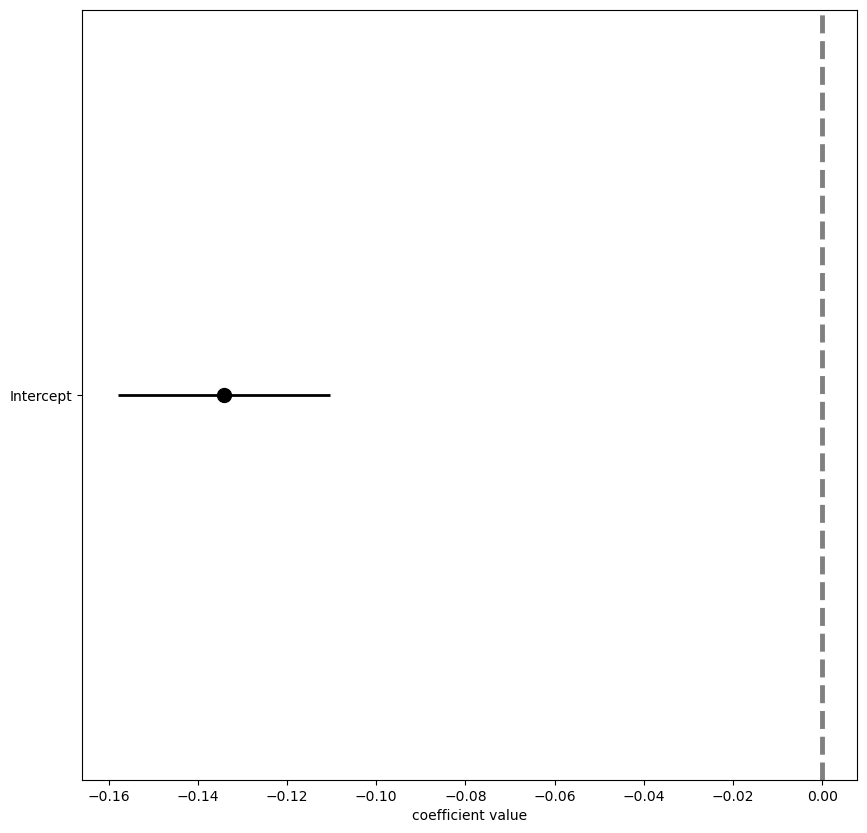

In [322]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [323]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


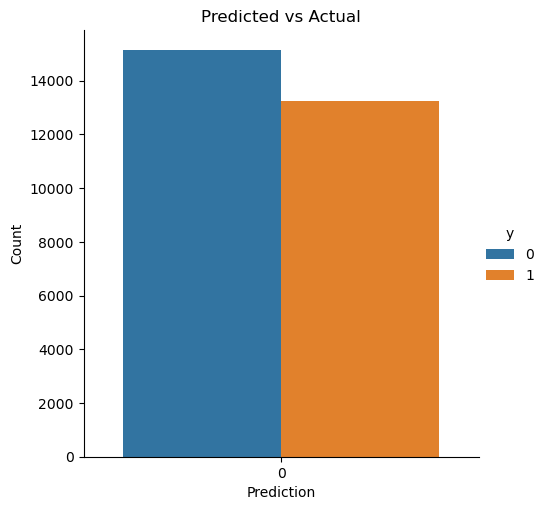

In [324]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

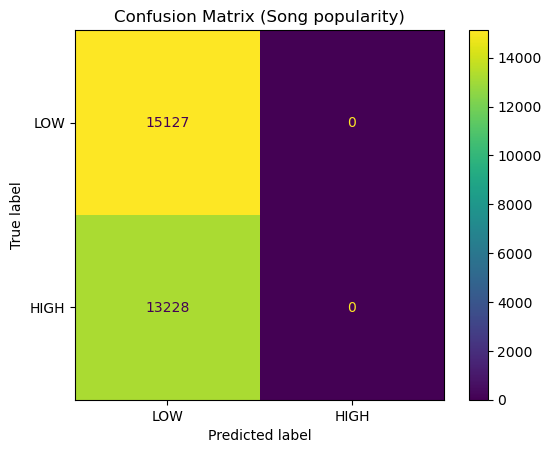

In [325]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [326]:
pred = fit_and_assess_logistic(1, 'y ~ 1', train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.690903
         Iterations 3


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,1,y ~ 1,1,0.5,0.533486,0.0,1.0,0.0,0.5


In [327]:
ROC = fit_logistic_make_roc(1, 'y ~ 1', train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.690903
         Iterations 3


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


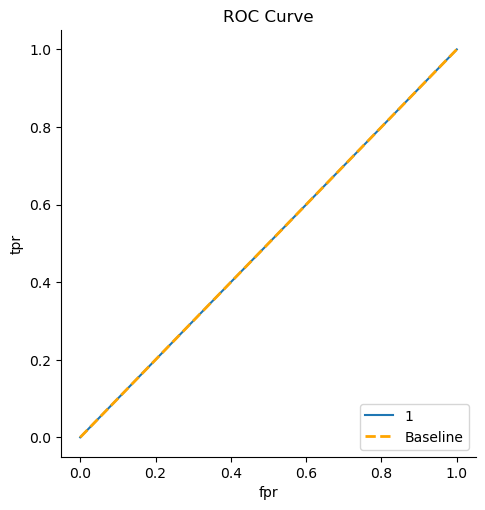

In [328]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

Let's create a dataset for the models we will use, seen below.

In [329]:
formula_list = ['y ~ 1', # Intercept only
                'y ~ key + mode + playlist_genre', # Categorical additive
                'y ~ danceability + energy + acousticness + liveness + valence + duration_ms', # Continous additive 
                'y ~ key + mode + playlist_genre + danceability + energy + acousticness + liveness + valence + duration_ms', #All inputs with linear additive features
                'y ~ (danceability + energy + acousticness + liveness + valence + duration_ms)**2',# Continous inputs with linear main effect and pair-wise interactions
                'y ~ (key + mode + playlist_genre)*(danceability + energy + acousticness + liveness + valence + duration_ms)', #Interactive categorical and continous
                'y ~ (key + mode) + (energy + acousticness)', #Model choice 1
                'y ~ playlist_genre * (danceability + valence)'] #Model choice 2

### Model 2: Categorical inputs with linear additive features

First let's fit the model

In [330]:
fit_model = smf.logit(formula=formula_list[1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.669858
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28337
Method:                           MLE   Df Model:                           17
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.03046
Time:                        11:19:28   Log-Likelihood:                -18994.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                3.295e-243
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                  -0.9444      0.051    -18.484      0.000      -1.044      -0.844
key[T.1]                   -0.0330      0.051     -0.644      0.520      -0.134       0.067
key[T.2]                   -0.1166      0.056     -2.097      0.036      -0.226      -0.008
key[T.3]                   -0.0379      0.082     -0.462      0.644      -0.199       0.123
key[T.4]                   -0.0878      0.060     -1.452      0.146      -0.206       0.031
key[T.5]                    0.0478      0.057      0.834      0.404      -0.064       0.160
key[T.6]                   -0.0475      0.057     -0.826      0.409      -0.160       0.065
key[T.7]                   -0.1239      0.053     -2.325      0.020      -0.228      -0.019
key[T.8]                    0.1485      0.059      2.538      0.011       0.034       0.263
key[T.9]                   -0.0965      0.055     -1.760      0.078      -0.204       0.011
key[T.10]                   0.0124      0.060      0.207      0.836      -0.105       0.130
key[T.11]                  -0.0691      0.056     -1.239      0.215      -0.178       0.040
mode[T.1]                   0.0115      0.026      0.444      0.657      -0.039       0.062
playlist_genre[T.latin]     1.0337      0.045     23.086      0.000       0.946       1.121
playlist_genre[T.pop]       1.2517      0.043     29.232      0.000       1.168       1.336
playlist_genre[T.r&b]       0.6211      0.044     14.067      0.000       0.535       0.708
playlist_genre[T.rap]       1.0803      0.042     25.591      0.000       0.998       1.163
playlist_genre[T.rock]      0.9689      0.045     21.645      0.000       0.881       1.057
===========================================================================================
"""

i.	How many coefficients were estimated?

In [331]:
fit_model.params.shape[0]

18

Standard error on mean for each coefficient

In [332]:
fit_model.bse

Intercept                  0.051091
key[T.1]                   0.051279
key[T.2]                   0.055605
key[T.3]                   0.082028
key[T.4]                   0.060457
key[T.5]                   0.057266
key[T.6]                   0.057478
key[T.7]                   0.053292
key[T.8]                   0.058501
key[T.9]                   0.054801
key[T.10]                  0.060050
key[T.11]                  0.055767
mode[T.1]                  0.025970
playlist_genre[T.latin]    0.044774
playlist_genre[T.pop]      0.042819
playlist_genre[T.r&b]      0.044153
playlist_genre[T.rap]      0.042214
playlist_genre[T.rock]     0.044763
dtype: float64

Confidence intervals

In [333]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-1.044492,-0.844218
key[T.1],-0.133526,0.067483
key[T.2],-0.225589,-0.007622
key[T.3],-0.198682,0.122861
key[T.4],-0.206292,0.030697
key[T.5],-0.064466,0.160012
key[T.6],-0.160115,0.065194
key[T.7],-0.228357,-0.019457
key[T.8],0.033793,0.263114
key[T.9],-0.203862,0.010953


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [334]:
fit_model.pvalues 

Intercept                   2.793905e-76
key[T.1]                    5.195990e-01
key[T.2]                    3.599045e-02
key[T.3]                    6.439647e-01
key[T.4]                    1.464401e-01
key[T.5]                    4.041544e-01
key[T.6]                    4.089655e-01
key[T.7]                    2.006879e-02
key[T.8]                    1.116143e-02
key[T.9]                    7.839211e-02
key[T.10]                   8.358146e-01
key[T.11]                   2.152094e-01
mode[T.1]                   6.572208e-01
playlist_genre[T.latin]    6.352526e-118
playlist_genre[T.pop]      7.589133e-188
playlist_genre[T.r&b]       6.055070e-45
playlist_genre[T.rap]      1.939831e-144
playlist_genre[T.rock]     6.717179e-104
dtype: float64

In [335]:
fit_model.pvalues < 0.05

Intercept                   True
key[T.1]                   False
key[T.2]                    True
key[T.3]                   False
key[T.4]                   False
key[T.5]                   False
key[T.6]                   False
key[T.7]                    True
key[T.8]                    True
key[T.9]                   False
key[T.10]                  False
key[T.11]                  False
mode[T.1]                  False
playlist_genre[T.latin]     True
playlist_genre[T.pop]       True
playlist_genre[T.r&b]       True
playlist_genre[T.rap]       True
playlist_genre[T.rock]      True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [336]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept                  NEGATIVE
key[T.2]                   NEGATIVE
key[T.7]                   NEGATIVE
key[T.8]                   POSITIVE
playlist_genre[T.latin]    POSITIVE
playlist_genre[T.pop]      POSITIVE
playlist_genre[T.r&b]      POSITIVE
playlist_genre[T.rap]      POSITIVE
playlist_genre[T.rock]     POSITIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [337]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

playlist_genre[T.pop]      1.251695
playlist_genre[T.rap]      1.080279
playlist_genre[T.latin]    1.033661
playlist_genre[T.rock]     0.968912
Intercept                 -0.944355
playlist_genre[T.r&b]      0.621098
key[T.8]                   0.148453
key[T.7]                  -0.123907
key[T.2]                  -0.116606
dtype: float64

In [338]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

playlist_genre[T.pop]    1.251695
playlist_genre[T.rap]    1.080279
dtype: float64

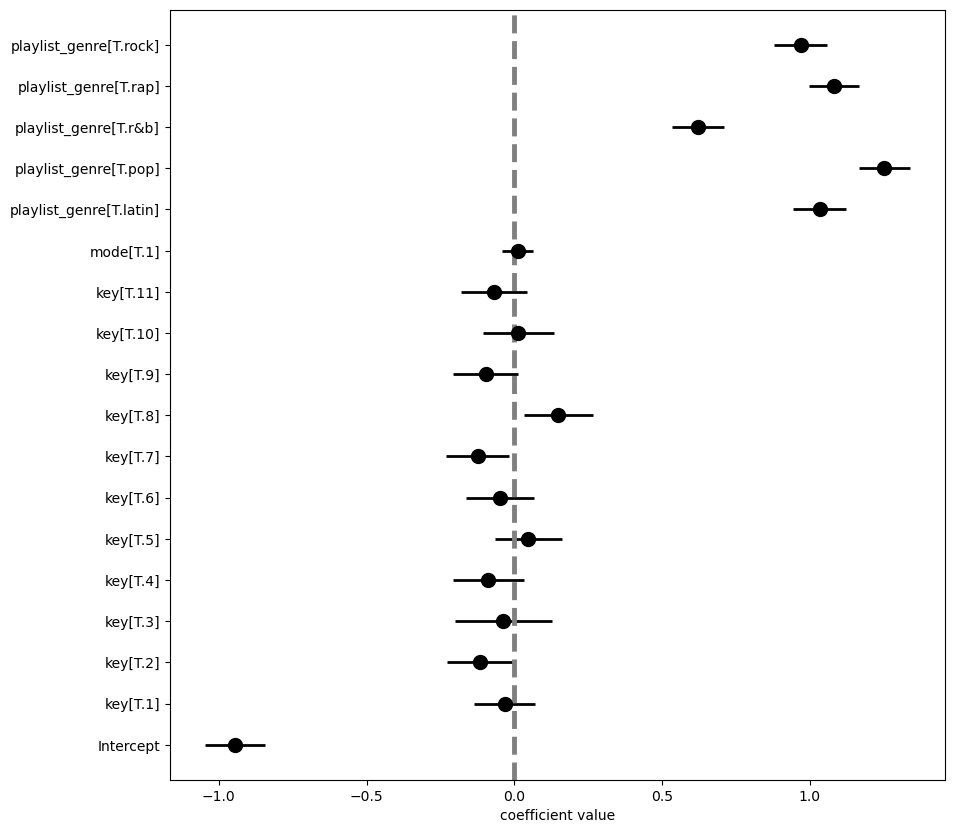

In [339]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [340]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


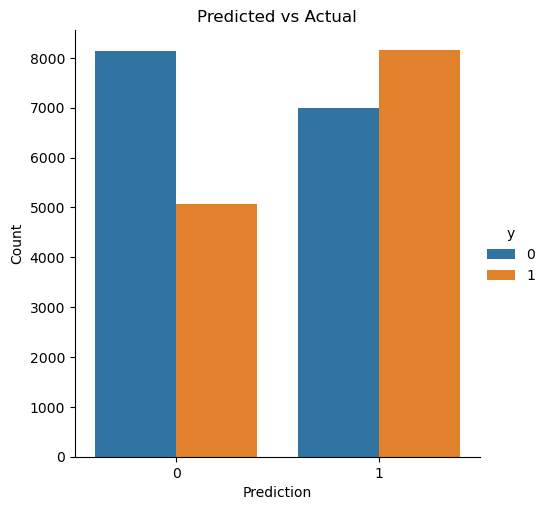

In [341]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

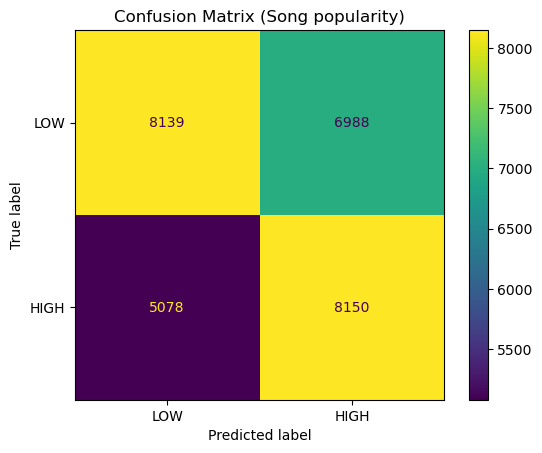

In [342]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [343]:
pred = fit_and_assess_logistic(2, formula_list[1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.669858
         Iterations 5


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,2,y ~ key + mode + playlist_genre,18,0.5,0.574467,0.616117,0.538045,0.461955,0.608519


In [344]:
ROC = fit_logistic_make_roc(2, formula_list[1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.669858
         Iterations 5


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


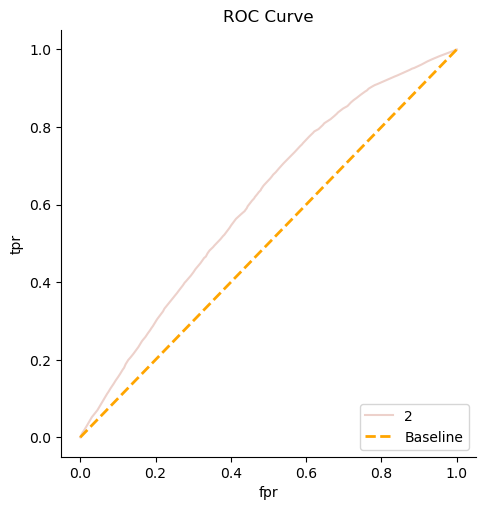

In [345]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

### Model 3:  Continous inputs with linear additive features

First let's fit the model

In [346]:
fit_model = smf.logit(formula=formula_list[2], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.678538
         Iterations 4


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28348
Method:                           MLE   Df Model:                            6
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.01790
Time:                        11:19:30   Log-Likelihood:                -19240.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                3.390e-148
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept       -0.1383      0.012    -11.471      0.000      -0.162      -0.115
danceability    -0.0099      0.013     -0.753      0.451      -0.036       0.016
energy          -0.1259      0.015     -8.557      0.000      -0.155      -0.097
acousticness     0.1313      0.014      9.114      0.000       0.103       0.159
liveness        -0.0292      0.012     -2.367      0.018      -0.053      -0.005
valence          0.0648      0.013      4.905      0.000       0.039       0.091
duration_ms     -0.2071      0.013    -16.418      0.000      -0.232      -0.182
================================================================================
"""

i.	How many coefficients were estimated?

In [347]:
fit_model.params.shape[0]

7

Standard error on mean for each coefficient

In [348]:
fit_model.bse

Intercept       0.012057
danceability    0.013159
energy          0.014715
acousticness    0.014401
liveness        0.012337
valence         0.013218
duration_ms     0.012613
dtype: float64

Confidence intervals

In [349]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.161931,-0.114669
danceability,-0.035701,0.015883
energy,-0.154753,-0.097073
acousticness,0.103032,0.159483
liveness,-0.053385,-0.005023
valence,0.038931,0.090746
duration_ms,-0.231794,-0.182353


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [350]:
fit_model.pvalues 

Intercept       1.850974e-30
danceability    4.514445e-01
energy          1.157880e-17
acousticness    7.916931e-20
liveness        1.792668e-02
valence         9.330087e-07
duration_ms     1.422456e-60
dtype: float64

In [351]:
fit_model.pvalues < 0.05

Intercept        True
danceability    False
energy           True
acousticness     True
liveness         True
valence          True
duration_ms      True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [352]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept       NEGATIVE
energy          NEGATIVE
acousticness    POSITIVE
liveness        NEGATIVE
valence         POSITIVE
duration_ms     NEGATIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [353]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

duration_ms    -0.207073
Intercept      -0.138300
acousticness    0.131257
energy         -0.125913
valence         0.064839
liveness       -0.029204
dtype: float64

In [354]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

duration_ms   -0.207073
Intercept     -0.138300
dtype: float64

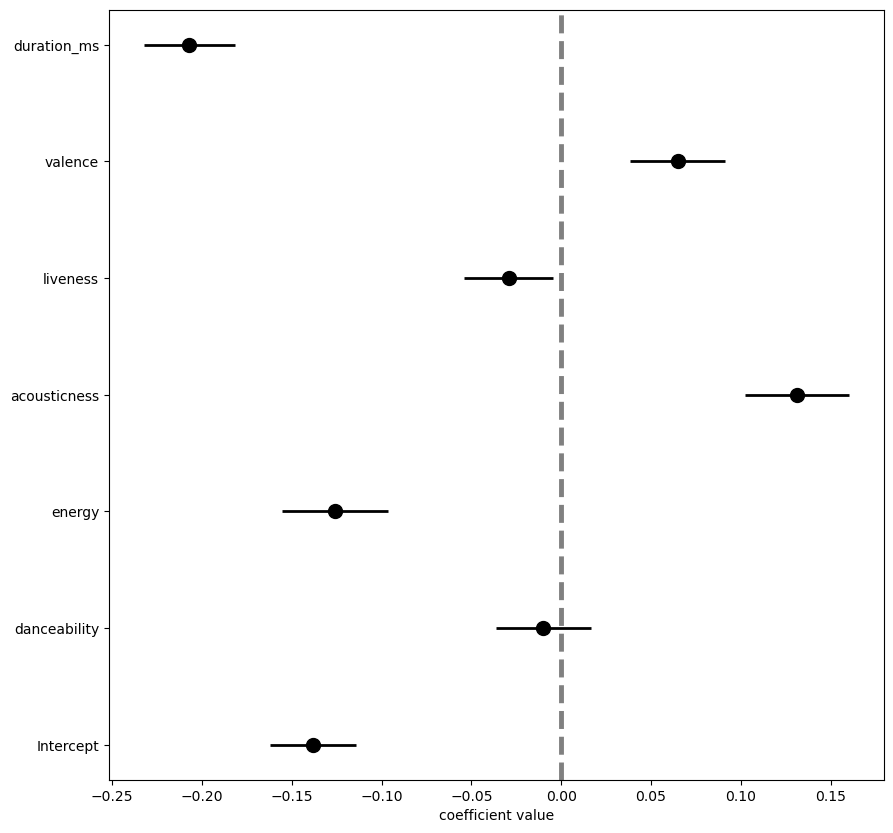

In [355]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [356]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


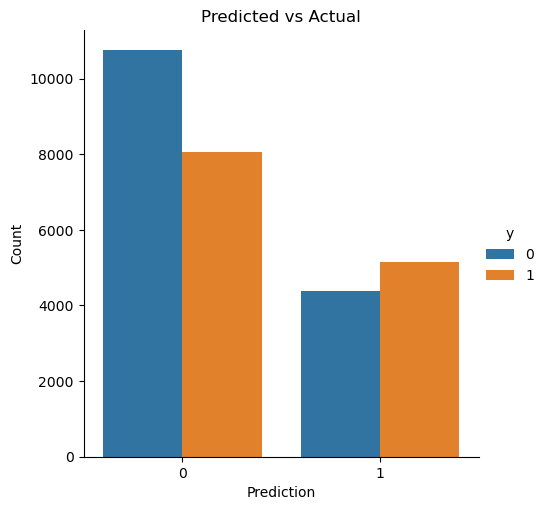

In [357]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

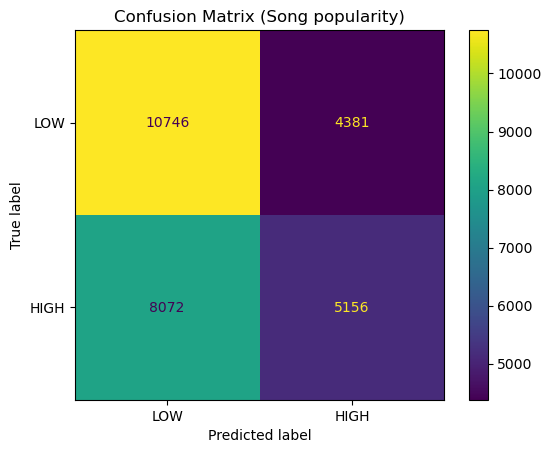

In [358]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [359]:
pred = fit_and_assess_logistic(3, formula_list[2], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.678538
         Iterations 4


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,3,y ~ danceability + energy + acousticness + liv...,7,0.5,0.560818,0.389779,0.710385,0.289615,0.586903


In [360]:
ROC = fit_logistic_make_roc(3, formula_list[2], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.678538
         Iterations 4


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


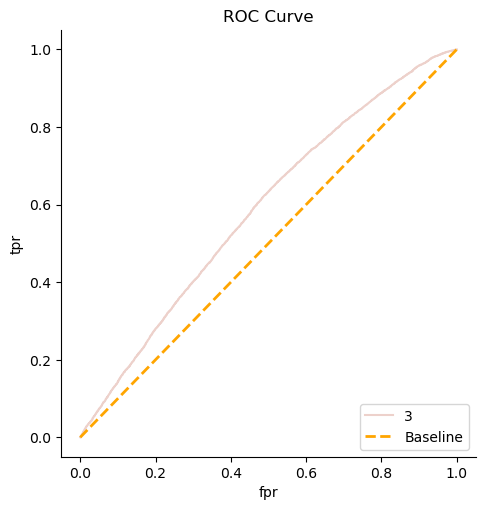

In [361]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

### Model 4: All inputs with linear additive features

First let's fit the model

In [362]:
fit_model = smf.logit(formula=formula_list[4-1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28331
Method:                           MLE   Df Model:                           23
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.04254
Time:                        11:19:33   Log-Likelihood:                -18757.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                     0.000
===========================================================================================
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                  -0.8899      0.053    -16.890      0.000      -0.993      -0.787
key[T.1]                   -0.0044      0.052     -0.085      0.932      -0.106       0.097
key[T.2]                   -0.0857      0.056     -1.527      0.127      -0.196       0.024
key[T.3]                   -0.0463      0.083     -0.559      0.576      -0.208       0.116
key[T.4]                   -0.0714      0.061     -1.171      0.242      -0.191       0.048
key[T.5]                    0.0642      0.058      1.112      0.266      -0.049       0.177
key[T.6]                   -0.0014      0.058     -0.024      0.981      -0.115       0.112
key[T.7]                   -0.0931      0.054     -1.731      0.083      -0.198       0.012
key[T.8]                    0.1608      0.059      2.724      0.006       0.045       0.277
key[T.9]                   -0.0768      0.055     -1.390      0.164      -0.185       0.031
key[T.10]                   0.0318      0.061      0.524      0.600      -0.087       0.151
key[T.11]                  -0.0259      0.056     -0.461      0.645      -0.136       0.084
mode[T.1]                   0.0107      0.026      0.407      0.684      -0.041       0.062
playlist_genre[T.latin]     0.8751      0.048     18.245      0.000       0.781       0.969
playlist_genre[T.pop]       1.1562      0.045     25.741      0.000       1.068       1.244
playlist_genre[T.r&b]       0.4865      0.049      9.863      0.000       0.390       0.583
playlist_genre[T.rap]       0.8874      0.045     19.652      0.000       0.799       0.976
playlist_genre[T.rock]      1.0891      0.050     21.742      0.000       0.991       1.187
danceability                0.0738      0.015      4.893      0.000       0.044       0.103
energy                     -0.0658      0.016     -4.171      0.000      -0.097      -0.035
acousticness                0.1228      0.015      8.238      0.000       0.094       0.152
liveness                   -0.0191      0.013     -1.509      0.131      -0.044       0.006
valence                    -0.0306      0.014     -2.136      0.033      -0.059      -0.003
duration_ms                -0.2015      0.013    -15.306      0.000      -0.227      -0.176
===========================================================================================
"""

i.	How many coefficients were estimated?

In [363]:
fit_model.params.shape[0]

24

Standard error on mean for each coefficient

In [364]:
fit_model.bse

Intercept                  0.052684
key[T.1]                   0.051824
key[T.2]                   0.056102
key[T.3]                   0.082745
key[T.4]                   0.060992
key[T.5]                   0.057733
key[T.6]                   0.058047
key[T.7]                   0.053765
key[T.8]                   0.059027
key[T.9]                   0.055240
key[T.10]                  0.060586
key[T.11]                  0.056280
mode[T.1]                  0.026179
playlist_genre[T.latin]    0.047962
playlist_genre[T.pop]      0.044917
playlist_genre[T.r&b]      0.049332
playlist_genre[T.rap]      0.045158
playlist_genre[T.rock]     0.050089
danceability               0.015076
energy                     0.015778
acousticness               0.014903
liveness                   0.012627
valence                    0.014346
duration_ms                0.013165
dtype: float64

Confidence intervals

In [365]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.993111,-0.786592
key[T.1],-0.105985,0.097161
key[T.2],-0.195650,0.024264
key[T.3],-0.208466,0.115888
key[T.4],-0.190952,0.048132
key[T.5],-0.048960,0.177348
key[T.6],-0.115139,0.112399
key[T.7],-0.198447,0.012309
key[T.8],0.045122,0.276504
key[T.9],-0.185073,0.031466


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [366]:
fit_model.pvalues 

Intercept                   5.311354e-64
key[T.1]                    9.321554e-01
key[T.2]                    1.266446e-01
key[T.3]                    5.758774e-01
key[T.4]                    2.416757e-01
key[T.5]                    2.661756e-01
key[T.6]                    9.811699e-01
key[T.7]                    8.344626e-02
key[T.8]                    6.442023e-03
key[T.9]                    1.644217e-01
key[T.10]                   6.000987e-01
key[T.11]                   6.447733e-01
mode[T.1]                   6.836952e-01
playlist_genre[T.latin]     2.249270e-74
playlist_genre[T.pop]      4.099209e-146
playlist_genre[T.r&b]       6.031687e-23
playlist_genre[T.rap]       5.560140e-86
playlist_genre[T.rock]     8.168614e-105
danceability                9.914525e-07
energy                      3.036658e-05
acousticness                1.753231e-16
liveness                    1.313078e-01
valence                     3.266089e-02
duration_ms                 6.974128e-53
dtype: float64

In [367]:
fit_model.pvalues < 0.05

Intercept                   True
key[T.1]                   False
key[T.2]                   False
key[T.3]                   False
key[T.4]                   False
key[T.5]                   False
key[T.6]                   False
key[T.7]                   False
key[T.8]                    True
key[T.9]                   False
key[T.10]                  False
key[T.11]                  False
mode[T.1]                  False
playlist_genre[T.latin]     True
playlist_genre[T.pop]       True
playlist_genre[T.r&b]       True
playlist_genre[T.rap]       True
playlist_genre[T.rock]      True
danceability                True
energy                      True
acousticness                True
liveness                   False
valence                     True
duration_ms                 True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [368]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept                  NEGATIVE
key[T.8]                   POSITIVE
playlist_genre[T.latin]    POSITIVE
playlist_genre[T.pop]      POSITIVE
playlist_genre[T.r&b]      POSITIVE
playlist_genre[T.rap]      POSITIVE
playlist_genre[T.rock]     POSITIVE
danceability               POSITIVE
energy                     NEGATIVE
acousticness               POSITIVE
valence                    NEGATIVE
duration_ms                NEGATIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [369]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

playlist_genre[T.pop]      1.156200
playlist_genre[T.rock]     1.089056
Intercept                 -0.889852
playlist_genre[T.rap]      0.887439
playlist_genre[T.latin]    0.875088
playlist_genre[T.r&b]      0.486549
duration_ms               -0.201505
key[T.8]                   0.160813
acousticness               0.122771
danceability               0.073770
energy                    -0.065805
valence                   -0.030647
dtype: float64

In [370]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

playlist_genre[T.pop]     1.156200
playlist_genre[T.rock]    1.089056
dtype: float64

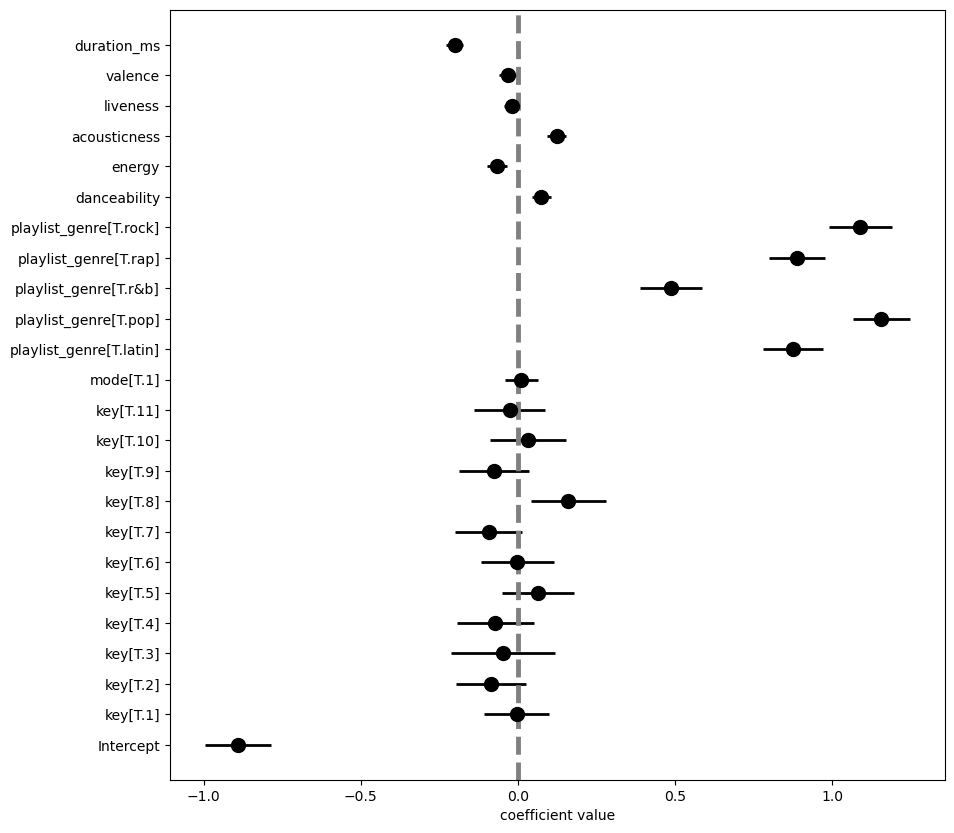

In [371]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [372]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


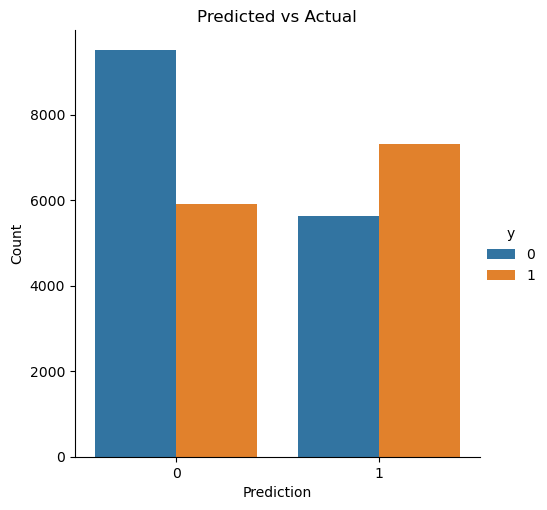

In [373]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

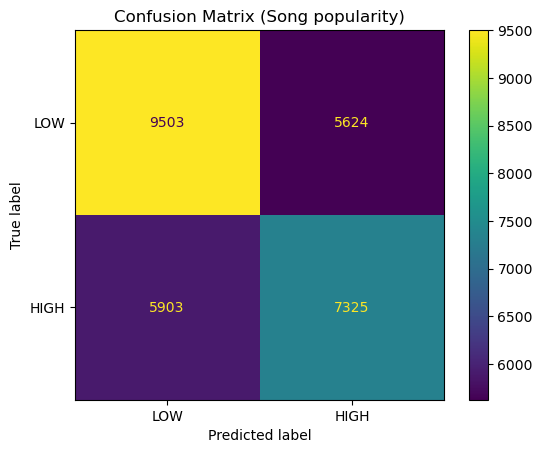

In [374]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [375]:
pred = fit_and_assess_logistic(4, formula_list[4-1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,4,y ~ key + mode + playlist_genre + danceability...,24,0.5,0.593476,0.55375,0.628214,0.371786,0.631902


In [376]:
ROC = fit_logistic_make_roc(4, formula_list[4-1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


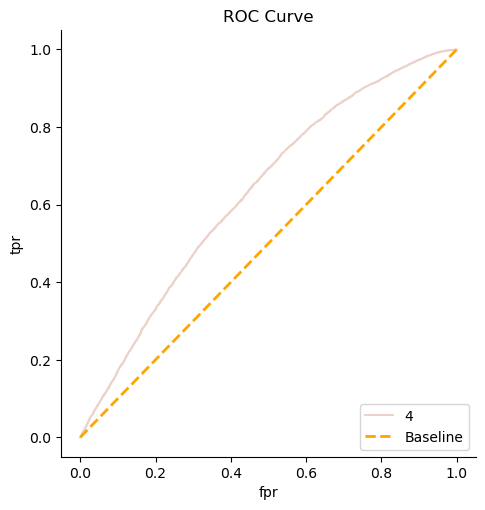

In [377]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

### Model 5: Continous inputs with linear main effect and pair-wise interactions

First let's fit the model

In [378]:
fit_model = smf.logit(formula=formula_list[5-1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.673991
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28333
Method:                           MLE   Df Model:                           21
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.02448
Time:                        11:19:36   Log-Likelihood:                -19111.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                1.456e-189
=============================================================================================
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept                    -0.1337      0.015     -8.839      0.000      -0.163      -0.104
danceability                 -0.0004      0.014     -0.026      0.979      -0.028       0.027
energy                       -0.1238      0.015     -8.164      0.000      -0.153      -0.094
acousticness                  0.1387      0.015      9.269      0.000       0.109       0.168
liveness                     -0.0317      0.013     -2.465      0.014      -0.057      -0.007
valence                       0.0525      0.014      3.863      0.000       0.026       0.079
duration_ms                  -0.2101      0.013    -16.050      0.000      -0.236      -0.184
danceability:energy          -0.0423      0.016     -2.704      0.007      -0.073      -0.012
danceability:acousticness     0.0999      0.015      6.596      0.000       0.070       0.130
danceability:liveness         0.0479      0.013      3.621      0.000       0.022       0.074
danceability:valence          0.0151      0.013      1.152      0.250      -0.011       0.041
danceability:duration_ms     -0.0727      0.012     -5.914      0.000      -0.097      -0.049
energy:acousticness           0.0472      0.013      3.675      0.000       0.022       0.072
energy:liveness               0.0041      0.015      0.277      0.782      -0.025       0.033
energy:valence                0.0674      0.015      4.440      0.000       0.038       0.097
energy:duration_ms            0.0054      0.015      0.362      0.718      -0.024       0.035
acousticness:liveness         0.0040      0.015      0.270      0.787      -0.025       0.033
acousticness:valence         -0.0837      0.015     -5.451      0.000      -0.114      -0.054
acousticness:duration_ms      0.0489      0.014      3.399      0.001       0.021       0.077
liveness:valence              0.0056      0.014      0.410      0.682      -0.021       0.033
liveness:duration_ms          0.0393      0.013      3.089      0.002       0.014       0.064
valence:duration_ms          -0.0136      0.013     -1.027      0.305      -0.040       0.012
=============================================================================================
"""

i.	How many coefficients were estimated?

In [379]:
fit_model.params.shape[0]

22

Standard error on mean for each coefficient

In [380]:
fit_model.bse

Intercept                    0.015129
danceability                 0.013947
energy                       0.015159
acousticness                 0.014967
liveness                     0.012875
valence                      0.013593
duration_ms                  0.013088
danceability:energy          0.015653
danceability:acousticness    0.015149
danceability:liveness        0.013234
danceability:valence         0.013147
danceability:duration_ms     0.012288
energy:acousticness          0.012854
energy:liveness              0.014740
energy:valence               0.015182
energy:duration_ms           0.014889
acousticness:liveness        0.014751
acousticness:valence         0.015361
acousticness:duration_ms     0.014392
liveness:valence             0.013732
liveness:duration_ms         0.012709
valence:duration_ms          0.013229
dtype: float64

Confidence intervals

In [381]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.163386,-0.104081
danceability,-0.027695,0.026976
energy,-0.153467,-0.094044
acousticness,0.109393,0.168063
liveness,-0.056971,-0.006502
valence,0.025863,0.079147
duration_ms,-0.235715,-0.184412
danceability:energy,-0.073011,-0.011653
danceability:acousticness,0.070238,0.129622
danceability:liveness,0.021977,0.073853


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [382]:
fit_model.pvalues 

Intercept                    9.623576e-19
danceability                 9.794457e-01
energy                       3.246671e-16
acousticness                 1.883103e-20
liveness                     1.370125e-02
valence                      1.121853e-04
duration_ms                  5.675731e-58
danceability:energy          6.841554e-03
danceability:acousticness    4.211998e-11
danceability:liveness        2.938709e-04
danceability:valence         2.495003e-01
danceability:duration_ms     3.345299e-09
energy:acousticness          2.375026e-04
energy:liveness              7.817913e-01
energy:valence               8.998898e-06
energy:duration_ms           7.176742e-01
acousticness:liveness        7.874419e-01
acousticness:valence         5.006567e-08
acousticness:duration_ms     6.765027e-04
liveness:valence             6.817071e-01
liveness:duration_ms         2.010214e-03
valence:duration_ms          3.045872e-01
dtype: float64

In [383]:
fit_model.pvalues < 0.05

Intercept                     True
danceability                 False
energy                        True
acousticness                  True
liveness                      True
valence                       True
duration_ms                   True
danceability:energy           True
danceability:acousticness     True
danceability:liveness         True
danceability:valence         False
danceability:duration_ms      True
energy:acousticness           True
energy:liveness              False
energy:valence                True
energy:duration_ms           False
acousticness:liveness        False
acousticness:valence          True
acousticness:duration_ms      True
liveness:valence             False
liveness:duration_ms          True
valence:duration_ms          False
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [384]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept                    NEGATIVE
energy                       NEGATIVE
acousticness                 POSITIVE
liveness                     NEGATIVE
valence                      POSITIVE
duration_ms                  NEGATIVE
danceability:energy          NEGATIVE
danceability:acousticness    POSITIVE
danceability:liveness        POSITIVE
danceability:duration_ms     NEGATIVE
energy:acousticness          POSITIVE
energy:valence               POSITIVE
acousticness:valence         NEGATIVE
acousticness:duration_ms     POSITIVE
liveness:duration_ms         POSITIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [385]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

duration_ms                 -0.210064
acousticness                 0.138728
Intercept                   -0.133733
energy                      -0.123756
danceability:acousticness    0.099930
acousticness:valence        -0.083732
danceability:duration_ms    -0.072670
energy:valence               0.067409
valence                      0.052505
acousticness:duration_ms     0.048916
danceability:liveness        0.047915
energy:acousticness          0.047242
danceability:energy         -0.042332
liveness:duration_ms         0.039255
liveness                    -0.031737
dtype: float64

In [386]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

duration_ms    -0.210064
acousticness    0.138728
dtype: float64

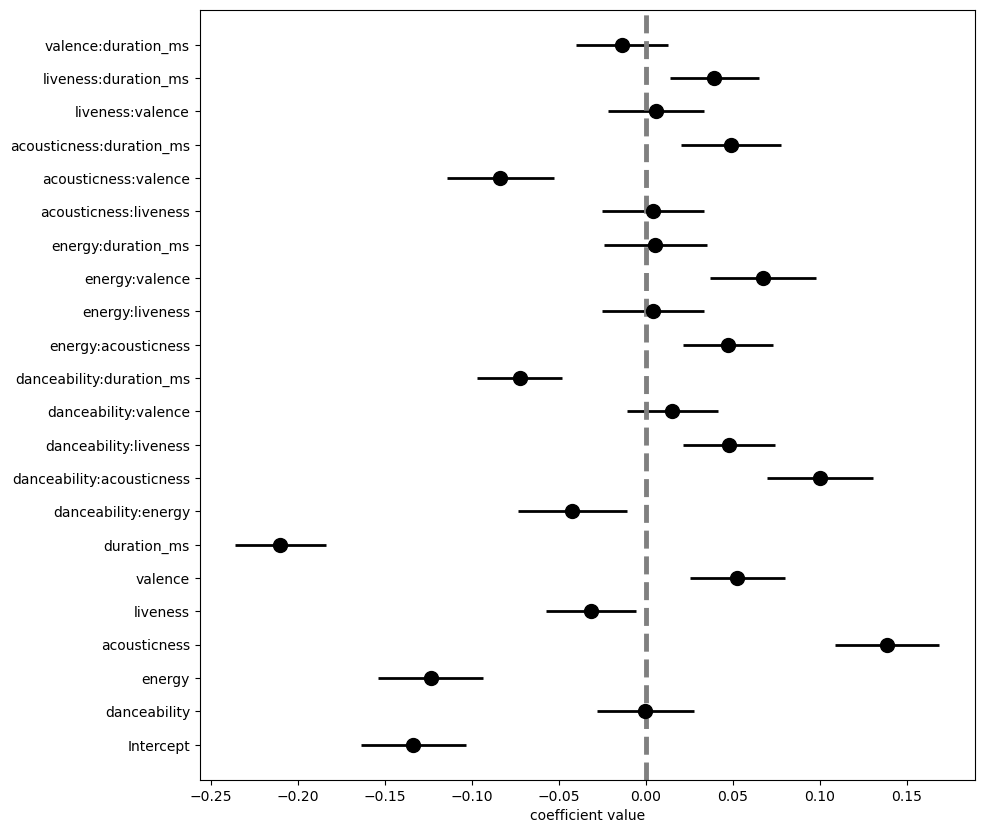

In [387]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [388]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


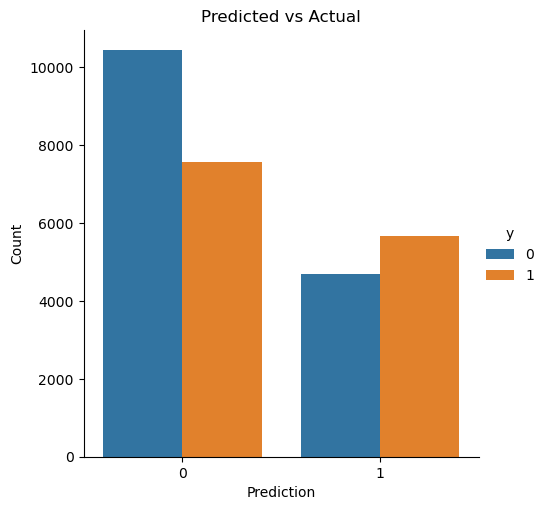

In [389]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

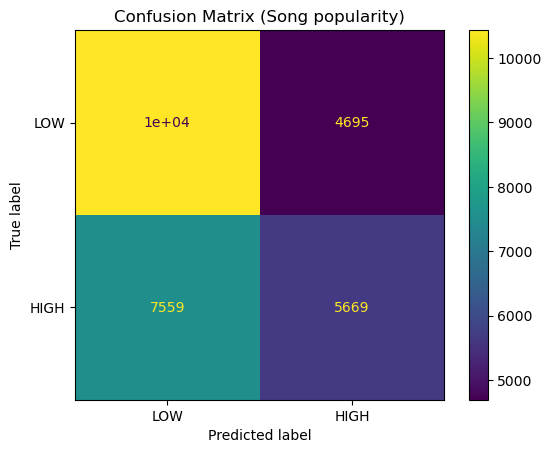

In [390]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [391]:
pred = fit_and_assess_logistic(5, formula_list[5-1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.673991
         Iterations 5


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,5,y ~ (danceability + energy + acousticness + li...,22,0.5,0.567836,0.428561,0.689628,0.310372,0.597698


In [392]:
ROC = fit_logistic_make_roc(5, formula_list[5-1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.673991
         Iterations 5


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


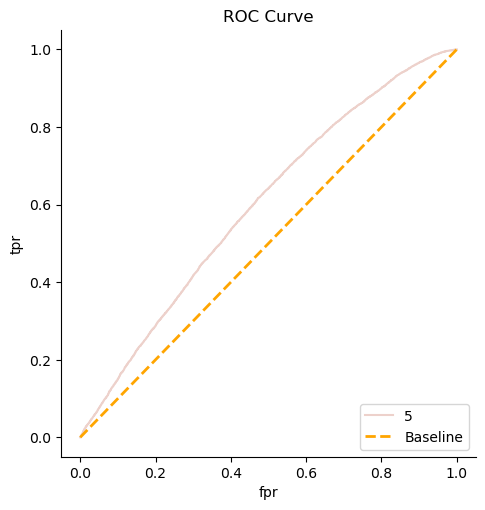

In [393]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

### Model 6: Interaction of categorical inputs with continous inputs 

First let's fit the model

In [394]:
fit_model = smf.logit(formula=formula_list[6-1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28229
Method:                           MLE   Df Model:                          125
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.05318
Time:                        11:19:39   Log-Likelihood:                -18549.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                     0.000
========================================================================================================
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
Intercept                               -0.8276      0.060    -13.757      0.000      -0.946      -0.710
key[T.1]                                -0.0026      0.053     -0.049      0.961      -0.107       0.102
key[T.2]                                -0.0726      0.057     -1.273      0.203      -0.184       0.039
key[T.3]                                -0.0395      0.088     -0.448      0.654      -0.212       0.133
key[T.4]                                -0.0800      0.063     -1.279      0.201      -0.203       0.043
key[T.5]                                 0.0597      0.059      1.013      0.311      -0.056       0.175
key[T.6]                                 0.0136      0.059      0.229      0.819      -0.102       0.130
key[T.7]                                -0.0872      0.055     -1.600      0.110      -0.194       0.020
key[T.8]                                 0.1612      0.060      2.677      0.007       0.043       0.279
key[T.9]                                -0.0750      0.057     -1.321      0.186      -0.186       0.036
key[T.10]                                0.0504      0.062      0.813      0.416      -0.071       0.172
key[T.11]                               -0.0272      0.058     -0.474      0.636      -0.140       0.085
mode[T.1]                                0.0157      0.027      0.583      0.560      -0.037       0.068
playlist_genre[T.latin]                  0.7516      0.059     12.759      0.000       0.636       0.867
playlist_genre[T.pop]                    1.0940      0.054     20.402      0.000       0.989       1.199
playlist_genre[T.r&b]                    0.4163      0.061      6.827      0.000       0.297       0.536
playlist_genre[T.rap]                    0.6958      0.056     12.518      0.000       0.587       0.805
playlist_genre[T.rock]                   0.8673      0.067     13.026      0.000       0.737       0.998
danceability                            -0.0234      0.062     -0.375      0.707      -0.146       0.099
key[T.1]:danceability                   -0.0398      0.058     -0.681      0.496      -0.154       0.075
key[T.2]:danceability                    0.0987      0.061      1.617      0.106      -0.021       0.218
key[T.3]:danceability                   -0.2123      0.091     -2.337      0.019      -0.390      -0.034
key[T.4]:danceability                   -0.0112      0.067     -0.167      0.867      -0.142       0.120
key[T.5]:danceability                    0.0112      0.066      0.168      0.867      -0.119       0.141
key[T.6]:danceability                    0.0087      0.066      0.131      0.896      -0.121       0.138
key[T.7]:danceability                   -0.0924      0.059     -1.556      0.120      -0.209       0.024
key[T.8]:danceability                   -0.0851      0.066     -1.285      0.199      -0.215       0.045
key[T.9]:danceability                    0.0112      0.061      0.183      0.855      -0.10

i.	How many coefficients were estimated?

In [395]:
fit_model.params.shape[0]

126

Standard error on mean for each coefficient

In [396]:
fit_model.bse

Intercept                              0.060161
key[T.1]                               0.053201
key[T.2]                               0.057018
key[T.3]                               0.088203
key[T.4]                               0.062566
                                         ...   
playlist_genre[T.latin]:duration_ms    0.052375
playlist_genre[T.pop]:duration_ms      0.051915
playlist_genre[T.r&b]:duration_ms      0.048146
playlist_genre[T.rap]:duration_ms      0.045960
playlist_genre[T.rock]:duration_ms     0.046118
Length: 126, dtype: float64

Confidence intervals

In [397]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.945547,-0.709721
key[T.1],-0.106870,0.101674
key[T.2],-0.184361,0.039147
key[T.3],-0.212393,0.133357
key[T.4],-0.202619,0.042636
...,...,...
playlist_genre[T.latin]:duration_ms,0.133820,0.339125
playlist_genre[T.pop]:duration_ms,-0.027808,0.175696
playlist_genre[T.r&b]:duration_ms,-0.020372,0.168358
playlist_genre[T.rap]:duration_ms,-0.036413,0.143747


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [398]:
fit_model.pvalues 

Intercept                              4.619877e-43
key[T.1]                               9.610476e-01
key[T.2]                               2.028770e-01
key[T.3]                               6.541277e-01
key[T.4]                               2.010721e-01
                                           ...     
playlist_genre[T.latin]:duration_ms    6.331213e-06
playlist_genre[T.pop]:duration_ms      1.543532e-01
playlist_genre[T.r&b]:duration_ms      1.243336e-01
playlist_genre[T.rap]:duration_ms      2.429330e-01
playlist_genre[T.rock]:duration_ms     2.015966e-10
Length: 126, dtype: float64

In [399]:
fit_model.pvalues < 0.05

Intercept                               True
key[T.1]                               False
key[T.2]                               False
key[T.3]                               False
key[T.4]                               False
                                       ...  
playlist_genre[T.latin]:duration_ms     True
playlist_genre[T.pop]:duration_ms      False
playlist_genre[T.r&b]:duration_ms      False
playlist_genre[T.rap]:duration_ms      False
playlist_genre[T.rock]:duration_ms      True
Length: 126, dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [400]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept                               NEGATIVE
key[T.8]                                POSITIVE
playlist_genre[T.latin]                 POSITIVE
playlist_genre[T.pop]                   POSITIVE
playlist_genre[T.r&b]                   POSITIVE
playlist_genre[T.rap]                   POSITIVE
playlist_genre[T.rock]                  POSITIVE
key[T.3]:danceability                   NEGATIVE
playlist_genre[T.latin]:danceability    POSITIVE
playlist_genre[T.pop]:danceability      POSITIVE
playlist_genre[T.rap]:danceability      POSITIVE
mode[T.1]:energy                        NEGATIVE
acousticness                            POSITIVE
key[T.3]:acousticness                   NEGATIVE
playlist_genre[T.pop]:acousticness      NEGATIVE
playlist_genre[T.r&b]:acousticness      NEGATIVE
playlist_genre[T.rap]:acousticness      NEGATIVE
playlist_genre[T.rock]:acousticness     NEGATIVE
mode[T.1]:liveness                      POSITIVE
playlist_genre[T.rock]:liveness         NEGATIVE
key[T.3]:valence    

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [401]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

playlist_genre[T.pop]                   1.093980
playlist_genre[T.rock]                  0.867280
Intercept                              -0.827634
playlist_genre[T.latin]                 0.751582
playlist_genre[T.rap]                   0.695848
playlist_genre[T.r&b]                   0.416313
playlist_genre[T.rock]:acousticness    -0.365386
playlist_genre[T.rap]:danceability      0.343383
acousticness                            0.318494
playlist_genre[T.rock]:duration_ms      0.293313
key[T.3]:acousticness                  -0.244917
playlist_genre[T.pop]:acousticness     -0.240107
playlist_genre[T.r&b]:valence          -0.239467
playlist_genre[T.latin]:duration_ms     0.236472
key[T.3]:valence                        0.220507
duration_ms                            -0.219633
key[T.3]:danceability                  -0.212341
key[T.11]:duration_ms                  -0.193086
key[T.9]:duration_ms                   -0.180609
playlist_genre[T.pop]:danceability      0.173176
key[T.5]:duration_ms

In [402]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

playlist_genre[T.pop]     1.09398
playlist_genre[T.rock]    0.86728
dtype: float64

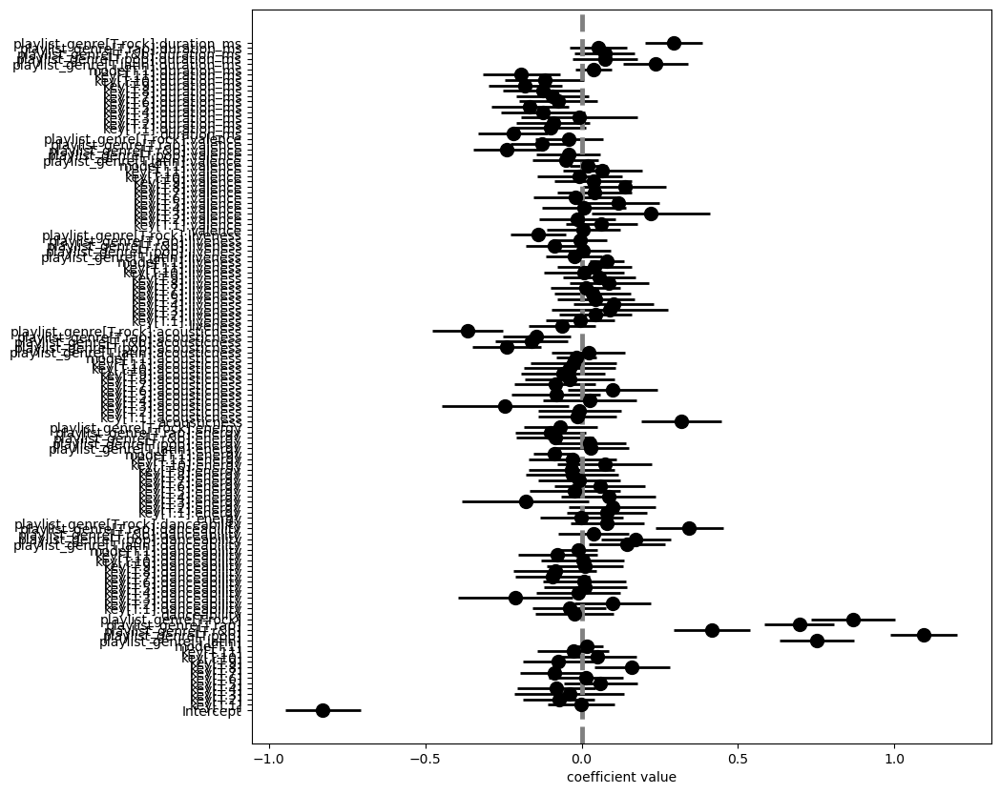

In [403]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [404]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


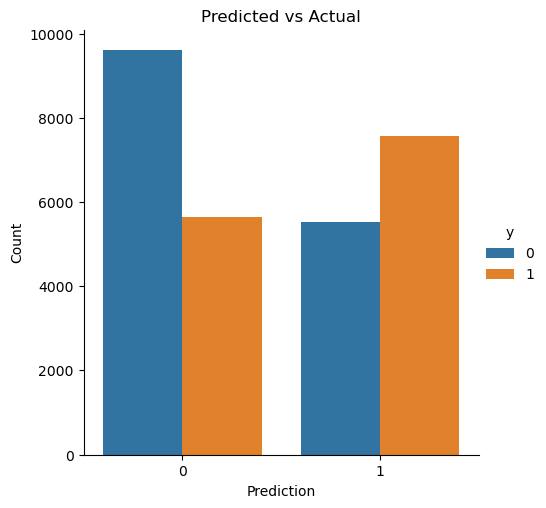

In [405]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

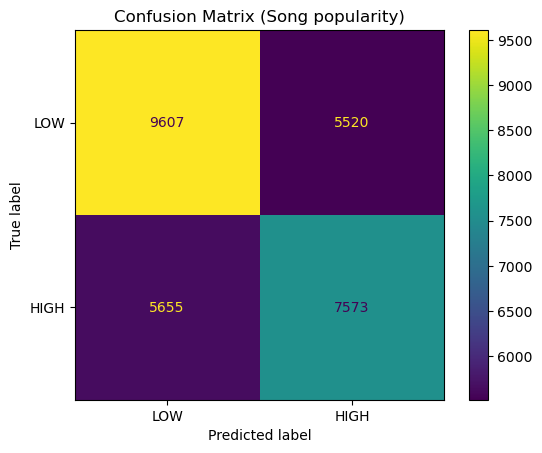

In [406]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [407]:
pred = fit_and_assess_logistic(6, formula_list[6-1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5,0.60589,0.572498,0.63509,0.36491,0.64819


In [408]:
ROC = fit_logistic_make_roc(6, formula_list[6-1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


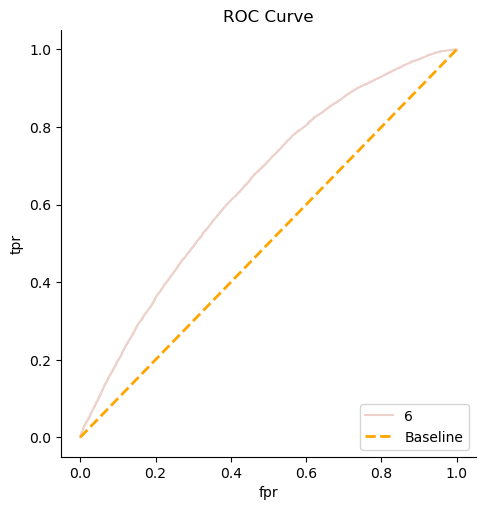

In [409]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

### Model 7: Linear Categorical Additive and continous additive features (key, mode, energy and acousticness)

First let's fit the model

In [410]:
fit_model = smf.logit(formula=formula_list[7-1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.683423
         Iterations 4


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28340
Method:                           MLE   Df Model:                           14
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.01083
Time:                        11:19:41   Log-Likelihood:                -19378.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                 9.973e-82
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept       -0.1437      0.041     -3.481      0.000      -0.225      -0.063
key[T.1]        -0.0113      0.050     -0.224      0.823      -0.110       0.088
key[T.2]        -0.1000      0.055     -1.821      0.069      -0.208       0.008
key[T.3]        -0.0723      0.081     -0.894      0.371      -0.231       0.086
key[T.4]        -0.0532      0.060     -0.892      0.372      -0.170       0.064
key[T.5]         0.0116      0.056      0.206      0.837      -0.099       0.122
key[T.6]        -0.0243      0.057     -0.429      0.668      -0.135       0.087
key[T.7]        -0.1170      0.053     -2.225      0.026      -0.220      -0.014
key[T.8]         0.1467      0.058      2.545      0.011       0.034       0.260
key[T.9]        -0.0646      0.054     -1.194      0.233      -0.171       0.041
key[T.10]        0.0287      0.059      0.485      0.628      -0.087       0.145
key[T.11]       -0.0404      0.055     -0.735      0.462      -0.148       0.067
mode[T.1]        0.0591      0.025      2.324      0.020       0.009       0.109
energy          -0.1001      0.014     -7.137      0.000      -0.128      -0.073
acousticness     0.1685      0.014     11.982      0.000       0.141       0.196
================================================================================
"""

i.	How many coefficients were estimated?

In [411]:
fit_model.params.shape[0]

15

Standard error on mean for each coefficient

In [412]:
fit_model.bse

Intercept       0.041290
key[T.1]        0.050463
key[T.2]        0.054891
key[T.3]        0.080873
key[T.4]        0.059678
key[T.5]        0.056407
key[T.6]        0.056697
key[T.7]        0.052600
key[T.8]        0.057640
key[T.9]        0.054128
key[T.10]       0.059203
key[T.11]       0.055011
mode[T.1]       0.025439
energy          0.014020
acousticness    0.014066
dtype: float64

Confidence intervals

In [413]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.224666,-0.062814
key[T.1],-0.110223,0.087587
key[T.2],-0.207556,0.007612
key[T.3],-0.230789,0.086230
key[T.4],-0.170204,0.063729
key[T.5],-0.098942,0.122169
key[T.6],-0.135420,0.086827
key[T.7],-0.220128,-0.013940
key[T.8],0.033709,0.259652
key[T.9],-0.170698,0.041479


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [414]:
fit_model.pvalues 

Intercept       4.990359e-04
key[T.1]        8.225348e-01
key[T.2]        6.856357e-02
key[T.3]        3.714640e-01
key[T.4]        3.723496e-01
key[T.5]        8.368818e-01
key[T.6]        6.682600e-01
key[T.7]        2.608188e-02
key[T.8]        1.093474e-02
key[T.9]        2.326158e-01
key[T.10]       6.275855e-01
key[T.11]       4.624659e-01
mode[T.1]       2.012930e-02
energy          9.523633e-13
acousticness    4.393476e-33
dtype: float64

In [415]:
fit_model.pvalues < 0.05

Intercept        True
key[T.1]        False
key[T.2]        False
key[T.3]        False
key[T.4]        False
key[T.5]        False
key[T.6]        False
key[T.7]         True
key[T.8]         True
key[T.9]        False
key[T.10]       False
key[T.11]       False
mode[T.1]        True
energy           True
acousticness     True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [416]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept       NEGATIVE
key[T.7]        NEGATIVE
key[T.8]        POSITIVE
mode[T.1]       POSITIVE
energy          NEGATIVE
acousticness    POSITIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [417]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

acousticness    0.168548
key[T.8]        0.146681
Intercept      -0.143740
key[T.7]       -0.117034
energy         -0.100062
mode[T.1]       0.059119
dtype: float64

In [418]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

acousticness    0.168548
key[T.8]        0.146681
dtype: float64

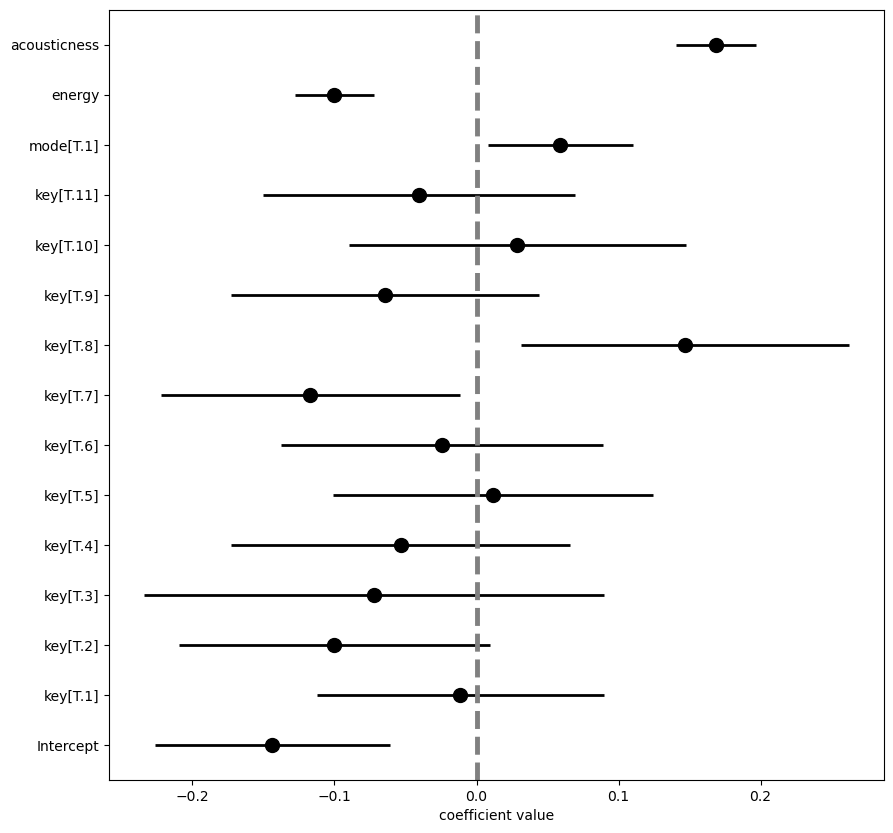

In [419]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [420]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


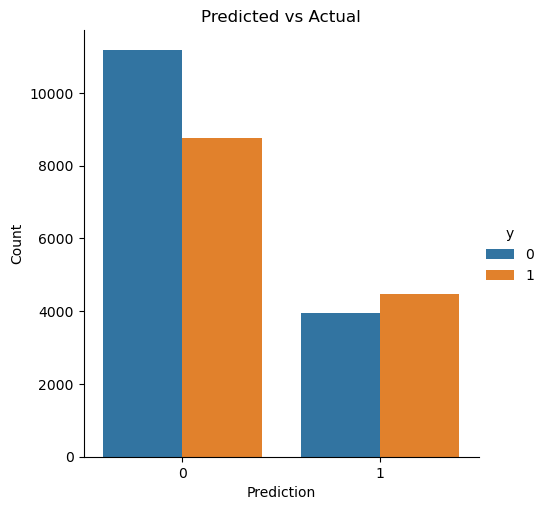

In [421]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

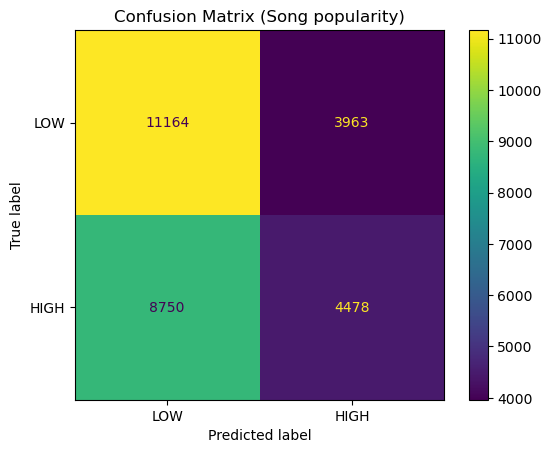

In [422]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [423]:
pred = fit_and_assess_logistic(7, formula_list[7-1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.683423
         Iterations 4


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,7,y ~ (key + mode) + (energy + acousticness),15,0.5,0.551649,0.338524,0.738018,0.261982,0.571017


In [424]:
ROC = fit_logistic_make_roc(7, formula_list[7-1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.683423
         Iterations 4


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


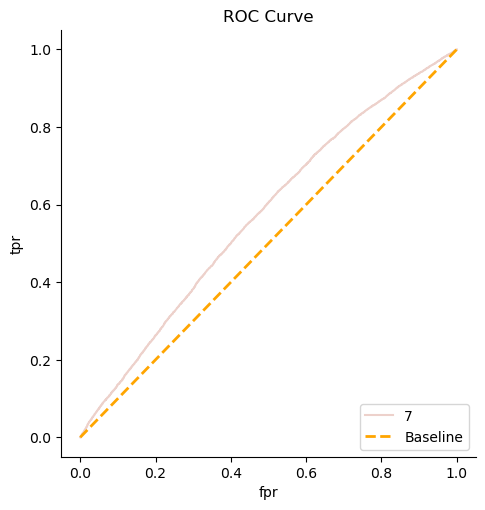

In [425]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

Model choice seems to be worse than the other ones. Let's look at another model choice based on the EDA.

### Model 8: Interactive categorical features with with linear additive feature (playlist_genre, danceability and valence)

First let's fit the model

In [426]:
fit_model = smf.logit(formula=formula_list[8-1], data=df_modelling).fit()
fit_model.summary()

Optimization terminated successfully.
         Current function value: 0.666499
         Iterations 5


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                28355
Model:                          Logit   Df Residuals:                    28337
Method:                           MLE   Df Model:                           17
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:                 0.03532
Time:                        11:19:43   Log-Likelihood:                -18899.
converged:                       True   LL-Null:                       -19591.
Covariance Type:            nonrobust   LLR p-value:                4.336e-284
========================================================================================================
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
Intercept                               -0.8948      0.036    -25.073      0.000      -0.965      -0.825
playlist_genre[T.latin]                  0.9173      0.050     18.169      0.000       0.818       1.016
playlist_genre[T.pop]                    1.1907      0.046     26.063      0.000       1.101       1.280
playlist_genre[T.r&b]                    0.5693      0.047     12.108      0.000       0.477       0.662
playlist_genre[T.rap]                    0.8655      0.047     18.412      0.000       0.773       0.958
playlist_genre[T.rock]                   0.9500      0.059     16.061      0.000       0.834       1.066
danceability                            -0.1295      0.041     -3.169      0.002      -0.210      -0.049
playlist_genre[T.latin]:danceability     0.1883      0.058      3.239      0.001       0.074       0.302
playlist_genre[T.pop]:danceability       0.2742      0.053      5.137      0.000       0.170       0.379
playlist_genre[T.r&b]:danceability       0.1055      0.054      1.956      0.050      -0.000       0.211
playlist_genre[T.rap]:danceability       0.4455      0.051      8.688      0.000       0.345       0.546
playlist_genre[T.rock]:danceability      0.2060      0.055      3.740      0.000       0.098       0.314
valence                                  0.1654      0.036      4.652      0.000       0.096       0.235
playlist_genre[T.latin]:valence         -0.1344      0.050     -2.713      0.007      -0.232      -0.037
playlist_genre[T.pop]:valence           -0.1461      0.048     -3.051      0.002      -0.240      -0.052
playlist_genre[T.r&b]:valence           -0.4019      0.050     -8.082      0.000      -0.499      -0.304
playlist_genre[T.rap]:valence           -0.2883      0.046     -6.222      0.000      -0.379      -0.197
playlist_genre[T.rock]:valence          -0.1891      0.051     -3.731      0.000      -0.288      -0.090
========================================================================================================
"""

i.	How many coefficients were estimated?

In [427]:
fit_model.params.shape[0]

18

Standard error on mean for each coefficient

In [428]:
fit_model.bse

Intercept                               0.035687
playlist_genre[T.latin]                 0.050487
playlist_genre[T.pop]                   0.045685
playlist_genre[T.r&b]                   0.047023
playlist_genre[T.rap]                   0.047006
playlist_genre[T.rock]                  0.059149
danceability                            0.040873
playlist_genre[T.latin]:danceability    0.058148
playlist_genre[T.pop]:danceability      0.053376
playlist_genre[T.r&b]:danceability      0.053920
playlist_genre[T.rap]:danceability      0.051280
playlist_genre[T.rock]:danceability     0.055069
valence                                 0.035552
playlist_genre[T.latin]:valence         0.049557
playlist_genre[T.pop]:valence           0.047888
playlist_genre[T.r&b]:valence           0.049727
playlist_genre[T.rap]:valence           0.046330
playlist_genre[T.rock]:valence          0.050686
dtype: float64

Confidence intervals

In [429]:
fit_model.conf_int().rename(columns={0: 'lower', 1: 'upper'})

,lower,upper
Intercept,-0.964716,-0.824826
playlist_genre[T.latin],0.818332,1.016239
playlist_genre[T.pop],1.101149,1.280229
playlist_genre[T.r&b],0.477185,0.661511
playlist_genre[T.rap],0.773339,0.957600
playlist_genre[T.rock],0.834073,1.065934
danceability,-0.209652,-0.049434
playlist_genre[T.latin]:danceability,0.074350,0.302286
playlist_genre[T.pop]:danceability,0.169582,0.378811
playlist_genre[T.r&b]:danceability,-0.000196,0.211166


ii.	How many coefficients (and thus features) are STATISTICALLY SIGNIFICANT using commonly accepted thresholds?

In [430]:
fit_model.pvalues 

Intercept                               9.831446e-139
playlist_genre[T.latin]                  9.150464e-74
playlist_genre[T.pop]                   9.507292e-150
playlist_genre[T.r&b]                    9.589532e-34
playlist_genre[T.rap]                    1.056304e-75
playlist_genre[T.rock]                   4.778661e-58
danceability                             1.527348e-03
playlist_genre[T.latin]:danceability     1.201158e-03
playlist_genre[T.pop]:danceability       2.790177e-07
playlist_genre[T.r&b]:danceability       5.042641e-02
playlist_genre[T.rap]:danceability       3.685018e-18
playlist_genre[T.rock]:danceability      1.840452e-04
valence                                  3.293080e-06
playlist_genre[T.latin]:valence          6.668237e-03
playlist_genre[T.pop]:valence            2.277977e-03
playlist_genre[T.r&b]:valence            6.381609e-16
playlist_genre[T.rap]:valence            4.916630e-10
playlist_genre[T.rock]:valence           1.910100e-04
dtype: float64

In [431]:
fit_model.pvalues < 0.05

Intercept                                True
playlist_genre[T.latin]                  True
playlist_genre[T.pop]                    True
playlist_genre[T.r&b]                    True
playlist_genre[T.rap]                    True
playlist_genre[T.rock]                   True
danceability                             True
playlist_genre[T.latin]:danceability     True
playlist_genre[T.pop]:danceability       True
playlist_genre[T.r&b]:danceability      False
playlist_genre[T.rap]:danceability       True
playlist_genre[T.rock]:danceability      True
valence                                  True
playlist_genre[T.latin]:valence          True
playlist_genre[T.pop]:valence            True
playlist_genre[T.r&b]:valence            True
playlist_genre[T.rap]:valence            True
playlist_genre[T.rock]:valence           True
dtype: bool

iii.	WHICH coefficients (and thus features) are STATISTICALLY SIGNIFICANT and what are the coefficients POSITIVE or NEGATIVE for those features?


In [432]:
pd.Series(np.where(fit_model.params[fit_model.pvalues < 0.05] < 0, 'NEGATIVE', 'POSITIVE'), index=fit_model.params[fit_model.pvalues < 0.05].index)

Intercept                               NEGATIVE
playlist_genre[T.latin]                 POSITIVE
playlist_genre[T.pop]                   POSITIVE
playlist_genre[T.r&b]                   POSITIVE
playlist_genre[T.rap]                   POSITIVE
playlist_genre[T.rock]                  POSITIVE
danceability                            NEGATIVE
playlist_genre[T.latin]:danceability    POSITIVE
playlist_genre[T.pop]:danceability      POSITIVE
playlist_genre[T.rap]:danceability      POSITIVE
playlist_genre[T.rock]:danceability     POSITIVE
valence                                 POSITIVE
playlist_genre[T.latin]:valence         NEGATIVE
playlist_genre[T.pop]:valence           NEGATIVE
playlist_genre[T.r&b]:valence           NEGATIVE
playlist_genre[T.rap]:valence           NEGATIVE
playlist_genre[T.rock]:valence          NEGATIVE
dtype: object

iv.	Which two STATISTICALLY SIGNIFICANT coefficients (and thus features) have the highest MAGNITUDE coefficient values?

In [433]:
sorted_series = fit_model.params[fit_model.pvalues < 0.05].abs().sort_values(ascending=False)
fit_model.params[sorted_series.index]

playlist_genre[T.pop]                   1.190689
playlist_genre[T.rock]                  0.950004
playlist_genre[T.latin]                 0.917286
Intercept                              -0.894771
playlist_genre[T.rap]                   0.865470
playlist_genre[T.r&b]                   0.569348
playlist_genre[T.rap]:danceability      0.445530
playlist_genre[T.r&b]:valence          -0.401887
playlist_genre[T.rap]:valence          -0.288254
playlist_genre[T.pop]:danceability      0.274197
playlist_genre[T.rock]:danceability     0.205955
playlist_genre[T.rock]:valence         -0.189091
playlist_genre[T.latin]:danceability    0.188318
valence                                 0.165374
playlist_genre[T.pop]:valence          -0.146125
playlist_genre[T.latin]:valence        -0.134448
danceability                           -0.129543
dtype: float64

In [434]:
fit_model.params[sorted_series.index][:min(2, sorted_series.shape[0])]

playlist_genre[T.pop]     1.190689
playlist_genre[T.rock]    0.950004
dtype: float64

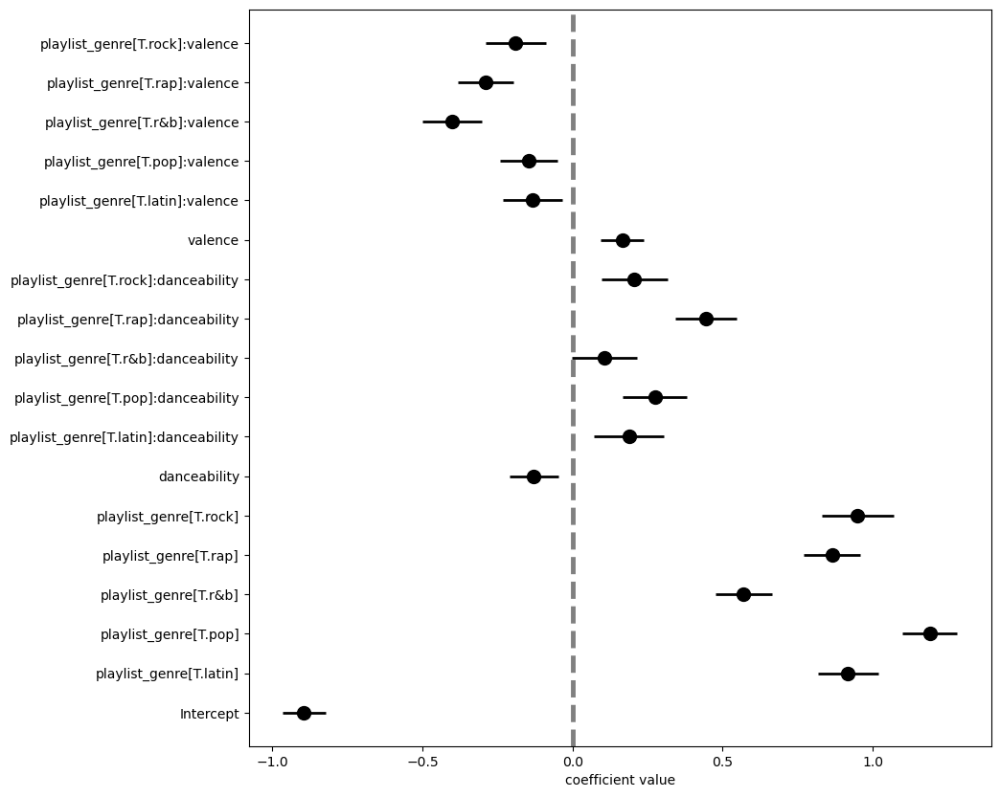

In [435]:
my_coefplot( fit_model )

Let's compare the predicted values with the actual values

In [436]:
df_predicted = df_modelling.copy()
df_predicted ['pred_probability'] = fit_model.predict( df_modelling )
threshold = 0.5
df_predicted ['pred_class'] = np.where( df_predicted.pred_probability > threshold, 1, 0)

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


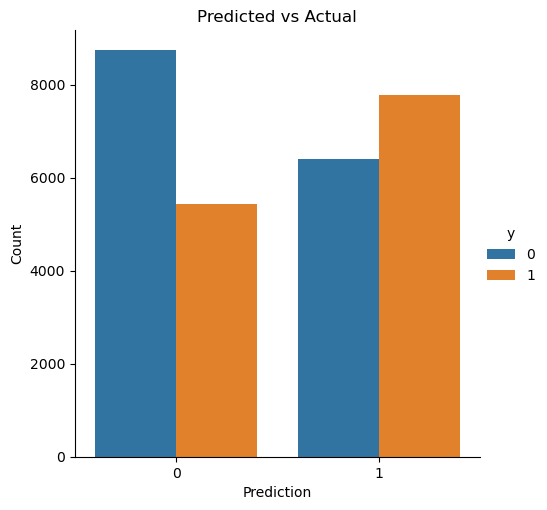

In [437]:
sns.catplot(data=df_predicted, x='pred_class', hue='y', kind='count')
plt.title('Predicted vs Actual')
plt.xlabel('Prediction')
plt.ylabel('Count')
plt.show()

Let's display the confusion matrix for this model

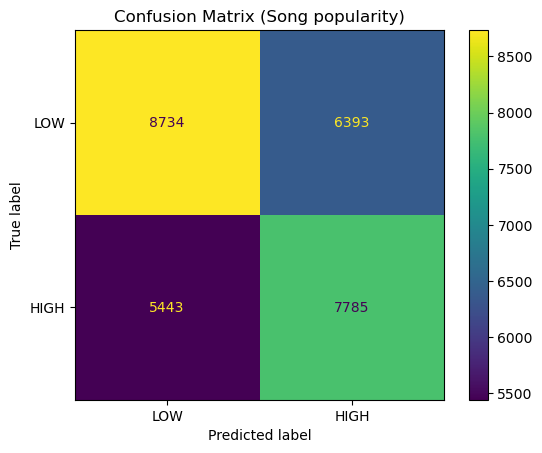

In [438]:
conf_matrix = confusion_matrix(df_predicted.y.to_numpy(), df_predicted.pred_class.to_numpy())
ConfusionMatrixDisplay(conf_matrix, display_labels=['LOW', 'HIGH']).plot()
plt.title('Confusion Matrix (Song popularity)')
plt.grid(False)
plt.show()

Let's use the functions created earlier to see the perfomance values and the ROC curve.

In [439]:
pred = fit_and_assess_logistic(8, formula_list[8-1], train_data=df_modelling, threshold=0.5)
pred

Optimization terminated successfully.
         Current function value: 0.666499
         Iterations 5


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,8,y ~ playlist_genre * (danceability + valence),18,0.5,0.582578,0.588524,0.577378,0.422622,0.620144


In [440]:
ROC = fit_logistic_make_roc(8, formula_list[8-1], train_data=df_modelling)

Optimization terminated successfully.
         Current function value: 0.666499
         Iterations 5


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


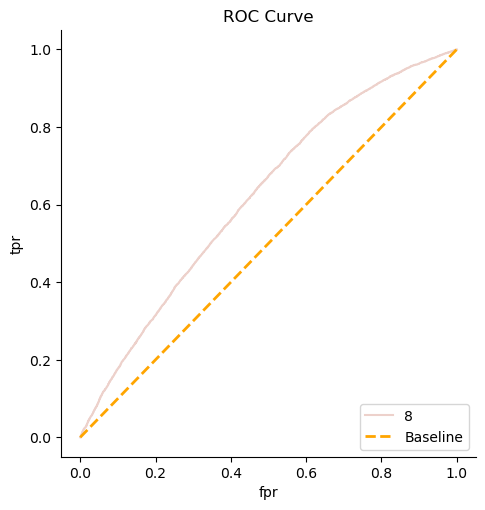

In [441]:
g = sns.relplot(data = ROC, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None)
g._legend.remove()
ax = g.ax
ax.plot([0, 1], [0, 1], color='orange', linestyle='--', linewidth=2, label='Baseline')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, loc='lower right')
ax.set_title('ROC Curve')
plt.show()

Now let's take a look at all the models within one dataframe.

In [442]:
results_list = []

for m in range(len(formula_list)):
    results_list.append( fit_and_assess_logistic(m+1, formula_list[m], train_data= df_modelling, threshold=0.5))

Optimization terminated successfully.
         Current function value: 0.690903
         Iterations 3
Optimization terminated successfully.
         Current function value: 0.669858
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.678538
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.673991
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.683423
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.666499
         Iterations 5


In [443]:
results_df = pd.concat( results_list, ignore_index=True) 
results_df.sort_values(by=['ROC_AUC'], ascending=False)

,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
5,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5,0.605890,0.572498,0.635090,0.364910,0.648190
3,4,y ~ key + mode + playlist_genre + danceability...,24,0.5,0.593476,0.553750,0.628214,0.371786,0.631902
7,8,y ~ playlist_genre * (danceability + valence),18,0.5,0.582578,0.588524,0.577378,0.422622,0.620144
1,2,y ~ key + mode + playlist_genre,18,0.5,0.574467,0.616117,0.538045,0.461955,0.608519
4,5,y ~ (danceability + energy + acousticness + li...,22,0.5,0.567836,0.428561,0.689628,0.310372,0.597698
2,3,y ~ danceability + energy + acousticness + liv...,7,0.5,0.560818,0.389779,0.710385,0.289615,0.586903
6,7,y ~ (key + mode) + (energy + acousticness),15,0.5,0.551649,0.338524,0.738018,0.261982,0.571017
0,1,y ~ 1,1,0.5,0.533486,0.000000,1.000000,0.000000,0.500000


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


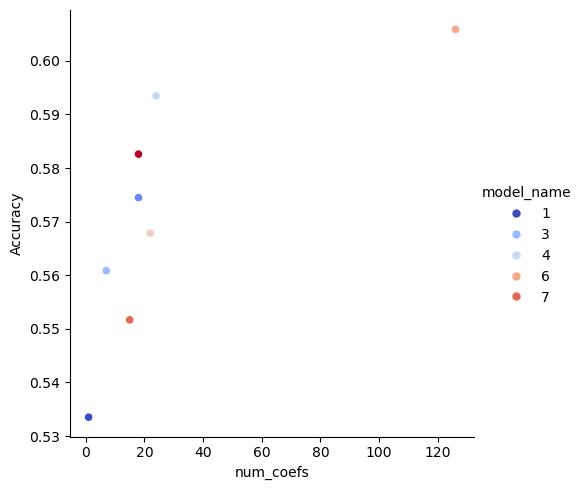

In [444]:
sns.relplot(data = results_df, x='num_coefs', y='Accuracy', hue='model_name', kind='scatter', legend=True, palette='coolwarm')

plt.show()

We can see that model 6 with all the features has the highest accuracy for the training set

In [445]:
roc_list = []

for m in range( len(formula_list)):
    roc_list.append( fit_logistic_make_roc(m+1, formula_list[m], train_data= df_modelling))

Optimization terminated successfully.
         Current function value: 0.690903
         Iterations 3
Optimization terminated successfully.
         Current function value: 0.669858
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.678538
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.673991
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.683423
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.666499
         Iterations 5


In [446]:
roc_df = pd.concat( roc_list, ignore_index=True )

In [447]:
roc_df['model_name'] = roc_df.model_name.astype('category')

In [448]:
roc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83182 entries, 0 to 83181
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   tpr            83182 non-null  float64 
 1   fpr            83182 non-null  float64 
 2   threshold      83182 non-null  float64 
 3   model_name     83182 non-null  category
 4   model_formula  83182 non-null  object  
dtypes: category(1), float64(3), object(1)
memory usage: 2.6+ MB


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


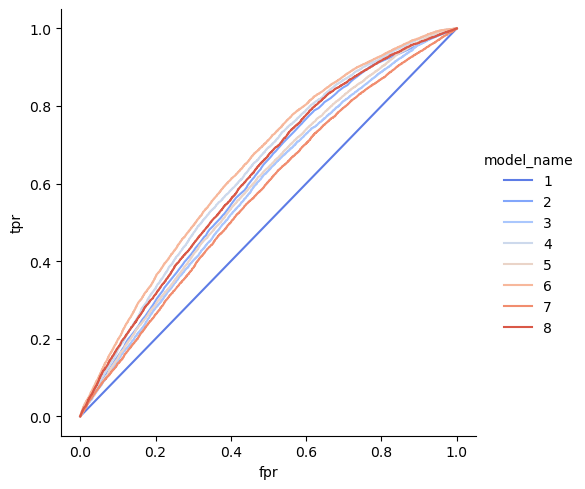

In [449]:
sns.relplot(data = roc_df, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None, units='model_name', palette='coolwarm')

plt.show()

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


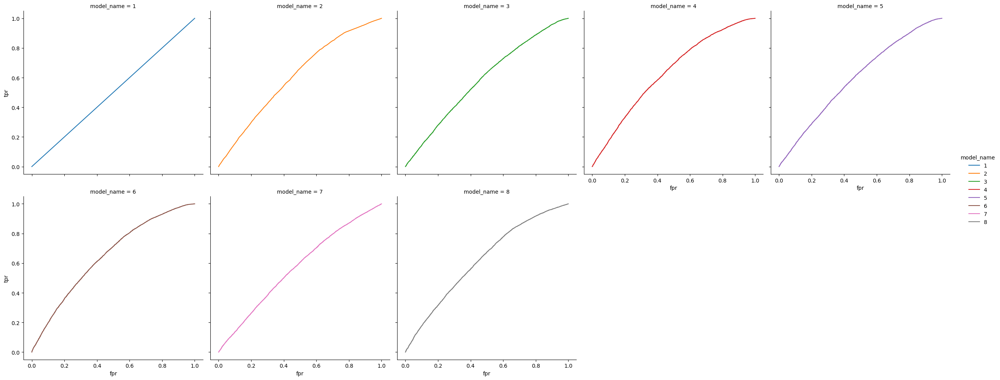

In [450]:
sns.relplot(data = roc_df, x='fpr', y='tpr', hue='model_name', 
            kind='line', estimator=None, units='model_name',
            col='model_name', col_wrap=5)

plt.show()

Oncea again according to the ROC graphs, model 6 appears to have the best performance as it is the furthest away from the baseline or intercept model, which is tpr = fpr line.

## E. Predictions

We will make predictions using 2 models, those being the all inputs model and the model with the best performance, which were model 4 and model 6 respectively. First lets create the input grid for the all inputs model.

### All inputs model

In [451]:
all_inputs_model = smf.logit(formula_list[4-1], data=df_modelling).fit()

Optimization terminated successfully.
         Current function value: 0.661513
         Iterations 5


In [452]:
sorted_series = all_inputs_model.params[all_inputs_model.pvalues < 0.05].abs().sort_values(ascending=False)
all_inputs_model.params[sorted_series.index]

playlist_genre[T.pop]      1.156200
playlist_genre[T.rock]     1.089056
Intercept                 -0.889852
playlist_genre[T.rap]      0.887439
playlist_genre[T.latin]    0.875088
playlist_genre[T.r&b]      0.486549
duration_ms               -0.201505
key[T.8]                   0.160813
acousticness               0.122771
danceability               0.073770
energy                    -0.065805
valence                   -0.030647
dtype: float64

Now lets create the input grid to be used for this model. We can see from the above that `playlist_genre`, `danceability` and, `acousticness` have the largest significance in the model. 

Thus, we will create 101 values with `acousticness` as it is the largest continous variavble with statistical significance. The second largest `danceability` will get 5 unique values and the rest of the continous variables will be from the modelling dataset mean. 

The largest categorical variable `playlist_genre`, will have unique values and the rest of the categorical variables will have the most frequent value.

In [453]:
input_grid_all = pd.DataFrame((playlist_genre, acousticness, danceability, energy, key, mode, liveness, valence, duration_ms) 
                                    for playlist_genre in df_modelling.playlist_genre.unique()
                                    for acousticness in np.linspace(df_modelling.acousticness.min(), df_modelling.acousticness.max(), num=101)
                                    for danceability in np.linspace(df_modelling.danceability.min(), df_modelling.danceability.max(), num=5)
                                    for energy in [df_modelling.energy.mean()]
                                    for key in [df_modelling.key.value_counts().sort_index().index[0]]
                                    for mode in [df_modelling['mode'].value_counts().sort_index().index[0]]
                                    for liveness in [df_modelling.liveness.mean()]
                                    for valence in [df_modelling.valence.mean()]
                                    for duration_ms in [df_modelling.duration_ms.mean()])
input_grid_all.columns=['playlist_genre', 'acousticness', 'danceability', 'energy', 'key', 'mode', 'liveness', 'valence', 'duration_ms']

In [454]:
df_viz_all = df_modelling.copy()
df_viz_all['pred_probability_all'] = all_inputs_model.predict( input_grid_all )

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


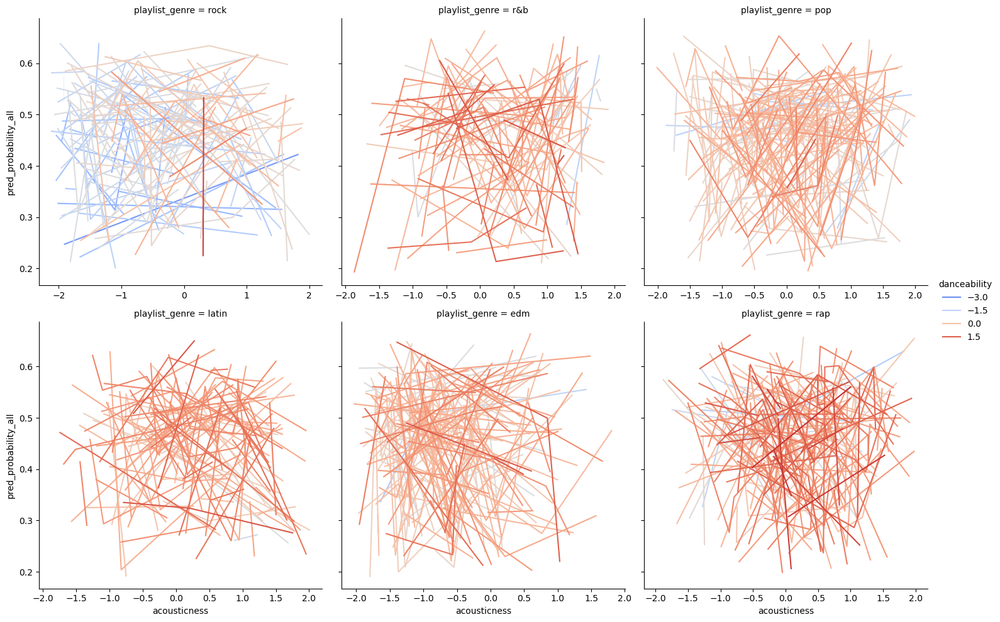

In [455]:
sns.relplot(data = df_viz_all, x = 'acousticness', y='pred_probability_all', hue = 'danceability', col = 'playlist_genre', 
            palette='coolwarm', col_wrap = 3, kind='line', facet_kws={'sharex': False})
plt.show()

This model is very complex as there is a large amount of variability across all genres. There seems to be a lower `danceability` values across rock genres compared to the other genres.

Now let's predict using the best model (based on ROC_AUC score) which was model 6.

### Model with best ROC_AUC

In [456]:
best_model = smf.logit(formula_list[6-1], data=df_modelling).fit()

Optimization terminated successfully.
         Current function value: 0.654158
         Iterations 6


In [457]:
sorted_series = best_model.params[best_model.pvalues < 0.05].abs().sort_values(ascending=False)
best_model.params[sorted_series.index]

playlist_genre[T.pop]                   1.093980
playlist_genre[T.rock]                  0.867280
Intercept                              -0.827634
playlist_genre[T.latin]                 0.751582
playlist_genre[T.rap]                   0.695848
playlist_genre[T.r&b]                   0.416313
playlist_genre[T.rock]:acousticness    -0.365386
playlist_genre[T.rap]:danceability      0.343383
acousticness                            0.318494
playlist_genre[T.rock]:duration_ms      0.293313
key[T.3]:acousticness                  -0.244917
playlist_genre[T.pop]:acousticness     -0.240107
playlist_genre[T.r&b]:valence          -0.239467
playlist_genre[T.latin]:duration_ms     0.236472
key[T.3]:valence                        0.220507
duration_ms                            -0.219633
key[T.3]:danceability                  -0.212341
key[T.11]:duration_ms                  -0.193086
key[T.9]:duration_ms                   -0.180609
playlist_genre[T.pop]:danceability      0.173176
key[T.5]:duration_ms

The most influential variables for this model are `playlist_genre`, `acousticness` and `key`.

Now lets create the input grid to be used for this model. We can see from the above that `playlist_genre`, `key` and, `acousticness` have the largest significance in the model. 

Thus, we will create 101 values with `acousticness` as it is the largest continous variavble with statistical significance.

The largest categorical variables `playlist_genre` and `key`, will have unique values as they are the first and third most significant variables respectively. The rest of the categorical variables will have the most frequent value.

In [458]:
input_grid_best = pd.DataFrame((playlist_genre, acousticness, key, danceability, energy, mode, liveness, valence, duration_ms) 
                                    for playlist_genre in df_modelling.playlist_genre.unique()
                                    for acousticness in np.linspace(df_modelling.acousticness.min(), df_modelling.acousticness.max(), num=101)
                                    for key in df_modelling.key.unique()
                                    for danceability in [df_modelling.danceability.mean()]
                                    for energy in [df_modelling.energy.mean()]
                                    for mode in [df_modelling['mode'].value_counts().sort_index().index[0]]
                                    for liveness in [df_modelling.liveness.mean()]
                                    for valence in [df_modelling.valence.mean()]
                                    for duration_ms in [df_modelling.duration_ms.mean()])
input_grid_best.columns=['playlist_genre', 'acousticness', 'key', 'danceability', 'energy', 'mode', 'liveness', 'valence', 'duration_ms']

In [459]:
df_viz_best = df_modelling.copy()
df_viz_best['pred_probability_best'] = best_model.predict( input_grid_best )

/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


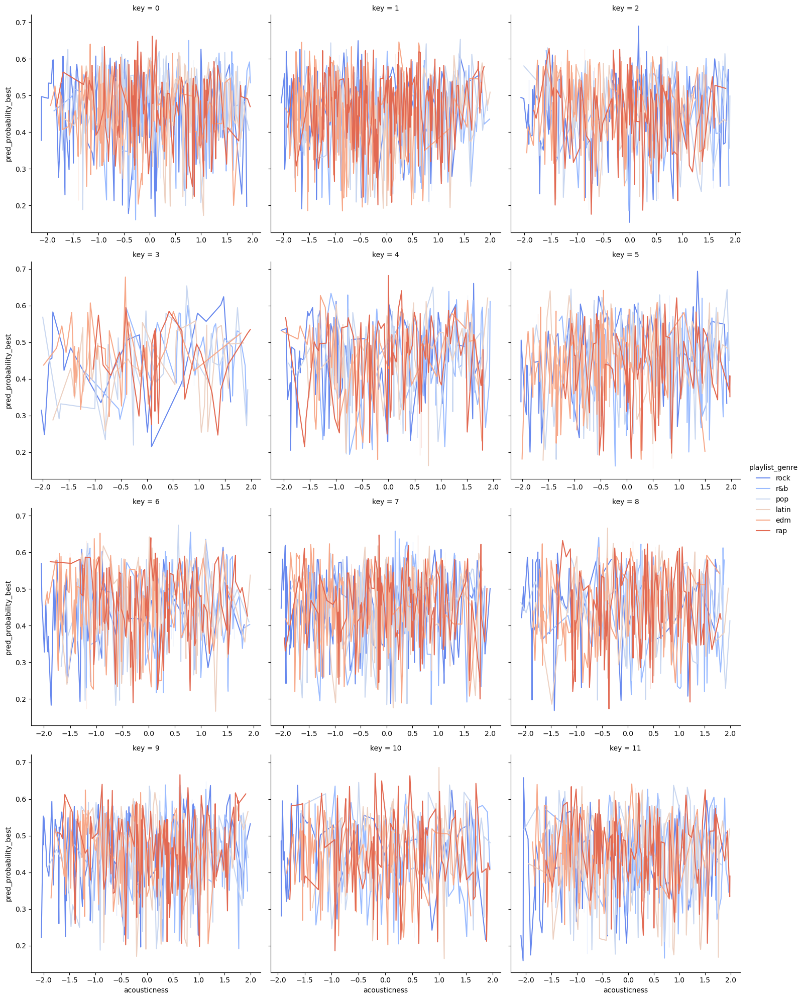

In [460]:
sns.relplot(data = df_viz_best, x = 'acousticness', y='pred_probability_best', hue = 'playlist_genre', col = 'key', 
            palette='coolwarm', col_wrap = 3, kind='line', facet_kws={'sharex': False})
plt.show()

This model is very complex as there is a large amount of variability across all genres and key's. There seems to be a less `acousticness` values in `key = 3` compared to the other key's 

## F. Models: Performance and Validation

First let us set up the k-fold generators

### K-Fold generators

In [461]:
kf = StratifiedKFold( n_splits= 5, shuffle=True, random_state= 101)

In [462]:
kf.get_n_splits()

5

In [463]:
input_names = df_modelling.drop(columns=['y']).copy().columns.to_list()
input_names

['track_id',
 'playlist_genre',
 'danceability',
 'energy',
 'key',
 'mode',
 'acousticness',
 'liveness',
 'valence',
 'duration_ms']

In [464]:
output_name = 'y'

In [465]:
log_std = [ 'danceability',
            'energy',
            'acousticness',
            'liveness',
            'valence',
            'duration_ms']

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


Let's define a Function that manages the Fitting and PERFORMANCE METRIC calculation within the CROSS-Validation FOLDS!

Focus on the ACCURACY as our Performance metric!

In [466]:
def train_and_test_logistic_with_cv(mod_name, a_formula, data_df, x_names, y_name, std_vars, cv, threshold=0.5):
    # seperate the inputs and output 
    input_df = data_df.loc[ :, x_names ].copy()

    # Initialize the performance metric storage lists
    train_res = []
    test_res = [] 

    # SPLIT the data and iterate over the folds 
    for train_id, test_id in cv.split(input_df.to_numpy(), data_df[ y_name].to_numpy()):
        # subset the training and test splits within each fold
        train_data = data_df.iloc[ train_id, :].copy()
        test_data = data_df.iloc[ test_id, :].copy()

        # standardize
        train_data[std_vars] = StandardScaler().fit_transform(train_data[std_vars])
        test_data[std_vars] = StandardScaler().fit_transform(test_data[std_vars])
        
        # Fit the model on the TRAINING data within the current FOLD 
        a_mod = smf.logit( formula=a_formula , data=train_data).fit()

        # Predict the TRAINING within each FOLD
        train_copy = train_data.copy()
        train_copy['pred_probability'] = a_mod.predict( train_data )
        train_copy['pred_class'] = np.where( train_copy.pred_probability > threshold, 1, 0)

        # Predict the TESTING within each fold
        test_copy = test_data.copy()
        test_copy['pred_probability'] = a_mod.predict( test_data )
        test_copy['pred_class'] = np.where( test_copy.pred_probability > threshold, 1, 0)

        # Calculate the PERFORMANCE METRIC on the TRAINNG SET within the FOLD
        train_res.append( np.mean( train_copy[ y_name] == train_copy.pred_class))

        # Calculate the PERFORMANCE METRIC on the TESTING SET within the FOLD
        test_res.append( np.mean( test_copy[ y_name] == test_copy.pred_class))

   # bookeeping to store the results
    train_df = pd.DataFrame({'Accuracy': train_res})
    train_df['from_set'] = 'training'
    train_df['fold_id'] = train_df.index + 1

    test_df = pd.DataFrame({'Accuracy': test_res})
    test_df['from_set'] = 'testing'
    test_df['fold_id'] = test_df.index + 1

    # combine the splits together
    res_df = pd.concat([train_df, test_df], ignore_index=True)

    # add information about the model
    res_df['model_name'] = mod_name
    res_df['model_formula'] = a_formula
    res_df['num_coeffs'] = len(a_mod.params)
    res_df['threshold'] = threshold

    return res_df

We will cross-validate across 3 models. One will be the model with the highest ROC_AUC, model 6. One will be one of the models chosen, which is model 8 for simplicity. The third one will be a model with more features, which will be model 4.

In [467]:
cv_res_mod_6 = train_and_test_logistic_with_cv(6, formula_list[6-1], data_df=df_modelling, x_names= input_names, y_name= output_name, std_vars=log_std, cv=kf)

cv_res_mod_8 = train_and_test_logistic_with_cv(8, formula_list[8-1], data_df=df_modelling, x_names= input_names, y_name= output_name, std_vars=log_std, cv=kf)

cv_res_mod_4 = train_and_test_logistic_with_cv(4, formula_list[4-1], data_df=df_modelling, x_names= input_names, y_name= output_name, std_vars=log_std, cv=kf)

Optimization terminated successfully.
         Current function value: 0.652897
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.654470
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.653409
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.652852
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.654316
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.665954
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.666552
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.666776
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.666128
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.666637
  

In [468]:
cv_res_mod_6

,Accuracy,from_set,fold_id,model_name,model_formula,num_coeffs,threshold
0,0.607433,training,1,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
1,0.602583,training,2,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
2,0.606771,training,3,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
3,0.606859,training,4,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
4,0.605890,training,5,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
5,0.592664,testing,1,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
6,0.611356,testing,2,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
7,0.588785,testing,3,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
8,0.591077,testing,4,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
9,0.600600,testing,5,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5


In [469]:
cv_res_mod_4

,Accuracy,from_set,fold_id,model_name,model_formula,num_coeffs,threshold
0,0.595177,training,1,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
1,0.591254,training,2,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
2,0.596147,training,3,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
3,0.594560,training,4,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
4,0.593899,training,5,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
5,0.581026,testing,1,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
6,0.599013,testing,2,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
7,0.584906,testing,3,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
8,0.589843,testing,4,4,y ~ key + mode + playlist_genre + danceability...,24,0.5
9,0.597955,testing,5,4,y ~ key + mode + playlist_genre + danceability...,24,0.5


In [470]:
cv_res_mod_8

,Accuracy,from_set,fold_id,model_name,model_formula,num_coeffs,threshold
0,0.581599,training,1,8,y ~ playlist_genre * (danceability + valence),18,0.5
1,0.581511,training,2,8,y ~ playlist_genre * (danceability + valence),18,0.5
2,0.583848,training,3,8,y ~ playlist_genre * (danceability + valence),18,0.5
3,0.581820,training,4,8,y ~ playlist_genre * (danceability + valence),18,0.5
4,0.582834,training,5,8,y ~ playlist_genre * (danceability + valence),18,0.5
5,0.579968,testing,1,8,y ~ playlist_genre * (danceability + valence),18,0.5
6,0.585964,testing,2,8,y ~ playlist_genre * (danceability + valence),18,0.5
7,0.573797,testing,3,8,y ~ playlist_genre * (danceability + valence),18,0.5
8,0.580321,testing,4,8,y ~ playlist_genre * (danceability + valence),18,0.5
9,0.575560,testing,5,8,y ~ playlist_genre * (danceability + valence),18,0.5


In [471]:
res_list = []
res_list.append(cv_res_mod_6)
res_list.append(cv_res_mod_8)
res_list.append(cv_res_mod_4)

In [472]:
cv_results = pd.concat(res_list, ignore_index=True) 

In [473]:
cv_results

,Accuracy,from_set,fold_id,model_name,model_formula,num_coeffs,threshold
0,0.607433,training,1,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
1,0.602583,training,2,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
2,0.606771,training,3,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
3,0.606859,training,4,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
4,0.605890,training,5,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
5,0.592664,testing,1,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
6,0.611356,testing,2,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
7,0.588785,testing,3,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
8,0.591077,testing,4,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5
9,0.600600,testing,5,6,y ~ (key + mode + playlist_genre)*(danceabilit...,126,0.5


/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


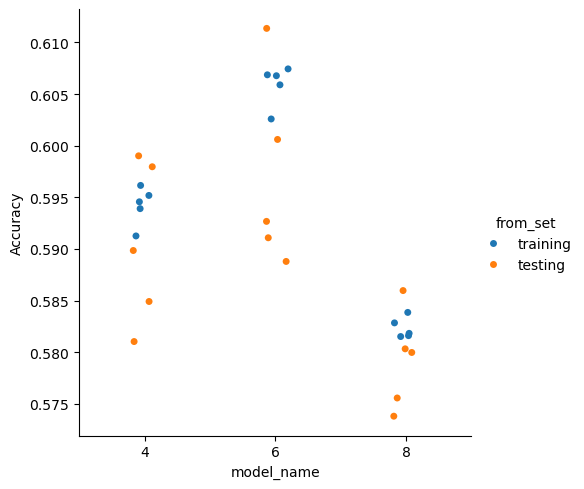

In [474]:
sns.catplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set')

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/396052923.py:3: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/396052923.py:6: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],


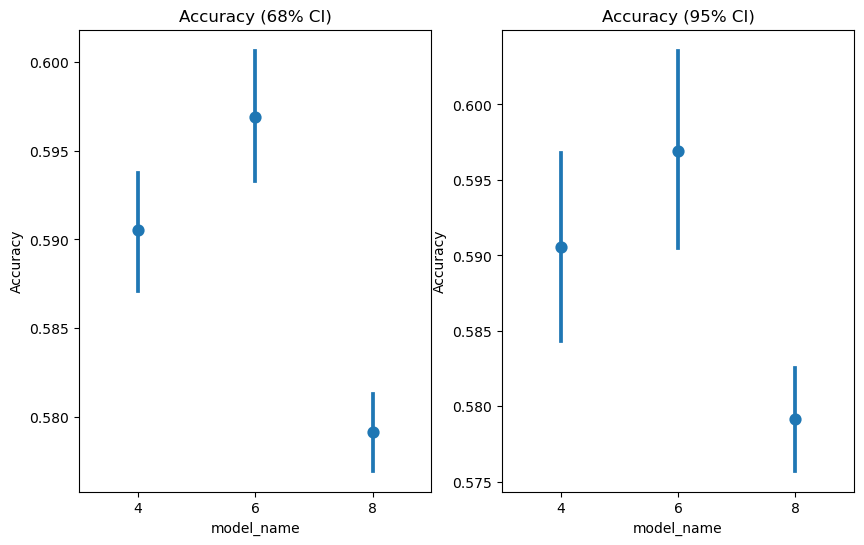

In [475]:
fig, ax = plt.subplots(1, 2, figsize=(10,6))

sns.pointplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
            x='model_name', y='Accuracy', join=False,
            errorbar=('ci', 68), ax=ax[0])
sns.pointplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
            x='model_name', y='Accuracy', join=False,
            errorbar=('ci', 95), ax=ax[1])

ax[0].set_title('Accuracy (68% CI)')
ax[1].set_title('Accuracy (95% CI)')

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/1355329558.py:4: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set', join=False, ax=ax)


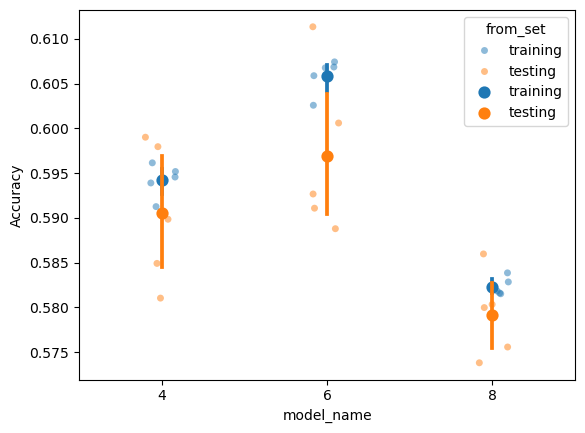

In [476]:
fig, ax = plt.subplots()

sns.stripplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set', alpha=0.5, ax=ax)
sns.pointplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set', join=False, ax=ax)

plt.show()

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/3054396630.py:1: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.catplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set', kind='point', join=False)
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


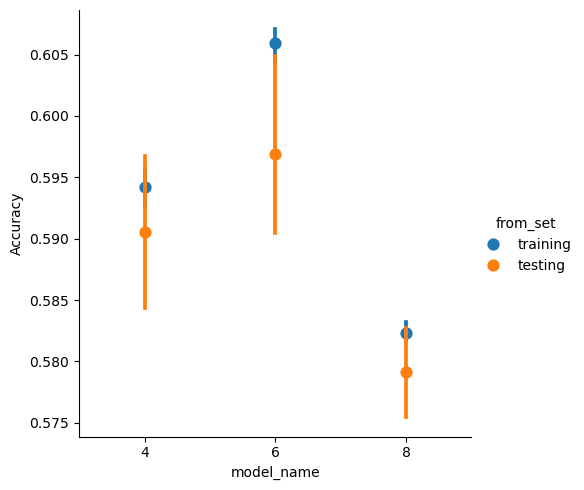

In [477]:
sns.catplot(data = cv_results, x='model_name', y='Accuracy', hue='from_set', kind='point', join=False)

plt.show()

We can see that, although model 6 has the highest accuracy, it seems to be overfit as the training data has a much higher accuracy value than the testing data. Model 8 however has training and testing data closer in accuracy to each other than the other 2 models along with smaller confidence intervals, thus would best model according to cross validation. 

This model is different than the best model identified according to the training set which was model 6.

Let's see how many coeffiecients it has.

/var/folders/2c/j0kw_j7147b6qk3gzzl6cb100000gn/T/ipykernel_42363/954502244.py:1: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.catplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
/opt/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


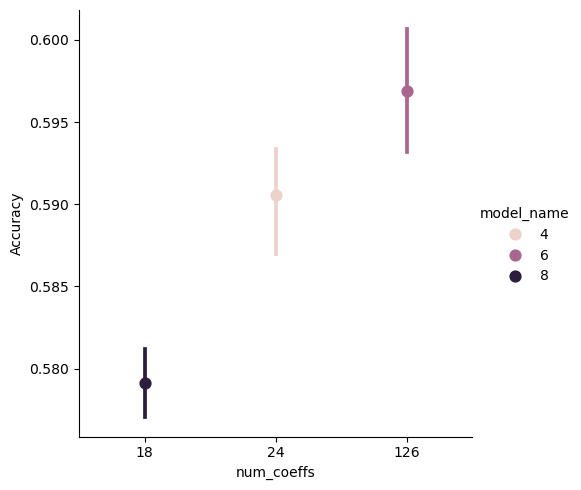

In [478]:
sns.catplot(data = cv_results.loc[ cv_results.from_set == 'testing', :], 
            x='num_coeffs', y='Accuracy', join=False, kind='point',
            hue='model_name',
            errorbar=('ci', 68))

plt.show()

Thus model 8 has 18 coefficients compared to 126 coefficients in model 6.